In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sys import exit
import pandas as pd
import glob
import pickle
from textwrap import wrap
import time
import math
import scipy
import itertools
from scipy import signal## because scipy doesn't always load its submodules for some reason
from scipy import stats
from sklearn.metrics.cluster import adjusted_rand_score
from copy import deepcopy
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score, pairwise_distances
from scipy.optimize import fsolve
import scipy.optimize
from scipy.stats import levy_stable
import sys
sys.path.append('/Users/ashish/Dropbox/research/James-research/city establishment data/')

import powerlaw
import shared_analysis_functions as shared_func
import importlib
importlib.reload(shared_func)
from sklearn.metrics import pairwise_distances
from scipy.spatial import distance as scipy_spatial_distance

import warnings
fit_params_path='/Users/ashish/Box/research/James/BLS data/processed_BLS_data/fit_parameters/'
# 
fontSize=12
fontSizeSmall=10
labelSize=8
sns.set(rc= {'figure.facecolor':'white'}) #'axes.facecolor':'cornflowerblue',

def create_color_list(scheme_name='sns_tab10',num_colors=6): 
    #https://matplotlib.org/3.1.0/gallery/color/named_colors.html
    #https://seaborn.pydata.org/tutorial/color_palettes.html
    if scheme_name.lower()=='tableau':
        color_list=list(mcolors.TABLEAU_COLORS.values())## only had 10 colors
    elif scheme_name.lower()=='css':
        color_list=list(mcolors.CSS4_COLORS.values())
    elif scheme_name.lower()=='base':
        color_list=list(mcolors.BASE_COLORS.values())
    elif scheme_name.lower()=='sns_tab10':
        color_list=list(sns.color_palette(palette='tab10',n_colors=num_colors))
    elif scheme_name.lower()=='sns_deep':
        color_list=list(sns.color_palette(palette='deep',n_colors=num_colors))
    elif scheme_name.lower()=='sns_muted':
        color_list=list(sns.color_palette(palette='muted',n_colors=num_colors))
    elif scheme_name.lower()=='sns_colorblind':
        color_list=list(sns.color_palette(palette='colorblind',n_colors=num_colors))
    elif scheme_name.lower()=='sns_spectral':
        color_list=list(sns.color_palette(palette='Spectral',n_colors=num_colors))
    else:
        print ('scheme not implemented')
    if 'sns' not in scheme_name.lower():
        color_list=[color for color in color_list if sum(mcolors.to_rgb(color))<2.5] ## remove white
        mcolors.to_rgb(color_list[0])
    return  color_list
color_list_def=create_color_list()


def compute_pairwise_distances(X, distance_metric):
    dist_bw_pwise=False ## compute distance again assuming pairwise distances are features. 
    if 'dist_bw_pwise_' in distance_metric:
        dist_bw_pwise=True
        distance_metric=distance_metric.replace('dist_bw_pwise_','')
    
    if distance_metric is 'jensenshannon':
        temp_Distances = scipy_spatial_distance.pdist(
            X, metric=distance_metric)
        Distances = scipy_spatial_distance.squareform(temp_Distances)
    else:
        Distances = pairwise_distances(X, metric=distance_metric)
        
    if dist_bw_pwise:
        Distance2=compute_pairwise_distances(Distances, distance_metric)
        return Distance2
    else:
        return Distances
    
##identify naics codes
def naics_at_fixed_resolution(full_naics_list, naics_resolution=2,drop_list=[]):
    '''returns naics codes at the required resolution'''
    new_naics_list = []
    for naics in list(full_naics_list):
        new_naics = naics.replace('-', '').replace('/', '')
        if len(new_naics) == naics_resolution:
            new_naics_list.append(new_naics)
    unq_naics_list = list(np.sort(list(set(new_naics_list))))   
    for code in drop_list:
        unq_naics_list.remove(code)
    unq_naics_fullcodes_list=[]
    for naics in unq_naics_list:
        if len(naics)<=2:
            naics_fullcode='{:-<6}'.format(naics)
        else:
            naics_fullcode='{:/<6}'.format(naics)
        unq_naics_fullcodes_list.append(naics_fullcode)
        
    tot_and_unqnaics_fullcodes=['{:-<6}'.format('')]
    tot_and_unqnaics_fullcodes.extend(unq_naics_fullcodes_list)      
    naics_keys=['naics_'+naics for naics in unq_naics_list]
    return unq_naics_list, unq_naics_fullcodes_list, tot_and_unqnaics_fullcodes,naics_keys

def naics_from_sector(sector_name, df_naics_ref, full_naics_list, naics_resolution=2):
    if 'total' in sector_name or 'summed' in sector_name:
        return sector_name
    unq_naics_list,_, _,_=naics_at_fixed_resolution(full_naics_list,
                                                    naics_resolution=naics_resolution)
        
    for naics in unq_naics_list:
        name_naics=sector_from_naics(df_naics_ref, naics, shorten=False)
        if sector_name.lower() in name_naics.lower():
            print (sector_name,' is in: ',name_naics)
            return 'naics_'+naics
    
    return None
        
###
def get_gamma_dist_params_constrained(df_metro_time,
                    naics_keys_to_plot, time_stamps,shape_fixed=None, scale_fixed=None):     
    #'''MLE fits and returns gamma parameters shape, k, and scale theta. param fixed as chosen '''
    
    df_new=deepcopy(df_metro_time)
    msas = df_new['msa'].values
    n_msas = len(msas)

    for nidx,naics in enumerate(naics_keys_to_plot): 
        df_new[naics+'-fit_shape_k']=0
        df_new[naics+'-fit_scale_theta']=0
        df_new[naics+'-fit_AIC']=0

    for msa_idx,msa in enumerate(msas):
        for nidx,naics in enumerate(naics_keys_to_plot):                
    #             naics_name=sector_from_naics(df_naics_ref, naics, shorten=True)        
            df_sub=df_new[df_new['msa']==msa]
            naics_time_keys=[naics+'-Y'+ t for t in time_stamps]
            imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps]
            if np.all(df_sub[imputed_keys_time].values==False):
                emp_time=df_sub[naics_time_keys].values
                
                if shape_fixed is None and scale_fixed is None:
                    a_gamma,dummy_loc_gamma, scale_gamma=scipy.stats.gamma.fit(
                            np.ravel(emp_time), 1.,floc=0.,scale=np.var(emp_time) )
                    n_params=2
                elif scale_fixed is None:
                    a_gamma,dummy_loc_gamma, scale_gamma=scipy.stats.gamma.fit(
                            np.ravel(emp_time), fa=shape_fixed[nidx],floc=0.,scale=np.var(emp_time) )
                    n_params=1
                elif shape_fixed is None:
                    a_gamma,dummy_loc_gamma, scale_gamma=scipy.stats.gamma.fit(
                            np.ravel(emp_time), 1. ,floc=0.,fscale=scale_fixed[nidx] )    
                    n_params=1
                else:
                    print ('both params cannot be held fixed')
                    sys.exit(1)
                logLik = np.sum( stats.gamma.logpdf(emp_time,a_gamma, loc=dummy_loc_gamma,scale= scale_gamma ) ) 
                AIC=2*n_params-2*logLik
                if msa_idx==0 and nidx==0: print ('nparams=', n_params)
                df_new.loc[msa_idx, naics+'-fit_shape_k']=a_gamma
                df_new.loc[msa_idx, naics+'-fit_scale_theta']=scale_gamma
                df_new.loc[msa_idx, naics+'-fit_AIC']=AIC
    
    return df_new





'''
figure size and font settings
'''   
## figure settings
SMALL_SIZE = 10
MEDIUM_SIZE = 12
BIGGER_SIZE = 14

# plt.rc('font', size=SMALL_SIZE, family='sans-serif', serif='Arial')          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE, titleweight='bold')     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE, labelweight='bold')    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
plt.rc('text')

from matplotlib.ticker import MaxNLocator
my_locator = MaxNLocator(6)

# def figure_size_setting(WIDTH):
#     #WIDTH = 700.0  # the number latex spits out
#     FACTOR = 0.8  # the fraction of the width you'd like the figure to occupy
#     fig_width_pt  = WIDTH * FACTOR
#     inches_per_pt = 1.0 / 72.27
#     golden_ratio  = (np.sqrt(5) - 1.0) / 2.0  # because it looks good
#     fig_width_in  = fig_width_pt * inches_per_pt  # figure width in inches
#     fig_height_in = fig_width_in * golden_ratio   # figure height in inches
#     fig_dims    = [fig_width_in, fig_height_in] # fig dims as a list
#     return fig_dims

# time_stamp_arr=[]
# time_arr=[]
# t=0
# for y in np.arange(1990,2022):
#     for q in np.arange(1,5):
#         for m in np.arange(1,4):
#             time_stamp_arr.append('Y'+str(y)[-2:]+'-Q'+str(q)+'-M'+str(m))
#             time_arr.append(t)
#             t+=1
# time_stamp_arr=np.array(time_stamp_arr)
# time_arr=np.array(time_arr)



In /Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In /Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /User

# read and retabulate raw data

## create county files of sectoral employment
in coarse grained sectors

In [49]:
BLS_data_path='/Users/ashish/Downloads/BLS data/BLS_NAICS_county files/'
BLS_processed_path='/Users/ashish/Box/research/James/BLS data/processed_BLS_data/'

# years_list=['2005','2006','2007']
years_list =[k for k in np.arange(2003,2020).astype(int).astype(str)]
for year in years_list:
    file_name=year+'.q1-q4.singlefile.csv'
    chunksize = 1000000 #2000 #1000000
    cols_to_keep=['area_fips','own_code', 'industry_code','size_code','agglvl_code',
                  'qtr','disclosure_code', 
                 'qtrly_estabs','month1_emplvl', 'month2_emplvl', 'month3_emplvl',
                 'total_qtrly_wages', ]
    ctr=0
    df_temp = pd.DataFrame(columns=cols_to_keep)
    for chunk in pd.read_csv(BLS_data_path+file_name,encoding='ISO-8859–1', dtype=str, 
                             chunksize=chunksize, 
                             iterator=True):

        chunk_sub=chunk[chunk.agglvl_code.isin(['71','74'])]#,'75'
        
        
#         chunk_sub=chunk_sub[chunk_sub.own_code=='5'] ## only private establishments.  
        if len(chunk_sub)>0:
            df_temp = pd.concat([df_temp,chunk_sub[cols_to_keep]], ignore_index=True)

    df_temp.to_csv(BLS_processed_path+'df_county_'+year+'.csv')       
        



In [3]:
df_temp

,area_fips,own_code,industry_code,size_code,agglvl_code,qtr,disclosure_code,qtrly_estabs,month1_emplvl,month2_emplvl,month3_emplvl,total_qtrly_wages
0,01001,1,10,0,71,1,NaN,13,89,90,91,965605
1,01001,1,10,0,71,2,NaN,14,90,92,99,1178558
2,01001,1,10,0,71,3,NaN,14,91,86,89,946510
3,01001,1,10,0,71,4,NaN,14,91,88,81,1190186
4,01001,1,48-49,0,74,1,NaN,6,73,72,72,766897
...,...,...,...,...,...,...,...,...,...,...,...,...
458083,78030,5,72,0,74,4,NaN,156,3524,3619,3808,21078346
458084,78030,5,81,0,74,1,N,169,0,0,0,0
458085,78030,5,81,0,74,2,N,173,0,0,0,0
458086,78030,5,81,0,74,3,N,177,0,0,0,0


In [25]:
np.unique(df_temp['industry_code'].values)

array(['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51',
       '52', '53', '54', '55', '56', '61', '62', '71', '72', '81', '92',
       '99'], dtype=object)

In [11]:
df_temp[(df_temp['own_code']=='1')& (df_temp['industry_code']=='10')]

,area_fips,own_code,industry_code,size_code,agglvl_code,qtr,disclosure_code,qtrly_estabs,month1_emplvl,month2_emplvl,month3_emplvl,total_qtrly_wages
0,01001,1,10,0,71,1,NaN,13,89,90,91,965605
1,01001,1,10,0,71,2,NaN,14,90,92,99,1178558
2,01001,1,10,0,71,3,NaN,14,91,86,89,946510
3,01001,1,10,0,71,4,NaN,14,91,88,81,1190186
156,01003,1,10,0,71,1,NaN,36,301,303,313,3501933
...,...,...,...,...,...,...,...,...,...,...,...,...
457871,78020,1,10,0,71,4,NaN,6,80,78,78,1221184
457960,78030,1,10,0,71,1,NaN,31,550,539,520,8687938
457961,78030,1,10,0,71,2,NaN,31,547,553,549,9665063
457962,78030,1,10,0,71,3,NaN,32,547,557,544,8386936


In [10]:
df_temp[(df_temp['own_code']=='5')& (df_temp['industry_code']=='10')]

,area_fips,own_code,industry_code,size_code,agglvl_code,qtr,disclosure_code,qtrly_estabs,month1_emplvl,month2_emplvl,month3_emplvl,total_qtrly_wages
76,01001,5,10,0,71,1,NaN,803,8679,8660,8784,66100615
77,01001,5,10,0,71,2,NaN,812,8834,8870,9049,63318872
78,01001,5,10,0,71,3,NaN,823,9195,9104,9021,66029631
79,01001,5,10,0,71,4,NaN,840,9104,9004,9012,67579446
232,01003,5,10,0,71,1,NaN,5074,51564,51869,53301,373240480
...,...,...,...,...,...,...,...,...,...,...,...,...
457891,78020,5,10,0,71,4,N,280,0,0,0,0
458012,78030,5,10,0,71,1,NaN,1724,16410,16519,16567,124728546
458013,78030,5,10,0,71,2,NaN,1773,16510,16498,16478,121990766
458014,78030,5,10,0,71,3,NaN,1807,16295,16242,16233,118439429


### notes


```
we had 405488 rows if all ownerships were kept at county level in 2006
we had 254352 rows if only private ownership was measured.


The ownership keys to distingush different cases:
5	Private
4	International Government
3	Local Government
2	State Government
1	Federal Government
8	Total Government
9	Total U.I. Covered (Excludes Federal Government) -- but 9 is not usually reported!
```

The naics codes for sectors are :

array(['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51',
       '52', '53', '54', '55', '56', '61', '62', '71', '72', '81', '92',
       '99'], dtype=object)

there is no naics 31-33, only 3 digit codes are available for it..
similarly 44 -45 only has 3 digit codes available for it
49-49 has only 3 digit codes available

we also have naics 92 which is public administration.

## make msa temporal df from county files

-for now we will keep only privately owned establishments. otherwise we need to manually sum up federal, local and state owned sectoral employment.

In [37]:
## df_msa_base is from CBP data.
df_msa_base = pd.read_csv('/Users/ashish/Box/research/James/CBP employment data/processed_data/df_msa_base.csv', 
                          index_col=0,converters={'FIPS':eval}) ## to read fips code list as a list and not as a string

df_metro_base=df_msa_base[df_msa_base['Metro']].copy()

naics_codes=['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51',
       '52', '53', '54', '55', '56', '61', '62', '71', '72', '81', '92','99']
tot_and_naics_codes=['10']+naics_codes
tot_and_naics_colnames=['naics_'+i for i in tot_and_naics_codes]
# temp=['total']
# temp.extend(naics_colnames)
# monthwise_colnames_actually.
yrwise_colnames=tot_and_naics_colnames+[i+'_flag' for i in tot_and_naics_colnames ]
main_colnames=['msa', 'msa_name','FIPS']
qtrwise_est_colnames=['naics_'+i+'_Nest_' for i in tot_and_naics_codes]+ ['naics_'+i+'_wages_' for i in tot_and_naics_codes]




Trying different way of subsetting to speed the array making up.

In [38]:
BLS_processed_path='/Users/ashish/Box/research/James/BLS data/processed_BLS_data/'
# years =[k.zfill(2) for k in np.arange(15,19).astype(int).astype(str)]
# [k.zfill(2) for k in np.arange(2,18).astype(int).astype(str)]#['12']

years=[k for k in np.arange(2003,2020).astype(int).astype(str)]#['2005','2006','2007']
# years=['2005','2006','2007']
qtrs=['1','2','3','4']
months=['1','2','3']
metro_list = list(np.sort(list(set(df_metro_base["msa"].values))))

start_time = time.time()
msa_ctr=0
dict_msa = {}
yrwise_colnames_with_timestamp=[]
qtrwise_colnames_with_qtrstamp=[]
time_stamps_list=[]
# col_names=main_colnames
for year in years:  
    #####create empty dictionary with column names that we will append to    
    for qtr in qtrs:
        qtr_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)
        qtrwise_colnames_with_qtrstamp.extend([k+qtr_stamp for k in qtrwise_est_colnames])
        for month in months:  
            time_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)+'-M'+str(month)
            yrwise_colnames_with_timestamp.extend([k+time_stamp for k in yrwise_colnames] )  
            time_stamps_list.append(time_stamp)
col_names=main_colnames +  yrwise_colnames_with_timestamp +qtrwise_colnames_with_qtrstamp
    
for col_name in col_names:
    dict_msa.update({col_name:[]}) 
        
############# code for some debugging #############
## target_cities=['New York','Boston','Punta Gorda', 'Duluth']
## metro_list_temp=[]
## for target_city in target_cities:
##     df_msa1_base= df_metro_base[df_metro_base['msa_name'].str.contains(target_city)]
##     metro_list_temp.append(df_msa1_base['msa'].values[0])     
## metro_list=metro_list_temp
####################################################


for msa in metro_list:        
    msa_ctr+=1
    fips_in_msa = df_metro_base[df_metro_base['msa']==msa]['FIPS'].values[0] 
    dict_msa['msa'].append(msa)
    metro_name=df_metro_base[df_metro_base['msa']==msa]['msa_name'].values[0]
    dict_msa['msa_name'].append(metro_name)
    dict_msa['FIPS'].append(fips_in_msa)
        
    
for year in years:  
    msa_ctr=0   
#     print( year)
    #.##read the file that we will take the data from 
    df_counties=pd.read_csv(BLS_processed_path+'df_county_'+year+'.csv',dtype=str)
    for msa in metro_list:        
        msa_ctr+=1
#         print(msa_ctr)
#         if msa_ctr>10:
#             break
        fips_in_msa = df_metro_base[df_metro_base['msa']==msa]['FIPS'].values[0] 
        df_counties_in_msa=df_counties[df_counties['area_fips'].isin(fips_in_msa) ]
        #### this subsetting makes things faster downstream.
        for qtr in qtrs:
                qtr_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)
                Nest_key='qtrly_estabs'    
                wage_key='total_qtrly_wages'
                for month in months: 
                    emp_key='month'+month+'_emplvl'
                    time_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)+'-M'+str(month)
                    naics_emp = []
                    naics_emp_NF = []
                    Nests_list= [] ## used only if month=1
                    wages_list= [] ## used only if month=1
                    n_naics=len(tot_and_naics_codes)
                    n_counties=len(fips_in_msa)                   
                    for fips in fips_in_msa:
                    ##now need to sum up all counties for this particular time point.
                        df_county=df_counties_in_msa[df_counties_in_msa['area_fips']==fips ]
                        for naics_code in tot_and_naics_codes:
                            df_sub=df_county[ (
                                df_county['industry_code'] == naics_code)& (
                                df_county['qtr'] == qtr)] #[emp_key,'disclosure_code']   
                            ## for only private ownership!
                            df_sub_pvt=df_sub[df_sub['own_code'] == '5']                        
                            if not df_sub_pvt.empty:
                                assert len(df_sub_pvt)==1, print(len(df_sub_pvt),df_sub_pvt)                            
                                if pd.isna(df_sub_pvt['disclosure_code'].values):                          
                                    naics_emp_NF.append('Y')
                                else:
#                                     assert df_sub_pvt[emp_key].values=='0', df_sub_pvt[emp_key]
                                    naics_emp_NF.append('N')
                                naics_emp.append(int(df_sub_pvt[emp_key]))
                                if month=='1': ## we save establishments for the quarter.
                                    Nests_list.append(int(df_sub_pvt[Nest_key])) 
                                    wages_list.append(int(df_sub_pvt[wage_key])) 
                            else:
                                naics_emp_NF.append('N')
                                naics_emp.append(0) 
                                if month=='1': ## we save establishments for the quarter.
                                    Nests_list.append(0)   
                                    wages_list.append(0)            
                    temp_emp=np.array(naics_emp).reshape(n_counties,n_naics)
                    msa_naics_emp=np.sum(temp_emp,axis=0).T
                    msa_naics_emp_NF=np.array(naics_emp_NF).reshape(n_counties,n_naics).T
                    if month=='1':
                        temp=np.array(Nests_list).reshape(n_counties,n_naics)
                        Nests=np.sum(temp,axis=0).T
                        temp=np.array(wages_list).reshape(n_counties,n_naics)
                        Wages=np.sum(temp,axis=0).T
                        
                    for i,naics_code in enumerate(tot_and_naics_codes):     
                        key1='naics_'+naics_code+time_stamp
                        key2='naics_'+naics_code+'_flag'+time_stamp
                        dict_msa[key1].append(msa_naics_emp[i])
                        dict_msa[key2].append(msa_naics_emp_NF[i])                      
                        if month=='1':
                            key3='naics_'+naics_code+'_Nest_'+qtr_stamp
                            dict_msa[key3].append(Nests[i])
                            key4='naics_'+naics_code+'_wages_'+qtr_stamp
                            dict_msa[key4].append(Wages[i])
df_metro_time = pd.DataFrame.from_dict(dict_msa)
df_metro_time.to_csv(BLS_processed_path+'df_metro_time_pvt_temp2.csv')

end_time = time.time()
print('time for block', end_time-start_time,'secs')           


##### adding imputation column as well..
def make_imputation_column(df_metro_time,naics_keys_list,time_stamps):
    df_metro_time_imputed=df_metro_time.copy()
    for time_stamp in time_stamps:
        naics_yr = [naics+time_stamp for naics in naics_keys_list]
        emp_naics = np.ravel(df_metro_time_imputed[naics_yr].values)
        imputedflag_keys=[naics+'_imputed'+time_stamp for naics in naics_keys_list]  
        not_suppressed_idx=[]
        empflag_keys=[naics+'_flag'+time_stamp for naics in naics_keys_list]
        
        for empflag_key,imputedflag_key in zip(empflag_keys,imputedflag_keys):
                empflag_naics=df_metro_time_imputed[empflag_key].values
                imputed_flag_naics=np.zeros(len(empflag_naics), dtype=bool)
                for idx,val in enumerate(empflag_naics):
                    if 'N' in val:
                        imputed_flag_naics[idx]=True                  
                df_metro_time_imputed[imputedflag_key] =  imputed_flag_naics 
    return df_metro_time_imputed
df_metro_time2=make_imputation_column(df_metro_time,tot_and_naics_keys,time_stamps_list)
df_metro_time2.to_csv(BLS_processed_path+'df_metro_time_pvt_Nests.csv')
            
            

time for block 5212.723818063736 secs


In [36]:
df_metro_time2['naics_21_Nest_-Y05-Q1'].values

array([128,  52,   5,   3,  25,  36,   9,  22,   6,  79])

In [44]:
def make_imputation_column(df_metro_time,naics_keys_list,time_stamps):
    df_metro_time_imputed=df_metro_time.copy()
    for time_stamp in time_stamps:
        naics_yr = [naics+time_stamp for naics in naics_keys_list]
        emp_naics = np.ravel(df_metro_time_imputed[naics_yr].values)
        imputedflag_keys=[naics+'_imputed'+time_stamp for naics in naics_keys_list]  
        not_suppressed_idx=[]
        empflag_keys=[naics+'_flag'+time_stamp for naics in naics_keys_list]
        
        for empflag_key,imputedflag_key in zip(empflag_keys,imputedflag_keys):
                empflag_naics=df_metro_time_imputed[empflag_key].values
                imputed_flag_naics=np.zeros(len(empflag_naics), dtype=bool)
                for idx,val in enumerate(empflag_naics):
                    if 'N' in val:
                        imputed_flag_naics[idx]=True                  
                df_metro_time_imputed[imputedflag_key] =  imputed_flag_naics 
    return df_metro_time_imputed
df_metro_time2=make_imputation_column(df_metro_time,tot_and_naics_keys,time_stamps_list)
df_metro_time2.to_csv(BLS_processed_path+'df_metro_time_pvt.csv')

In [57]:
df_metro_time .head()

,msa,msa_name,FIPS,naics_10-Y03-Q1-M1,naics_11-Y03-Q1-M1,naics_21-Y03-Q1-M1,naics_22-Y03-Q1-M1,naics_23-Y03-Q1-M1,naics_31-33-Y03-Q1-M1,naics_42-Y03-Q1-M1,...,naics_54_flag-Y19-Q4-M3,naics_55_flag-Y19-Q4-M3,naics_56_flag-Y19-Q4-M3,naics_61_flag-Y19-Q4-M3,naics_62_flag-Y19-Q4-M3,naics_71_flag-Y19-Q4-M3,naics_72_flag-Y19-Q4-M3,naics_81_flag-Y19-Q4-M3,naics_92_flag-Y19-Q4-M3,naics_99_flag-Y19-Q4-M3
0,10180,"Abilene, TX Metro Area","[48059, 48253, 48441]",45918,894,90,0,4479,4296,6162,...,"[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[N, N, N]","[Y, Y, Y]"
1,10420,"Akron, OH Metro Area","[39133, 39153]",86120,312,1598,658,5262,5134,4622,...,"[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[N, N]","[Y, Y]"
2,10500,"Albany, GA Metro Area","[13007, 13095, 13177, 13273, 13321]",1122690,885,590,12015,47005,186635,64930,...,"[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[N, N, N, N, N]","[Y, Y, Y, Y, Y]"
3,10540,"Albany, OR Metro Area",[41043],2431,0,0,0,124,405,233,...,[N],[N],[Y],[N],[Y],[N],[N],[Y],[N],[N]
4,10580,"Albany-Schenectady-Troy, NY Metro Area","[36001, 36083, 36091, 36093, 36095]",157895,6630,70,790,8900,38615,6655,...,"[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[N, N, N, N, N]","[Y, Y, Y, Y, Y]"


the total just for private establishments does not match up very well with the CBP datset .......???

In [39]:
df_metro_yr.head()

,msa,msa_name,FIPS,naics_10-Y06-Q1-M1,naics_11-Y06-Q1-M1,naics_21-Y06-Q1-M1,naics_22-Y06-Q1-M1,naics_23-Y06-Q1-M1,naics_31-33-Y06-Q1-M1,naics_42-Y06-Q1-M1,...,naics_54_flag-Y06-Q4-M3,naics_55_flag-Y06-Q4-M3,naics_56_flag-Y06-Q4-M3,naics_61_flag-Y06-Q4-M3,naics_62_flag-Y06-Q4-M3,naics_71_flag-Y06-Q4-M3,naics_72_flag-Y06-Q4-M3,naics_81_flag-Y06-Q4-M3,naics_92_flag-Y06-Q4-M3,naics_99_flag-Y06-Q4-M3
0,10180,"Abilene, TX Metro Area","[48059, 48253, 48441]",70266,759,135,0,5763,5610,7227,...,"[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[Y, Y, Y]","[N, N, N]","[Y, Y, Y]"
1,10420,"Akron, OH Metro Area","[39133, 39153]",88564,220,2146,594,4902,4528,3986,...,"[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[Y, Y]","[N, N]","[Y, Y]"
2,10500,"Albany, GA Metro Area","[13007, 13095, 13177, 13273, 13321]",1177245,750,400,5895,51055,175760,70530,...,"[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[N, N, N, N, N]","[Y, Y, Y, Y, Y]"
3,10540,"Albany, OR Metro Area",[41043],2511,0,0,0,136,271,139,...,[Y],[N],[N],[N],[N],[Y],[Y],[Y],[N],[Y]
4,10580,"Albany-Schenectady-Troy, NY Metro Area","[36001, 36083, 36091, 36093, 36095]",170235,0,0,915,11685,41745,6925,...,"[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[Y, Y, Y, Y, Y]","[N, N, N, N, N]","[Y, Y, Y, Y, Y]"


#### slower way of subsetting df...


In [26]:
#
BLS_processed_path='/Users/ashish/Box/research/James/BLS data/processed_BLS_data/'
# years =[k.zfill(2) for k in np.arange(15,19).astype(int).astype(str)]
# [k.zfill(2) for k in np.arange(2,18).astype(int).astype(str)]#['12']

years=['2006']#['2005','2006','2007']
qtrs=['1','2','3','4']
months=['1','2','3']
metro_list = list(np.sort(list(set(df_metro_base["msa"].values))))

msa_ctr=0
for year in years:  
    #####create empty dictionary with column names that we will append to
    yrwise_colnames_with_timestamp=[]
    for qtr in qtrs:
        for month in months:  
            time_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)+'-M'+str(month)
            yrwise_colnames_with_timestamp.extend([k+time_stamp for k in yrwise_colnames] )      
    col_names=main_colnames+  yrwise_colnames_with_timestamp
    dict_msa = {}
    for col_name in col_names:
        dict_msa.update({col_name:[]}) 
        
        
    ###read the file that we will take the data from 
    df_county=pd.read_csv(BLS_processed_path+'df_county_'+year+'.csv',dtype=str)
    for msa in metro_list:        
        msa_ctr+=1
        print(msa_ctr)
        if msa_ctr>10:
            break
        fips_in_msa = df_metro_base[df_metro_base['msa']==msa]['FIPS'].values[0] 
        dict_msa['msa'].append(msa)
        for qtr in qtrs:
                for month in months: 
                    emp_key='month'+month+'_emplvl'
                    time_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)+'-M'+str(month)
                    naics_emp = []
                    naics_emp_NF = []
                    n_naics=len(tot_and_naics_codes)
                    n_counties=len(fips_in_msa)                   
                    for fips in fips_in_msa:
                    ##now need to sum up all counties for this particular time point.
                        for naics_code in tot_and_naics_codes:
                            df_sub=df_county[(
                                df_county['area_fips'] == fips) & (
                                df_county['industry_code'] == naics_code)& (
                                df_county['qtr'] == qtr)] #[emp_key,'disclosure_code']   
                            ## for only private ownership!
                            df_sub_pvt=df_sub[df_sub['own_code'] == '5']  
                        
                            if not df_sub_pvt.empty:
                                assert len(df_sub_pvt)==1, print(len(df_sub_pvt),df_sub_pvt) 
                                

                                if pd.isna(df_sub_pvt['disclosure_code'].values):                          
                                    naics_emp_NF.append('Y')
                                else:
                                    assert df_sub_pvt[emp_key].values=='0', df_sub_pvt[emp_key]
                                    naics_emp_NF.append('N')
                                naics_emp.append(int(df_sub_pvt[emp_key]))

                            else:
                                naics_emp_NF.append('N')
                                naics_emp.append(0)
                            
                    temp_emp=np.array(naics_emp).reshape(n_counties,n_naics)
                    msa_naics_emp=np.sum(temp_emp,axis=0).T
                    msa_naics_emp_NF=np.array(naics_emp_NF).reshape(n_counties,n_naics).T
                    
                    for i,naics_code in enumerate(tot_and_naics_codes):     
                        key1='naics_'+naics_code+time_stamp
                        key2='naics_'+naics_code+'_flag'+time_stamp
                        dict_msa[key1].append(msa_naics_emp[i])
                        dict_msa[key2].append(msa_naics_emp_NF[i])

    df_metro_yr = pd.DataFrame.from_dict(dict_msa)
#     df_metro_yr.to_csv(processed_datafolder+'df_metro_pvt_Y'+year+'.csv')   
#     end_time = time.time()
#     print('time for block', end_time-start_time,'secs') 
                        
                        
        
            
            
            

1
2
3
4
5
6
7
8


KeyboardInterrupt: 

## notes


- agglvl_code might be an easy way to filter!:agg code of 74 is aggredated at county level by sector and ownership. 

- We will also need to account for seasonal variation in employment in industries like agriculture where month to month variation can be large but year to year variation can be smaller.

- size code of 0 sums up over all establishment sizes and would be the preferred way to get employment rather than summing over contribtuions from individual size categories.

- need to check if size code of 0 is not provided any time another size code is provided

- make scatter plot of employment by sector for a single year between this data and the CBP data to see if they agree

- disclosure code of 'N' instead of NaN is the suppressed data flag.

- need to verify if  agglvl code, size code, etc is provided in data sets before 2000.

## troubleshooting by looking at one city

In [2]:
BLS_processed_path='/Users/ashish/Box/research/James/BLS data/processed_BLS_data/'
## df_msa_base is from CBP data.
df_msa_base = pd.read_csv('/Users/ashish/Box/research/James/CBP employment data/processed_data/df_msa_base.csv', 
                          index_col=0,converters={'FIPS':eval}) ## to read fips code list as a list and not as a string

df_metro_base=df_msa_base[df_msa_base['Metro']].copy()

naics_codes=['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51',
       '52', '53', '54', '55', '56', '61', '62', '71', '72', '81', '92','99']
tot_and_naics_codes=['10']+naics_codes
tot_and_naics_colnames=['naics_'+i for i in tot_and_naics_codes]
# temp=['total']
# temp.extend(naics_colnames)
# yrwise_colnames=deepcopy(tot_and_naics_colnames)
yrwise_colnames=tot_and_naics_colnames+[i+'_flag' for i in tot_and_naics_colnames ]
main_colnames=['msa', 'msa_name','FIPS']


In [25]:
city_name='Boston'
df_msa1_base= df_metro_base[df_metro_base['msa_name'].str.contains(city_name)]

print (city_name)
print (df_msa1_base['FIPS'])
year='2018'
naics_code='22'
qtr='1'
df_counties=pd.read_csv(BLS_processed_path+'df_county_'+year+'.csv',dtype=str)

sum_emp=0
for fips in df_msa1_base['FIPS'].values[0]:
    print (fips)
    df_county=df_counties[df_counties['area_fips'] == fips]
    df_sub=df_county[ (
                    df_county['industry_code'] == naics_code)& (
                    df_county['qtr'] == qtr)] #[emp_key,'disclosure_code']   
                ## for only private ownership!
    df_sub_pvt=df_sub[df_sub['own_code'] == '5']  
    print (df_sub_pvt['month1_emplvl'].values) 
    sum_emp+=int(df_sub_pvt['month1_emplvl'].values)

print (sum_emp)
print (df_msa1_base['naics_'+naics_code])

Boston
105    [25009, 25017, 25021, 25023, 25025, 33015, 33017]
Name: FIPS, dtype: object
25009
['1096']
25017
['1556']
25021
['342']
25023
['1299']
25025
['1547']
33015
['771']
33017
['0']
6611
105    9688
Name: naics_22, dtype: int64


In [10]:
df_msa1_base

,msa,msa_name,Metro,FIPS,total_emp,total_emp_NF,naics_11,naics_11_NF,naics_21,naics_21_NF,...,naics_62,naics_62_NF,naics_71,naics_71_NF,naics_72,naics_72_NF,naics_81,naics_81_NF,naics_99,naics_99_NF
105,14460,"Boston-Cambridge-Newton, MA-NH Metro Area",True,"[25009, 25017, 25021, 25023, 25025, 33015, 33017]",2542993,G,571,G,354,G,...,441834,G,50234,G,239845,G,96416,G,607,G


# read processed data

In [2]:
BLS_processed_path='/Users/ashish/Box/research/James/BLS data/processed_BLS_data/'

# df_metro_time = pd.read_csv(
#     BLS_processed_path+'df_metro_time_pvt.csv', index_col=0, converters={'FIPS': eval})

df_metro_time = pd.read_csv(
    BLS_processed_path+'df_metro_time_pvt_Nests.csv', index_col=0, converters={'FIPS': eval})

naics_codes=['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51',
       '52', '53', '54', '55', '56', '61', '62', '71', '72', '81', '92','99']
tot_and_naics_codes=['10']+naics_codes

naics_keys=naics_colnames=['naics_'+i for i in naics_codes]
tot_and_naics_keys=tot_and_naics_colnames=['naics_'+i for i in tot_and_naics_codes]

df_naics_ref = pd.read_csv( '/Users/ashish/Box/research/James/county business count data/2018 data set/naics2017.txt',
                           encoding='ISO-8859–1', dtype=str)



years=[k for k in np.arange(2003,2020).astype(int).astype(str)]#['2005','2006','2007']
qtrs=['1','2','3','4']
months=['1','2','3']
msa_ctr=0
dict_msa = {}
time_stamps_list=[]
time_stamps_likeCBP_list=[] ### doesn't have the '-Y' in the stamp to make it look like CBP stamp
# col_names=main_colnames
for year in years:  
    #####create empty dictionary with column names that we will append to    
    for qtr in qtrs:
        for month in months:  
            time_stamp='-Y'+str(year)[-2:]+'-Q'+str(qtr)+'-M'+str(month)
            time_stamps_list.append(time_stamp)
            time_stamp_noY=str(year)[-2:]+'-Q'+str(qtr)+'-M'+str(month)
            time_stamps_likeCBP_list.append(time_stamp_noY)
            
            
##### define df metroF_time, df_metrologF_time, etc.            
df_metroF_time=df_metro_time.copy()

naics_keys_yrs=[]
n_cities_total_imputed_list=[]
for year in time_stamps_likeCBP_list:
    naics_keys_yr=[k+'-Y'+year for k in naics_keys]
    imputed_naics_keys_yr=[k+'_imputed-Y'+year for k in naics_keys]
    naics_keys_yrs.extend(naics_keys_yr)
    df_metroF_time[naics_keys_yr]=df_metro_time[naics_keys_yr].values*1./df_metro_time['naics_10-Y'+year].values[:,None]
    imputed_totals=df_metro_time['naics_10_imputed-Y'+year].values
    n_cities_total_imputed_list.append( len(np.where(imputed_totals==True)[0]))
    if np.any(imputed_totals):    
#         print('number of cities with total emp imputed in year', year, ' = ', 
#               len(np.where(imputed_totals==True)[0]))        
#         imputed_naics_keys_yr=[k+'_imputed'+'-Y'+year for k in naics_keys]    
        for city in np.where(imputed_totals==True)[0]:
            for imputed_key in imputed_naics_keys_yr:
                df_metroF_time.iloc[city,df_metroF_time.columns.get_loc(imputed_key)]=True
print('avg and max number of cities with total emp imputed', np.mean(n_cities_total_imputed_list),
     np.max(n_cities_total_imputed_list))
# print(n_cities_total_imputed_list)
            
fracs=df_metroF_time[naics_keys_yrs].values
##multiplicative pseduo count independent of city size
pseudo_count = np.min(fracs[fracs > 0]/10)
df_metro_logF_time=df_metroF_time.copy()
df_metro_CLRf_time=df_metroF_time.copy()


naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')


for year in time_stamps_likeCBP_list:
    naics_keys_yr=[k+'-Y'+year for k in naics_keys]
    Fracs_yr=df_metroF_time[naics_keys_yr].values    
    for city_idx in range(len(Fracs_yr)):
        if np.any(Fracs_yr[city_idx]==0):
            temp=np.array(Fracs_yr[city_idx])   
            delta=pseudo_count
            n_zeros=len(np.where(temp==0)[0])
            temp[np.nonzero(temp)]=temp[np.nonzero(temp)]*(1.-n_zeros*delta)
            temp[np.where(temp==0)[0]]=delta
            Fracs_yr[city_idx]=temp      

    df_metro_logF_time[naics_keys_yr]=np.log10(Fracs_yr) 
    gmean=scipy.stats.gmean(Fracs_yr,axis=1)
    clr_frac=np.log10(Fracs_yr/gmean[:,np.newaxis])
    df_metro_CLRf_time[naics_keys_yr]=clr_frac

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:48: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:48: RuntimeWarning: invalid value encountered in true_divide


avg and max number of cities with total emp imputed 5.088235294117647 7


In [19]:
df_metroFavg_time=df_metroF_time.copy()

for naics in naics_keys_to_plot:
    naics_keys_yrs=[naics+'-Y'+year for year in time_stamps_likeCBP_list]
    imputed_naics_keys_yrs=[naics+'_imputed-Y'+year for year in time_stamps_likeCBP_list]
    
    fvals=df_metroF_time[naics_keys_yrs].values
    impvals=df_metroF_time[imputed_naics_keys_yrs].values
    favg=np.zeros(len(fvals))
    favg_imp=np.zeros(len(fvals)).astype(bool)
    for msa in range(len(fvals)):
        if np.sum(impvals[msa])< 50 : ## we have nonimputed data mostly..
            favg[msa]=np.mean(fvals[msa][np.logical_not(impvals[msa])])
            favg_imp[msa]=False
        else:
            favg_imp[msa]=True
            
    df_metroFavg_time[naics+'-Y_avg']=favg
    df_metroFavg_time[naics+'_imputed-Y_avg']=favg_imp

    

# for year in time_stamps_likeCBP_list:
#     naics_keys_yr=[k+'-Y'+year for k in naics_keys]
#     imputed_naics_keys_yr=[k+'_imputed-Y'+year for k in naics_keys]
    
#     df_metroFavg_time
    
    
#     naics_keys_yrs.extend(naics_keys_yr)
#     df_metroF_time[naics_keys_yr]=df_metro_time[naics_keys_yr].values*1./df_metro_time['naics_10-Y'+year].values[:,None]
#     imputed_totals=df_metro_time['naics_10_imputed-Y'+year].values
#     n_cities_total_imputed_list.append( len(np.where(imputed_totals==True)[0]))
#     if np.any(imputed_totals):    
# #         print('number of cities with total emp imputed in year', year, ' = ', 
# #               len(np.where(imputed_totals==True)[0]))        
# #         imputed_naics_keys_yr=[k+'_imputed'+'-Y'+year for k in naics_keys]    
#         for city in np.where(imputed_totals==True)[0]:
#             for imputed_key in imputed_naics_keys_yr:
#                 df_metroF_time.iloc[city,df_metroF_time.columns.get_loc(imputed_key)]=True
# print('avg and max number of cities with total emp imputed', np.mean(n_cities_total_imputed_list),
#      np.max(n_cities_total_imputed_list))
# print(n_cities_total_imputed_list)

In [7]:
len(naics_colnames)

21

In [5]:
naics_colnames

['naics_11',
 'naics_21',
 'naics_22',
 'naics_23',
 'naics_31-33',
 'naics_42',
 'naics_44-45',
 'naics_48-49',
 'naics_51',
 'naics_52',
 'naics_53',
 'naics_54',
 'naics_55',
 'naics_56',
 'naics_61',
 'naics_62',
 'naics_71',
 'naics_72',
 'naics_81',
 'naics_92',
 'naics_99']

In [3]:
naics_keys_to_plot

['naics_11',
 'naics_21',
 'naics_22',
 'naics_23',
 'naics_31-33',
 'naics_42',
 'naics_44-45',
 'naics_48-49',
 'naics_51',
 'naics_52',
 'naics_53',
 'naics_54',
 'naics_55',
 'naics_56',
 'naics_61',
 'naics_62',
 'naics_71',
 'naics_72',
 'naics_81']

In [6]:
[shared_func.sector_from_naics(df_naics_ref, key, shorten=False
                                              ) for key in naics_colnames]

['Agriculture, Forestry, Fishing and Hunting',
 'Mining, Quarrying, and Oil and Gas Extraction',
 'Utilities',
 'Construction',
 'Manufacturing',
 'Wholesale Trade',
 'Retail trade',
 'Transporation',
 'Information',
 'Finance and Insurance',
 'Real Estate and Rental and Leasing',
 'Professional, Scientific, and Technical Services',
 'Management of Companies and Enterprises',
 'Administrative and Support and Waste Management and Remediation Services',
 'Educational Services',
 'Health Care and Social Assistance',
 'Arts, Entertainment, and Recreation',
 'Accommodation and Food Services',
 'Other Services (except Public Administration)',
 '92',
 'Industries not classified']

In [9]:
len(df_metro_time)

383

## read total population df

In [4]:
msa_county=pd.read_csv('/Users/ashish/Box/research/James/CBP employment data/2018/msa_county_reference17.txt',
                      encoding='ISO-8859–1', dtype=str)
popn_msa_df=pd.read_csv('/Users/ashish/Box/research/James/population estimates/popn_df_msa.csv',dtype=str)
popn_msa_df=popn_msa_df.rename(columns={'Unnamed: 0':'msa'})
popn_msa_df=popn_msa_df.set_index('msa')
msa_id_list=list(set(msa_county['msa']))
msa_id_list.sort()
metro_id_list=[]
for msa_id in msa_id_list:
    msa_name=msa_county[msa_county['msa']==msa_id]['name_msa'].values[0]
    if 'Metro Area' in msa_name:
        metro_id_list.append(msa_id)
metro_id_list.sort()
popn_metro_df=popn_msa_df.loc[metro_id_list].copy()

In [7]:
df_metroX_time=df_metro_time.copy() ## df with emp/total population stored

naics_keys_yrs=[]
n_cities_total_imputed_list=[]
for time in time_stamps_likeCBP_list[len(time_stamps_likeCBP_list)//2:]:
    year='20'+time[:2]
    if int(year)>=2010 and int(year)<2019 :
        popn_key='popn_'+year
        naics_keys_yr=[k+'-Y'+time for k in naics_keys]
        imputed_naics_keys_yr=[k+'_imputed-Y'+time for k in naics_keys]
        naics_keys_yrs.extend(naics_keys_yr)
        
        popn=popn_metro_df[popn_key].values.astype(float)
        df_metroX_time[naics_keys_yr]=df_metro_time[naics_keys_yr].values*1./popn[:,np.newaxis]

        df_metro_time['naics_10-Y'+time].values[:,None]
        imputed_totals=df_metro_time['naics_10_imputed-Y'+time].values
        n_cities_total_imputed_list.append( len(np.where(imputed_totals==True)[0]))
        if np.any(imputed_totals):    
    #        for city in np.where(imputed_totals==True)[0]:
                for imputed_key in imputed_naics_keys_yr:
                    df_metroX_time.iloc[city,df_metroX_time.columns.get_loc(imputed_key)]=True
        
        
#         print(year)
#         print(popn_metro_df[popn_key])
#         print(df_metro_time[naics_keys_yr])




In [5]:
popn_metro_df.head()

,popn_2010,popn_2011,popn_2012,popn_2013,popn_2014,popn_2015,popn_2016,popn_2017,popn_2018
msa,,,,,,,,,
10180,165585.0,166634.0,167442.0,167473.0,168342.0,169688.0,170017.0,170429.0,171150.0
10420,703031.0,703200.0,702109.0,703621.0,704908.0,704382.0,703524.0,703987.0,703855.0
10500,157576.0,157856.0,157348.0,156015.0,155237.0,153581.0,152320.0,151249.0,150926.0
10540,116891.0,118164.0,118273.0,118405.0,119042.0,120236.0,122769.0,125035.0,127451.0
10580,871082.0,872778.0,874698.0,877065.0,878113.0,879085.0,879792.0,882158.0,882263.0


In [6]:
df_metro_time.head()

,msa,msa_name,FIPS,naics_10-Y03-Q1-M1,naics_11-Y03-Q1-M1,naics_21-Y03-Q1-M1,naics_22-Y03-Q1-M1,naics_23-Y03-Q1-M1,naics_31-33-Y03-Q1-M1,naics_42-Y03-Q1-M1,...,naics_54_imputed-Y19-Q4-M3,naics_55_imputed-Y19-Q4-M3,naics_56_imputed-Y19-Q4-M3,naics_61_imputed-Y19-Q4-M3,naics_62_imputed-Y19-Q4-M3,naics_71_imputed-Y19-Q4-M3,naics_72_imputed-Y19-Q4-M3,naics_81_imputed-Y19-Q4-M3,naics_92_imputed-Y19-Q4-M3,naics_99_imputed-Y19-Q4-M3
0,10180,"Abilene, TX Metro Area","[48059, 48253, 48441]",46740,332,958,433,2879,2831,2510,...,False,True,True,True,True,True,True,False,True,True
1,10420,"Akron, OH Metro Area","[39133, 39153]",262348,294,308,2403,11521,49422,15238,...,False,False,False,False,False,False,False,False,True,False
2,10500,"Albany, GA Metro Area","[13007, 13095, 13177, 13273, 13321]",48391,128,0,209,3073,8041,2393,...,True,True,True,True,True,True,True,False,True,True
3,10540,"Albany, OR Metro Area",[41043],31579,1326,14,158,1780,7723,1331,...,False,False,False,False,False,False,False,False,True,False
4,10580,"Albany-Schenectady-Troy, NY Metro Area","[36001, 36083, 36091, 36093, 36095]",306001,397,245,1045,14630,22967,15400,...,False,True,True,False,False,False,False,False,True,False


## total emp is pretty accurate in most cities.

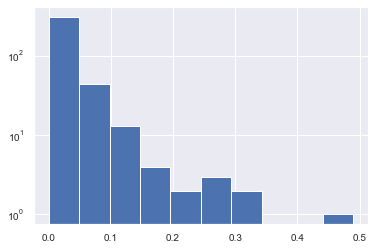

In [30]:

rel_dif_list=[]
for year in time_stamps_likeCBP_list:
    naics_keys_yr=[k+'-Y'+year for k in naics_keys]
    total_vals=df_metro_time['naics_10'+'-Y'+year]
    total_imputed=df_metro_time['naics_10_imputed-Y'+year]
    sum_vals=np.sum(df_metro_time[naics_keys_yr].values,axis=1) 
    rel_dif=1.-sum_vals[total_imputed==False]/total_vals[total_imputed==False]
    rel_dif_list.extend(rel_dif)
plt.hist(rel_dif)
plt.yscale('log')

In [18]:
np.min(rel_dif)

0.0

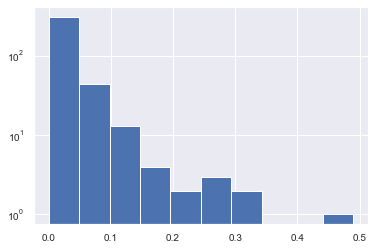

In [14]:
np.median(rel_dif)

0.016827222683838804

In [46]:
df_metro_time.head()

,msa,msa_name,FIPS,naics_10-Y03-Q1-M1,naics_11-Y03-Q1-M1,naics_21-Y03-Q1-M1,naics_22-Y03-Q1-M1,naics_23-Y03-Q1-M1,naics_31-33-Y03-Q1-M1,naics_42-Y03-Q1-M1,...,naics_54_imputed-Y19-Q4-M3,naics_55_imputed-Y19-Q4-M3,naics_56_imputed-Y19-Q4-M3,naics_61_imputed-Y19-Q4-M3,naics_62_imputed-Y19-Q4-M3,naics_71_imputed-Y19-Q4-M3,naics_72_imputed-Y19-Q4-M3,naics_81_imputed-Y19-Q4-M3,naics_92_imputed-Y19-Q4-M3,naics_99_imputed-Y19-Q4-M3
0,10180,"Abilene, TX Metro Area","[48059, 48253, 48441]",46740,332,958,433,2879,2831,2510,...,False,True,True,True,True,True,True,False,True,True
1,10420,"Akron, OH Metro Area","[39133, 39153]",262348,294,308,2403,11521,49422,15238,...,False,False,False,False,False,False,False,False,True,False
2,10500,"Albany, GA Metro Area","[13007, 13095, 13177, 13273, 13321]",48391,128,0,209,3073,8041,2393,...,True,True,True,True,True,True,True,False,True,True
3,10540,"Albany, OR Metro Area",[41043],31579,1326,14,158,1780,7723,1331,...,False,False,False,False,False,False,False,False,True,False
4,10580,"Albany-Schenectady-Troy, NY Metro Area","[36001, 36083, 36091, 36093, 36095]",306001,397,245,1045,14630,22967,15400,...,False,True,True,False,False,False,False,False,True,False


In [32]:
df_metro_time2.head()

,msa,msa_name,FIPS,naics_10-Y03-Q1-M1,naics_11-Y03-Q1-M1,naics_21-Y03-Q1-M1,naics_22-Y03-Q1-M1,naics_23-Y03-Q1-M1,naics_31-33-Y03-Q1-M1,naics_42-Y03-Q1-M1,...,naics_54_imputed-Y19-Q4-M3,naics_55_imputed-Y19-Q4-M3,naics_56_imputed-Y19-Q4-M3,naics_61_imputed-Y19-Q4-M3,naics_62_imputed-Y19-Q4-M3,naics_71_imputed-Y19-Q4-M3,naics_72_imputed-Y19-Q4-M3,naics_81_imputed-Y19-Q4-M3,naics_92_imputed-Y19-Q4-M3,naics_99_imputed-Y19-Q4-M3
0,10180,"Abilene, TX Metro Area","[48059, 48253, 48441]",46740,332,958,433,2879,2831,2510,...,False,False,False,False,False,False,False,False,False,False
1,10420,"Akron, OH Metro Area","[39133, 39153]",262348,294,308,2403,11521,49422,15238,...,False,False,False,False,False,False,False,False,False,False
2,10500,"Albany, GA Metro Area","[13007, 13095, 13177, 13273, 13321]",48391,128,0,209,3073,8041,2393,...,False,False,False,False,False,False,False,False,False,False
3,10540,"Albany, OR Metro Area",[41043],31579,1326,14,158,1780,7723,1331,...,False,False,False,False,False,False,False,False,False,False
4,10580,"Albany-Schenectady-Troy, NY Metro Area","[36001, 36083, 36091, 36093, 36095]",306001,397,245,1045,14630,22967,15400,...,False,False,False,False,False,False,False,False,False,False


## stackplot

In [49]:
def get_1city_stacked_df(df_metro_time,city_name,unq_naics_list):    
    df_1city=df_metro_time[df_metro_time['msa_name'].str.contains(city_name)]
    assert len(df_1city)==1
    naics_keys=['naics_'+naics for naics in unq_naics_list]
    years_temp = [k.zfill(2) for k in np.arange(3, 19).astype(int).astype(str)]
    years =[y+'-Q1-M1' for y in years_temp]
    dict_1city_stacked={'year':[],'total':[]}
    for key in naics_keys:
        dict_1city_stacked.update({key:[]})
    # df_1city_stacked=pd.DataFrame([],columns=['year'].extend(keys_to_plot))
    for year in years:
        dict_1city_stacked['year'].append(year)
        dict_1city_stacked['total'].append(float(df_1city['naics_10-Y'+year].values))
        for key in naics_keys:
            dict_1city_stacked[key].append(float(df_1city[key+'-Y'+year].values))
    df_1city_stacked=pd.DataFrame.from_dict(dict_1city_stacked)    
    return df_1city_stacked, naics_keys

def stackPlot_for_1city(df_metro_time,city_name,unq_naics_list):
    df_1city_stacked,naics_keys=get_1city_stacked_df(df_metro_time,city_name,unq_naics_list )
    fig = plt.figure(figsize=(12, 4))
#     label_naics=[sector_from_naics(df_naics_ref, key, shorten=True) for key in naics_keys]
    label_naics=naics_codes
    ax1 = fig.add_subplot(1, 3, 1)
    ax1.plot(df_1city_stacked['year'],
             df_1city_stacked['total'], 'r-', linewidth=4)
    ax1.set_xlabel('year')
    ax1.set_ylabel('total employment')

    ax2 = fig.add_subplot(1, 3, 2)
    color_list=sns.color_palette(palette='tab20',n_colors=20)
    stckplot = ax2.stackplot(
        df_1city_stacked['year'], df_1city_stacked[naics_keys].values.T, labels=label_naics,
         colors=color_list,linewidth=0.0)
    # color_list = plt.cm.get_cmap('nipy_spectral')(np.asarray(np.linspace(0, 256, len(df_1city_stacked)), dtype=int))
    # color_list = plt.cm.get_cmap('tab20')(np.arange(0,len(df_1city_stacked), dtype=int))
    ax2.plot(df_1city_stacked['year'],
             df_1city_stacked['total'], 'k--', linewidth=2)
    ax2.set_xlabel('year')
    ax2.set_ylabel('employment in naics category')

    fig.legend(stckplot, label_naics, loc='upper right',
               bbox_to_anchor=(.97, 0.9), ncol=2)
    ax3 = fig.add_subplot(1, 3, 3)
    ax3.axis('off')
    for ax in [ax1,ax2]:# [ax1, ax2, ax3]:  # make bigger font
        ax.yaxis.label.set_size(12)
        ax.yaxis.label.set_weight('bold')
        ax.xaxis.label.set_size(12)
        ax.xaxis.label.set_weight('bold')
    ax1.set_title(city_name,fontSize=12, weight='bold')
    fig.patch.set_facecolor('white')
    plt.tight_layout()
    plt.show()


test for 1 city

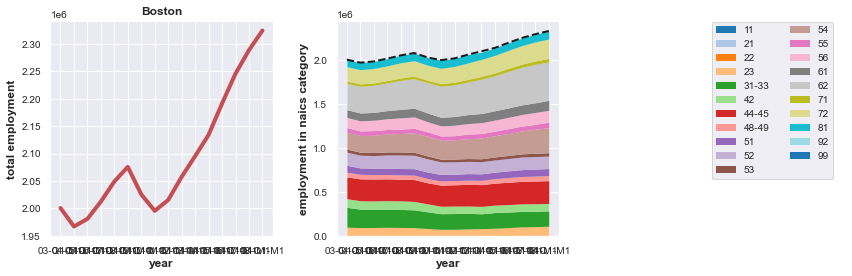

In [50]:

stackPlot_for_1city(df_metro_time,'Boston',naics_codes)


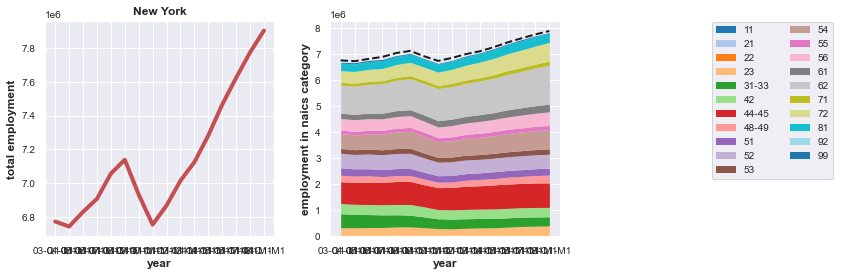

In [60]:
stackPlot_for_1city(df_metro_time,'New York',naics_codes)

##### new plots after fixing data wrangling issue.

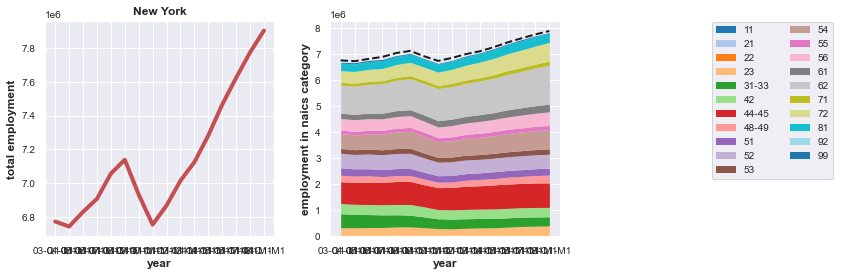

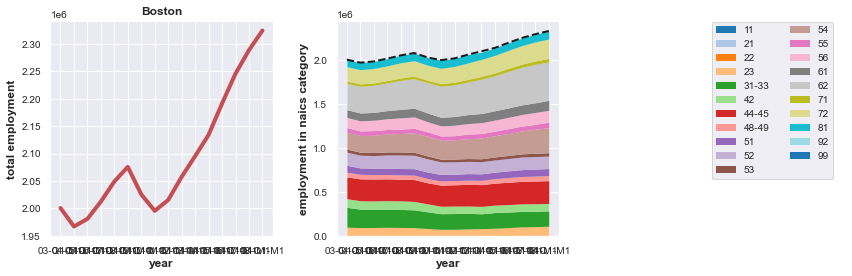

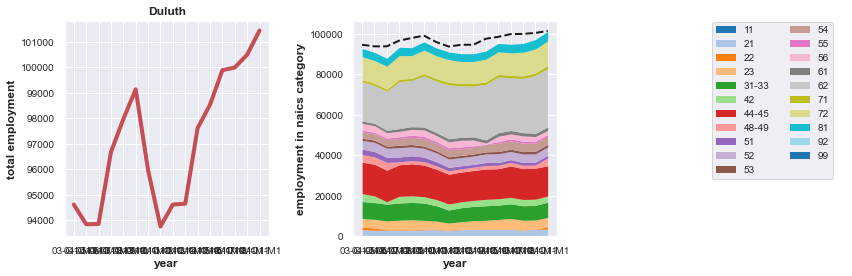

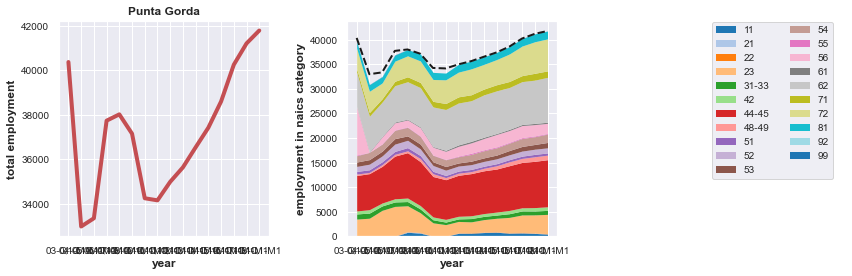

In [64]:
stackPlot_for_1city(df_metro_time,'New York',naics_codes)
stackPlot_for_1city(df_metro_time,'Boston',naics_codes)
stackPlot_for_1city(df_metro_time,'Duluth',naics_codes)

stackPlot_for_1city(df_metro_time,'Punta Gorda',naics_codes)

##### old plots that suggested an issue with the data wrangling.

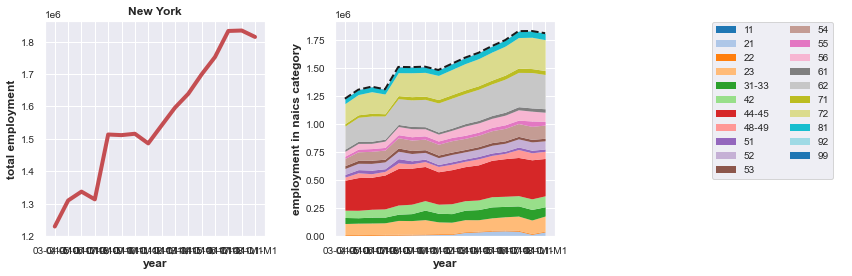

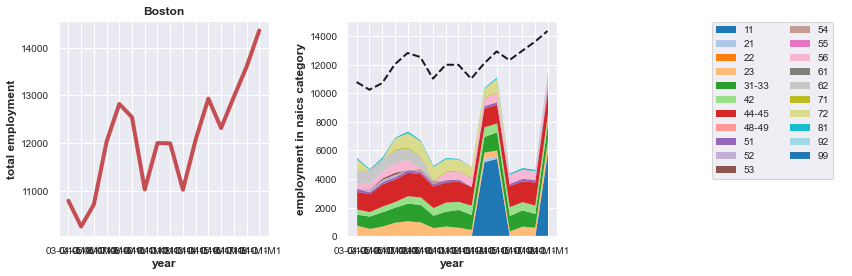

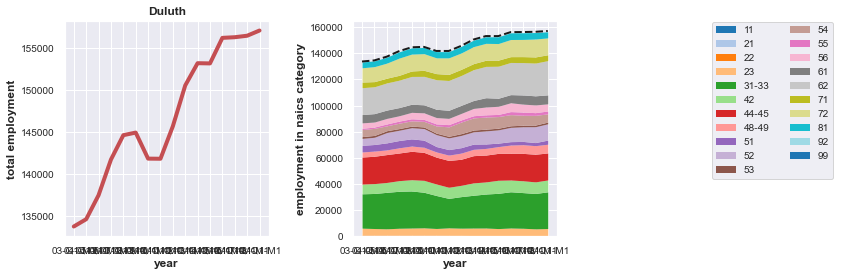

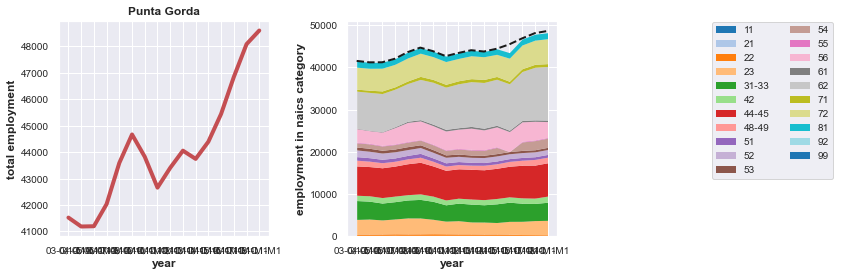

In [22]:
stackPlot_for_1city(df_metro_time,'New York',naics_codes)
stackPlot_for_1city(df_metro_time,'Boston',naics_codes)
stackPlot_for_1city(df_metro_time,'Duluth',naics_codes)

stackPlot_for_1city(df_metro_time,'Punta Gorda',naics_codes)

employment in Boston clearly does not make sense!!! only 14,000? instad of 2x10^6?

# plot statistical features

### distribution of abundances is lognormal??

however fitting the distribution of abundances doesn't make that much sense as the left side of the distribution is clearly truncated because only large MSAs are considered. Including smaller cities would add stuff to the left.

fitting relative abundance would still be more useful than fitting absolute abundances.

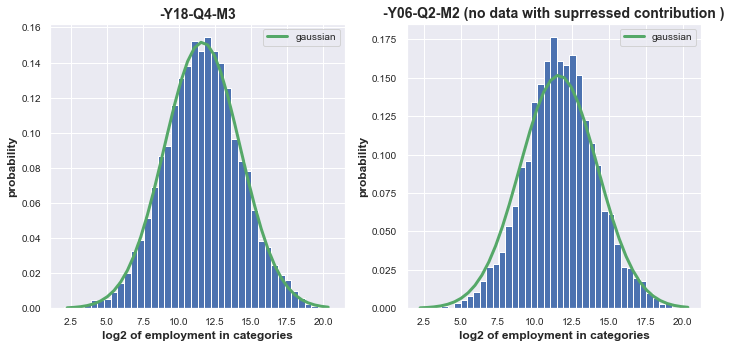

In [8]:

def symm_weibull_dis(x,k,l):
            return (k/l) * np.power((np.abs(x)/l),k-1.) * np.exp(-np.power((np.abs(x)/l),k))  
def get_plot_params(log_size,n_histbins=21):
    mu=np.mean(log_size)
    sigma=np.std(log_size)
    b_laplace=sigma/np.sqrt(2)
    histogram, histbins = np.histogram(log_size, bins=n_histbins, density=True)
    histbin_centers = 0.5*(histbins[1:] + histbins[:-1])

    def func(k, ratio):
        return 0.5*scipy.special.gamma(1+4./k)/np.square(scipy.special.gamma(1+2./k))-ratio

    moment_ratio=stats.moment(log_size,moment=4)/np.power(sigma,4)
    sol_result=  scipy.optimize.root(func, .5,args=moment_ratio)
    weibull_k=float(sol_result.x)
    weibull_lambda= np.sqrt(np.square(sigma)/(2.*scipy.special.gamma(1.+2./weibull_k)) )
#             print ('k= ',"{:.4f}".format(weibull_k),';  lambda= ',"{:.4f}".format(weibull_lambda))

    ### Mculloch estimate, not MLE which is very slow.
    guess_params=levy_stable._fitstart(log_size)
    return  n_histbins, histbin_centers, mu,sigma,b_laplace,weibull_k,weibull_lambda,guess_params

time_stamp1='-Y18-Q4-M3'
time_stamp2='-Y06-Q2-M2'
naics_yr1 = [naics+time_stamp1 for naics in naics_keys_to_plot]
imputed_yr1 = [naics+'_imputed'+time_stamp1 for naics in naics_keys_to_plot]
naics_yr2 = [naics+time_stamp2 for naics in naics_keys_to_plot]
imputed_yr2 = [naics+'_imputed'+time_stamp2 for naics in naics_keys_to_plot]
emp_sizes1=df_metro_time[naics_yr1].values
emp_sizes1=np.ravel(emp_sizes1[emp_sizes1>0])
log_N1=np.log2(emp_sizes1)
emp_sizes2=df_metro_time[naics_yr2].values
imp2=df_metro_time[imputed_yr2]
emp_unimputed2=emp_sizes2[imp2==False]
emp_unimputed2=np.ravel(emp_unimputed2[emp_unimputed2>0])
log_N2=np.log2(emp_unimputed2)

fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
n_histbins, histbin_centers, mu,sigma,b_laplace,weibull_k,weibull_lambda,guess_params=get_plot_params(
    log_N1,n_histbins=40)
ax1.hist(log_N1,bins=n_histbins,density=True)
ax1.plot(histbin_centers,scipy.stats.norm.pdf(histbin_centers,loc=mu,scale=sigma),
         'g-',label='gaussian',lw=3)

n_histbins, histbin_centers, mu,sigma,b_laplace,weibull_k,weibull_lambda,guess_params=get_plot_params(
    log_N1,n_histbins=40)
ax2.hist(log_N2,bins=n_histbins,density=True)
ax2.plot(histbin_centers,scipy.stats.norm.pdf(histbin_centers,loc=mu,scale=sigma),
         'g-',label='gaussian',lw=3)
ax1.set_title(time_stamp1)
ax2.set_title(time_stamp2 +' (no data with suprressed contribution )')
for ax in [ax1,ax2]:                                                        
    ax.set_xlabel(r'log2 of employment in categories')
    ax.set_ylabel(r'probability')
    ax.legend(loc='best')
plt.tight_layout()
plt.show()

## relative abundances stratified by naics category is gamma distributed (cross-sectional AFD)

absolute abundance doesn't have to be gamma distributed, relative abundance of a particular sector is what needs to be gamma distributed (if the sector has identical parameters in all cities)

Agriculture
gamma shape=  0.6099968155894884 scale=  0.03011603671845339
Mining
gamma shape=  0.393797856540711 scale=  0.03254893290259304
Utilities
gamma shape=  2.692266473078812 scale=  0.0018039712039877092
Construction
gamma shape=  8.816449567230256 scale=  0.006835876694853897
Manufacturing
gamma shape=  2.879158003468691 scale=  0.04272067926035879
Wholesale
gamma shape=  7.595632527239842 scale=  0.005071233844358386
Retail trade
gamma shape=  34.88705154050395 scale=  0.004177235105924186
Transporation
gamma shape=  3.7697660694101507 scale=  0.011572893269819168
Information
gamma shape=  3.5394860453568704 scale=  0.00405416247489755
Finance
gamma shape=  5.254103725358907 scale=  0.006954870843310526
Real Estate
gamma shape=  6.9097059977113275 scale=  0.002217024389817939
Professional
gamma shape=  3.8724849094373437 scale=  0.01308149507356239
Management
gamma shape=  1.5799236912372443 scale=  0.00802681333252956
Administrative
gamma shape=  9.039753736218806 scale=  0.

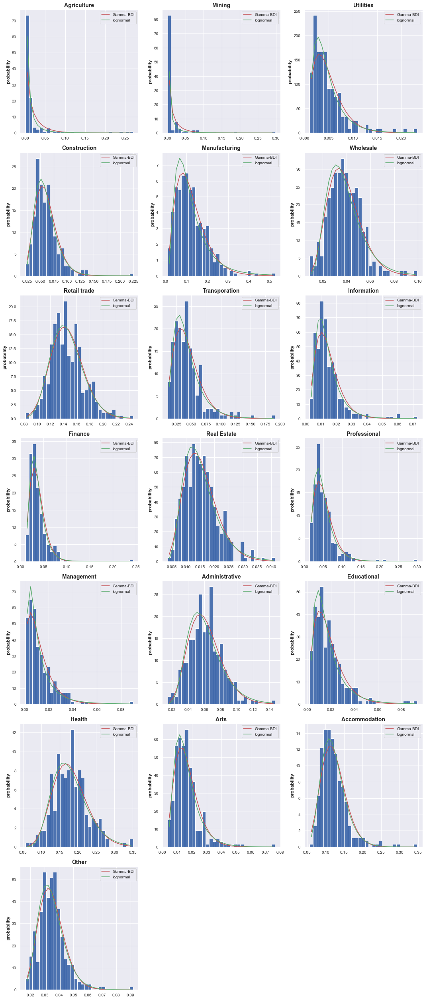

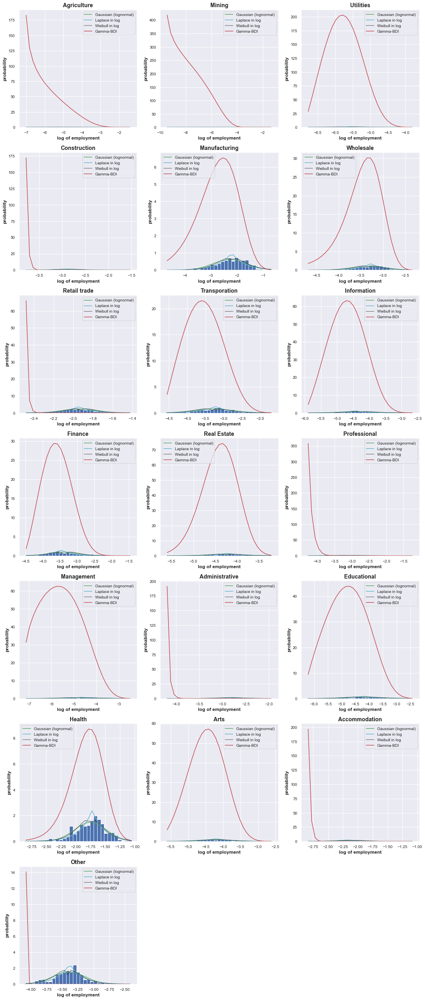

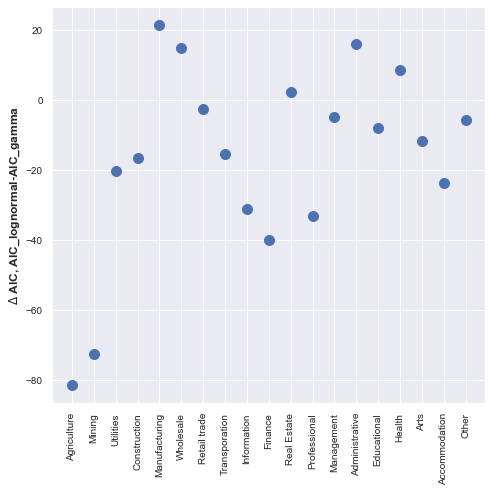

In [4]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
time_stamp='12-Q2-M2'

shared_func.plot_abundance_fit_by_naics(df_metroF_time, naics_keys_to_plot, year,
                             remove_imputed_values=True)

Agriculture
gamma shape=  0.6099968155894884 scale=  0.03011603671845339
Mining
gamma shape=  0.393797856540711 scale=  0.03254893290259304
Utilities
gamma shape=  2.692266473078812 scale=  0.0018039712039877092
Construction
gamma shape=  8.816449567230256 scale=  0.006835876694853897
Manufacturing
gamma shape=  2.879158003468691 scale=  0.04272067926035879
Wholesale
gamma shape=  7.595632527239842 scale=  0.005071233844358386
Retail trade
gamma shape=  34.88705154050395 scale=  0.004177235105924186
Transporation
gamma shape=  3.7697660694101507 scale=  0.011572893269819168
Information
gamma shape=  3.5394860453568704 scale=  0.00405416247489755
Finance
gamma shape=  5.254103725358907 scale=  0.006954870843310526
Real Estate
gamma shape=  6.9097059977113275 scale=  0.002217024389817939
Professional
gamma shape=  3.8724849094373437 scale=  0.01308149507356239
Management
gamma shape=  1.5799236912372443 scale=  0.00802681333252956
Administrative
gamma shape=  9.039753736218806 scale=  0.

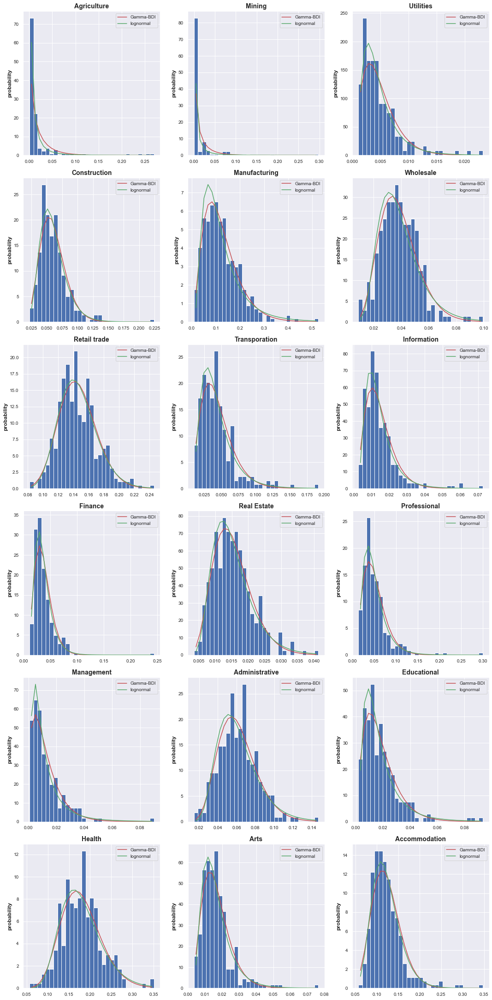

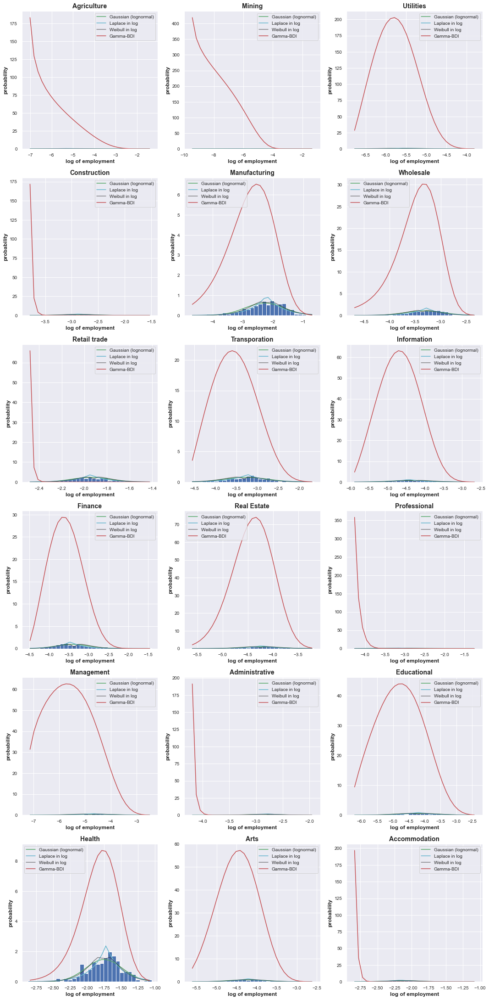

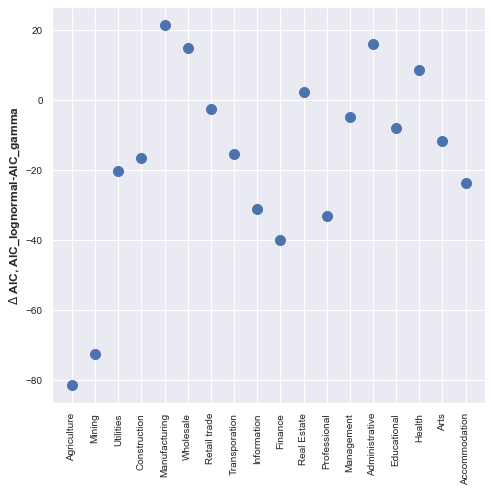

In [5]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
time_stamp='17-Q4-M3'

shared_func.plot_abundance_fit_by_naics(df_metroF_time, naics_keys_to_plot, year,
                             remove_imputed_values=True)

#####  absolute abundance need not be gamma distributed.

0.09222490220931327 7.999999999999999 47158148.71672384
0.08216708363044672 7.999999999999999 59694289.717726074
0.10249504768575757 11.999999999999996 9236032.786498696
0.08012507120052181 383.9999999999999 2393273812.4299164
0.07576958498392419 499.9999999999999 4632957647.186229
0.07777973661781624 30.999999999999993 1962709074.1704035
0.07809000603034193 2292.9999999999995 6142444172.583807
0.07685266106615063 86.99999999999997 2493170980.824162
0.07836581936676976 60.99999999999999 986223836.1398258
0.0760715860329439 288.99999999999994 2531499232.049776
0.08091996158187277 133.99999999999997 461585489.3729387
0.13751584304321168 16.999999999999996 6428842281.335876
0.08353582661474676 24.999999999999993 413910272.31303346
0.07434190985893258 466.99999999999994 5066456140.728317
0.07736480022111974 56.999999999999986 890135722.0883697
0.0769638847362411 1015.9999999999999 15232513336.614056
0.08480468264848641 54.999999999999986 411892768.719638
0.07869794929988572 1721.9999999999

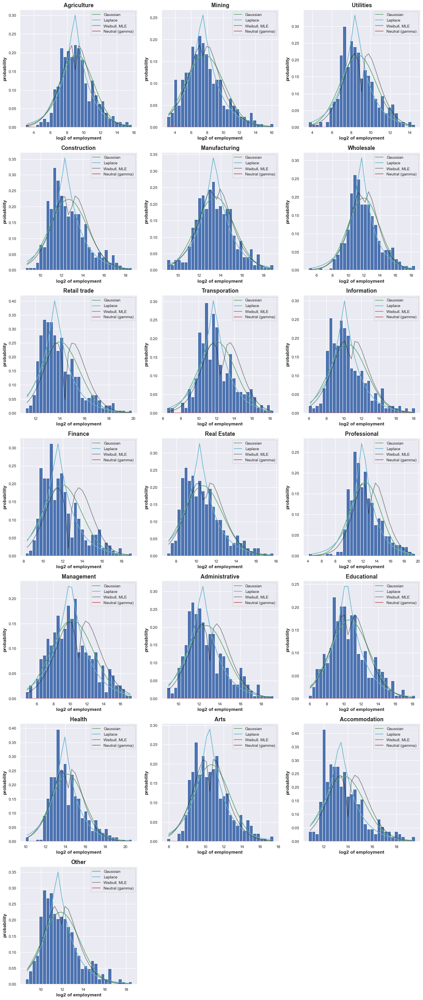

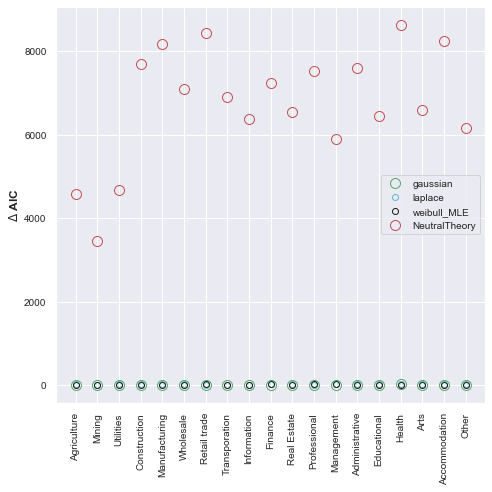

In [3]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
time_stamp='12-Q2-M2'

shared_func.plot_abundance_fit_by_naics(df_metro_time, naics_keys_to_plot, year,
                             remove_imputed_values=True)

0.5146975890253629 0.00017153026437101993 0.02311232310543805
0.6036858243041863 6.146716535785065e-05 0.00567758882526366


ValueError: autodetected range of [-13.721428557927503, inf] is not finite

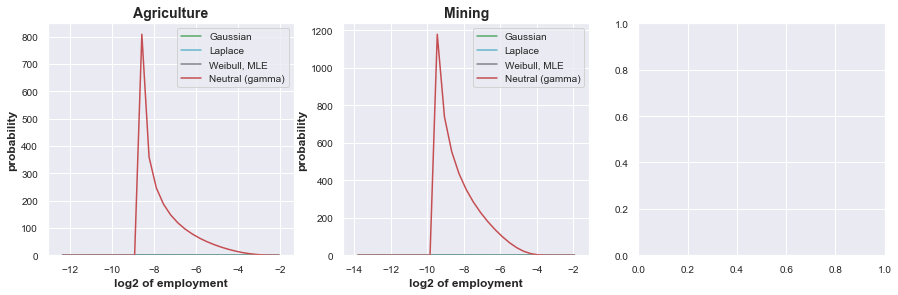

weibull MLE, k=  1.2642 ;  lambda=  0.8493
AIC dict= {'gaussian': [19778.327398740323], 'laplace': [20124.988589951405], 'weibull_MLE': [19790.570217274617], 'weibull_MM': []}


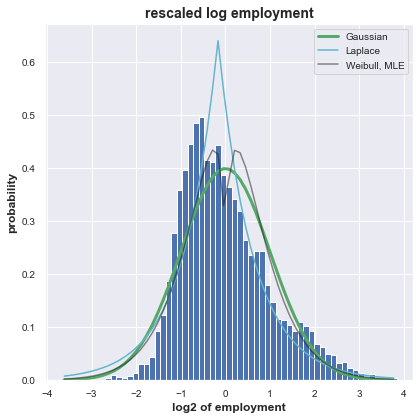

In [20]:
shared_func.plot_agg_rescaled_employment(df_metro_time, naics_keys_to_plot, year,
                             BLS=False, remove_imputed_values=True)

## is aggregated temporal AFD Gamma distributed  [Grilli; Azaele] 
AFD is the distribution of x(t)
Both Grilli and Azaele predict a gamma distribution for the steady state pdf. We need to rescale the mean before fitting with a gamma.

##### for fractions instead of absolute abundances.

for rescaled:  37.511481732631005 0.0 0.02665850437814366
AIC= -570420.3203825752
for relative:  1.0277053706180534 0.0 0.06356118937806474
AIC= -2450892.4059252767


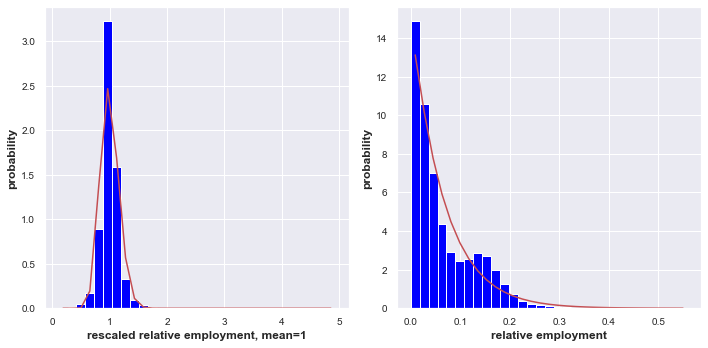

In [18]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metroF_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
emp_agg=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            emp_rescaled_agg.extend(emp_time/np.mean(emp_time))           
            emp_agg.extend(emp_time)
            
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
emp_agg=np.ravel(np.array(emp_agg))

fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)

n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)
a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
print ('for rescaled: ', a_gamma,loc_gamma, scale_gamma)
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')

ax2 = fig.add_subplot(1,2,2)
histogram, bins = np.histogram(emp_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax2.hist(emp_agg, bins=n_bins, color='blue',density=True)
a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_agg,1.,floc=0.,scale=np.var(emp_agg) )
logLik = np.sum( scipy.stats.gamma.logpdf(emp_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
print ('for relative: ', a_gamma,loc_gamma, scale_gamma)
print ('AIC=', 2*2-2*logLik )
ax2.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')


ax1.set_xlabel('rescaled relative employment, mean=1')
ax2.set_xlabel('relative employment')
for ax in [ax1,ax2]:
    ax.set_ylabel(r'probability')        
#     ax.set_ylim(1e-6,10.)
#     ax.set_yscale('log')

fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()




above plot with yscaled log axis. panel b seems to be almost exponential decay.

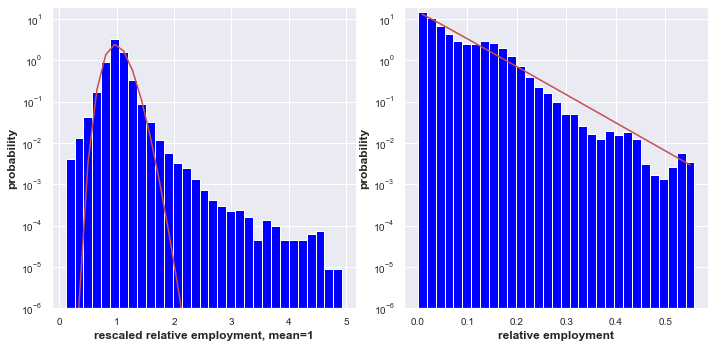

In [19]:
##### now we change the yscale and plot again
for ax in [ax1,ax2]:      
    ax.set_ylim(1e-6,20.)
    ax.set_yscale('log')
fig_semilog=  fig
fig_semilog

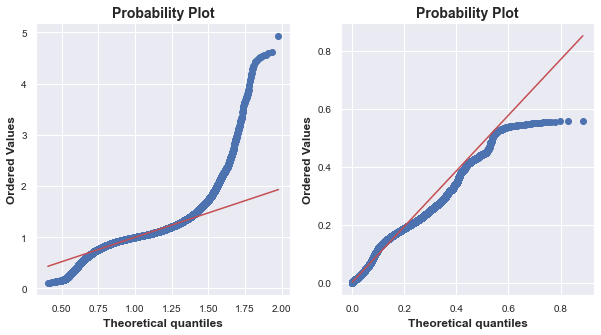

In [28]:
fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )
res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax1)

ax2 = fig.add_subplot(1,2,2)
a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_agg,1.,floc=0.,scale=np.var(emp_agg) )
res=scipy.stats.probplot(emp_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)

### rescaled employment (mean =1)

32.839160865902564 0.0 0.030451448016088498
AIC= -485501.47459961026


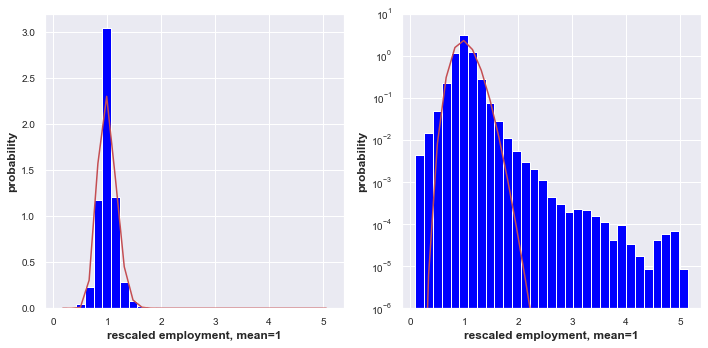

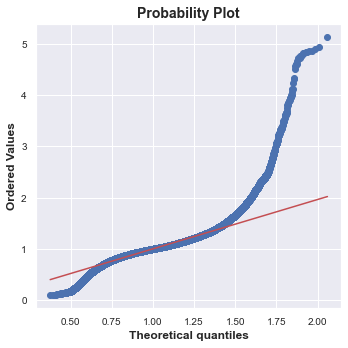

In [32]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            emp_rescaled_agg.extend(emp_time/np.mean(emp_time))
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))

fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])


a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
print ('AIC=', 2*2-2*logLik )
for ax in [ax1,ax2]:
    ax.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)
    ax.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)
    ax.plot(bin_centers, scipy.stats.gamma.pdf(
        bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
    ax.set_xlabel('rescaled employment, mean=1')
    ax.set_ylabel(r'probability')        
ax2.set_ylim(1e-6,10.)
ax2.set_yscale('log')
fig.patch.set_facecolor('white')
plt.tight_layout()



fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()
a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )
res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)
plt.tight_layout()

plt.show()

### rescaled emp, by theta using log growth information.
The scale parameter (theta) of the gamma distribution is inferred separately for each trajecotry via MLE fit, where shape=b/d is held fixed to the value inferred from the logarithmic growth rates fit.

This procedure gives a much better looking fit to the gamma distribution on the q-q plot than if we were to fit both shape and scale by MLE and use that theta to rescale the distribution.

- is this simply an artifact of holding the shape parameters of all trajectories fixed to some value?


- scale of the final aggregate distribution isn't 1..

nparams= 1
6.836822782400739 0.0 0.2513364957766667
AIC= 1366170.1135695768


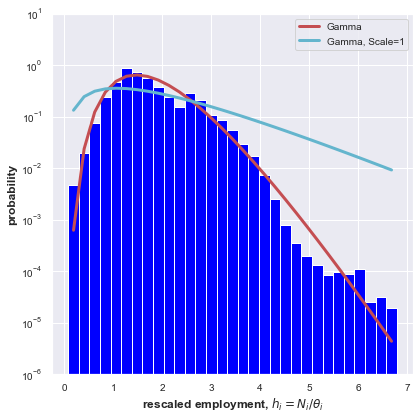

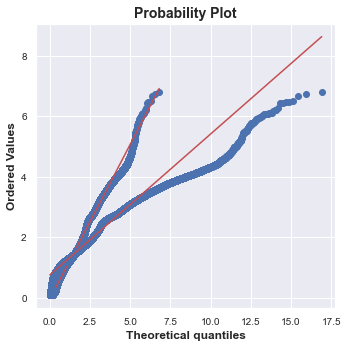

In [34]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_fitvals = pickle.load(handle)  
shape_param_list=[]
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    shape_param_list.append(logG_fitvals['NeutralTheory'][idx][1])

df_gamma_fitted_shapeFixed=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
    shape_fixed=np.array(shape_param_list))

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_gamma_fitted_shapeFixed)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            theta_param=float(df_sub[naics+'-fit_scale_theta'])
            emp_rescaled_agg.extend(emp_time/theta_param)
            
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=1. )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-', lw=3,label='Gamma')
ax1.set_xlabel(r'rescaled employment, $h_i= N_i/\theta_i$')

a_gamma2,loc_gamma2, scale_gamma2=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,fscale=1. )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma2,loc=loc_gamma2, scale= scale_gamma2),'c-', lw=3,label='Gamma, Scale=1')
ax1.legend(loc='best')
for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()

res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)

res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma2,loc_gamma2, scale_gamma2), dist='gamma', 
                         fit=True,plot=ax2)


# ax2.get_lines()[0].set_markerfacecolor('m')
# ax2.get_lines()[2].set_markerfacecolor('c')
plt.tight_layout()
plt.show()

##### rescaling by theta for employment data of a single time point

nparams= 1
7.725568662779099 0.0 0.21370039837580343
AIC= 6029.437404738034


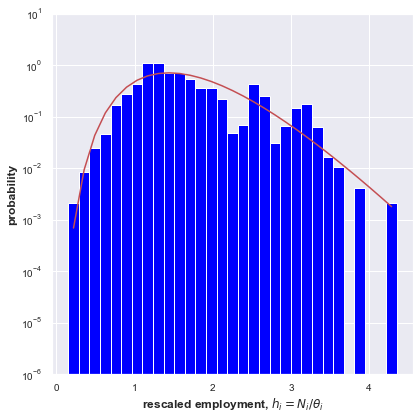

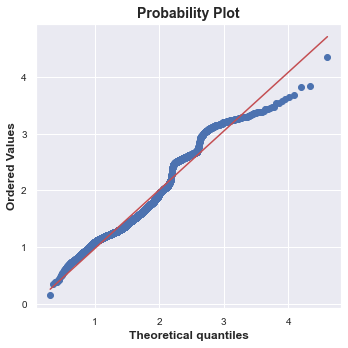

In [18]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_fitvals = pickle.load(handle)  
shape_param_list=[]
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    shape_param_list.append(logG_fitvals['NeutralTheory'][idx][1])

df_gamma_fitted_shapeFixed=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
    shape_fixed=np.array(shape_param_list))

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_gamma_fitted_shapeFixed)

time_stamps_sampled=['11-Q3-M3']

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_sampled]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_sampled]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            theta_param=float(df_sub[naics+'-fit_scale_theta'])
            if theta_param!=0: ## if theta wasn't fit, then it was set to zero
                emp_rescaled_agg.extend(emp_time/theta_param)
            
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=1. )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
ax1.set_xlabel(r'rescaled employment, $h_i= N_i/\theta_i$')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()

res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)
plt.tight_layout()
plt.show()

In [14]:
emp_time

array([[4803]])

##### rescaling by theta when k is fixed to arbitray constant ( as a test) 

nparams= 1
32.839160865900595 0.0 0.12180579206436129
AIC= 1511095.1160597105


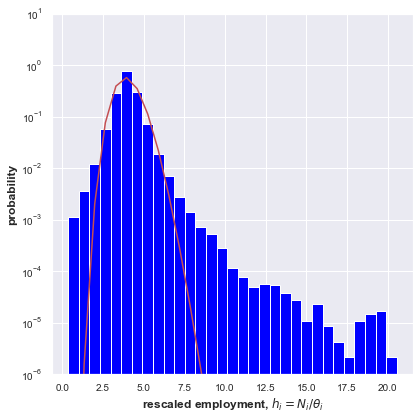

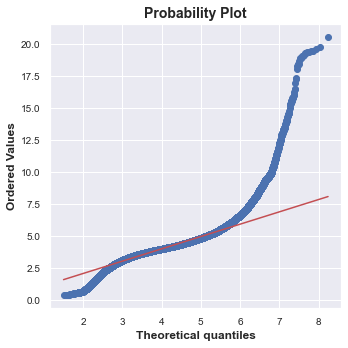

In [171]:
shape_param_list=[]
for naics in naics_keys_to_plot:
    shape_param_list.append(4.)
    

df_new=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
    shape_fixed=np.array(shape_param_list))

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')


msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            theta_param=float(df_sub[naics+'-fit_scale_theta'])
            emp_rescaled_agg.extend(emp_time/theta_param)
            
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=1. )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
ax1.set_xlabel(r'rescaled employment, $h_i= N_i/\theta_i$')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()

res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)
plt.tight_layout()
plt.show()

#### rescaling gamma distribution using theta without logG information does not do nearly as well

 

theta inferred as ratio of variance to mean of trajectory

0.767188602169275 0.0 204.49430340960402
AIC= 8684519.878691595


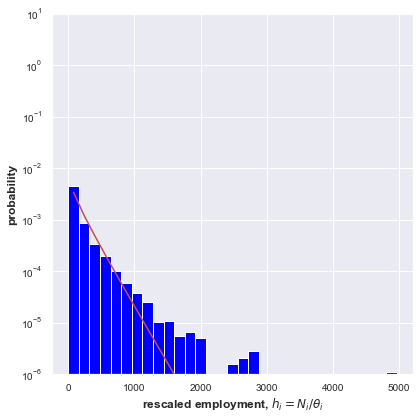

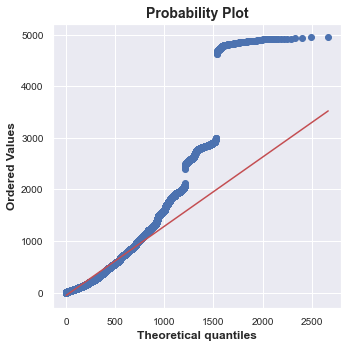

In [168]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            theta_param=np.var(emp_time)/np.mean(emp_time) ## scale parameter of gamma distribution
            emp_rescaled_agg.extend(emp_time/theta_param)
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=1. )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
# AIC_dict['NeutralTheory'].append(2*2-2*logLik)
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
ax1.set_xlabel(r'rescaled employment, $h_i= N_i/\theta_i$')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()

res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)
plt.tight_layout()
plt.show()

when k and theta are fit by MLE

0.7705669109786037 0.0 204.0126394573751
AIC= 8688738.875427093


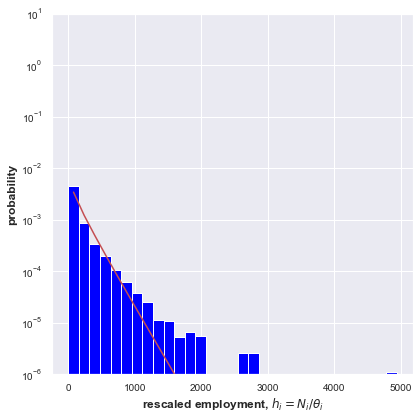

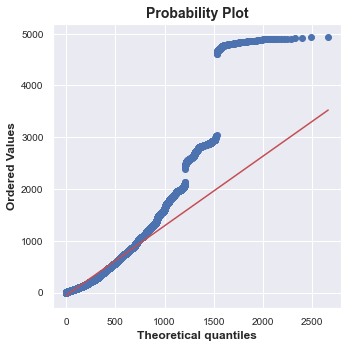

In [169]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]


k_list=[]
theta_list=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            theta_guess=np.var(emp_time)/np.mean(emp_time) ## scale parameter of gamma distribution
            k_gamma,_, scale_gamma=scipy.stats.gamma.fit(emp_time,1.,floc=0.,scale=theta_guess )
            
            k_list.append(k_gamma)
            theta_list.append(scale_gamma)
            
            emp_rescaled_agg.extend(emp_time/scale_gamma)
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))

fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=1. )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
# AIC_dict['NeutralTheory'].append(2*2-2*logLik)
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
# xaxis_vals=np.linspace(ax1.get_xlim()[0],ax1.get_xlim()[1],10)
# ax1.legend(loc='best')
ax1.set_xlabel(r'rescaled employment, $h_i= N_i/\theta_i$')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()



fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()
res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax2)
plt.tight_layout()
plt.show()


213.15316321779602

### rescaled emp, stratifed by naics category 

rescaling each Trajectory by its own theta, and plotting each sector separately.

naics_11
11.67658550797894 0.0 0.10767607202123271
naics_21
7.827332076782151 0.0 0.14426949694282934
naics_22
36.54381327307412 0.0 0.025521652771869303
naics_23
29.24877476250171 0.0 0.06963035626424846
naics_31-33
61.669393919280054 0.0 0.021215858238566292
naics_42
78.27842512050849 0.0 0.01988248547478531
naics_44-45
259.57050725865923 0.0 0.010235115778457215
naics_48-49
34.837943159580064 0.0 0.04367040992824726
naics_51
22.562290314941663 0.0 0.05803830495171856
naics_52
71.11042041411709 0.0 0.018325384107682308
naics_53
59.27527611321449 0.0 0.03198826178550839
naics_54
59.84681457793107 0.0 0.02774494476802707
naics_55
8.846305713637202 0.0 0.09452568419730524
naics_56
35.27483125169226 0.0 0.043536619005565005
naics_61
18.482807092937836 0.0 0.059590258267758545
naics_62
49.927991656125016 0.0 0.0407564958582356
naics_71
20.484418820770365 0.0 0.06562123074567587
naics_72
67.77342455061272 0.0 0.047668591173798174


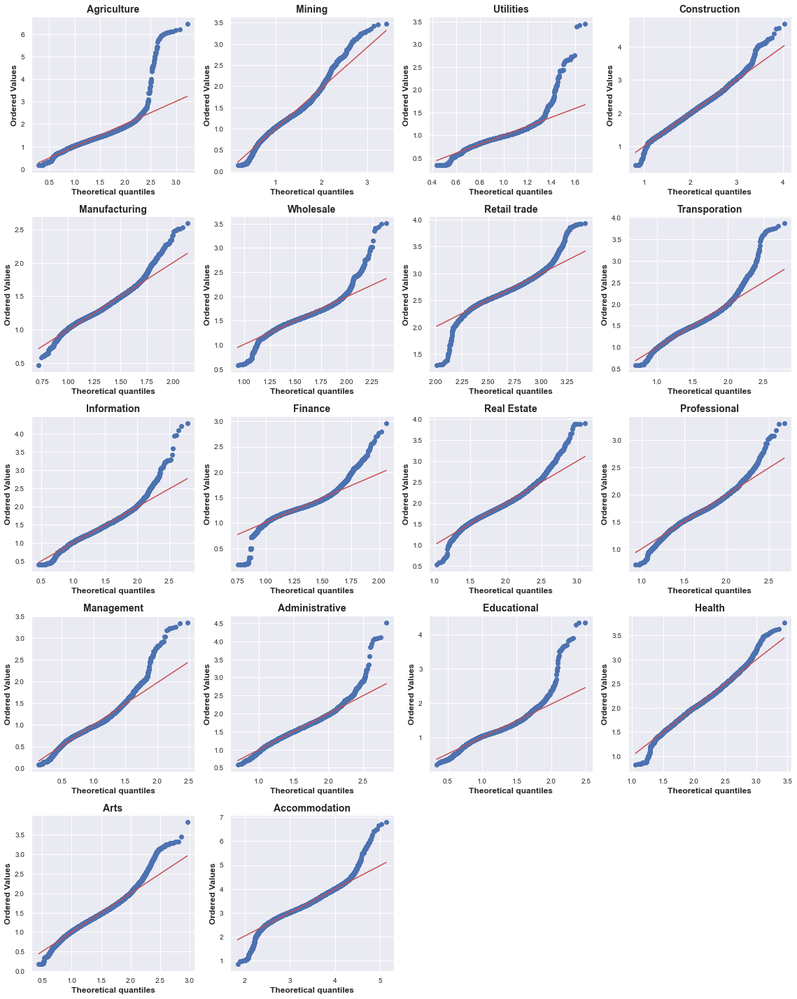

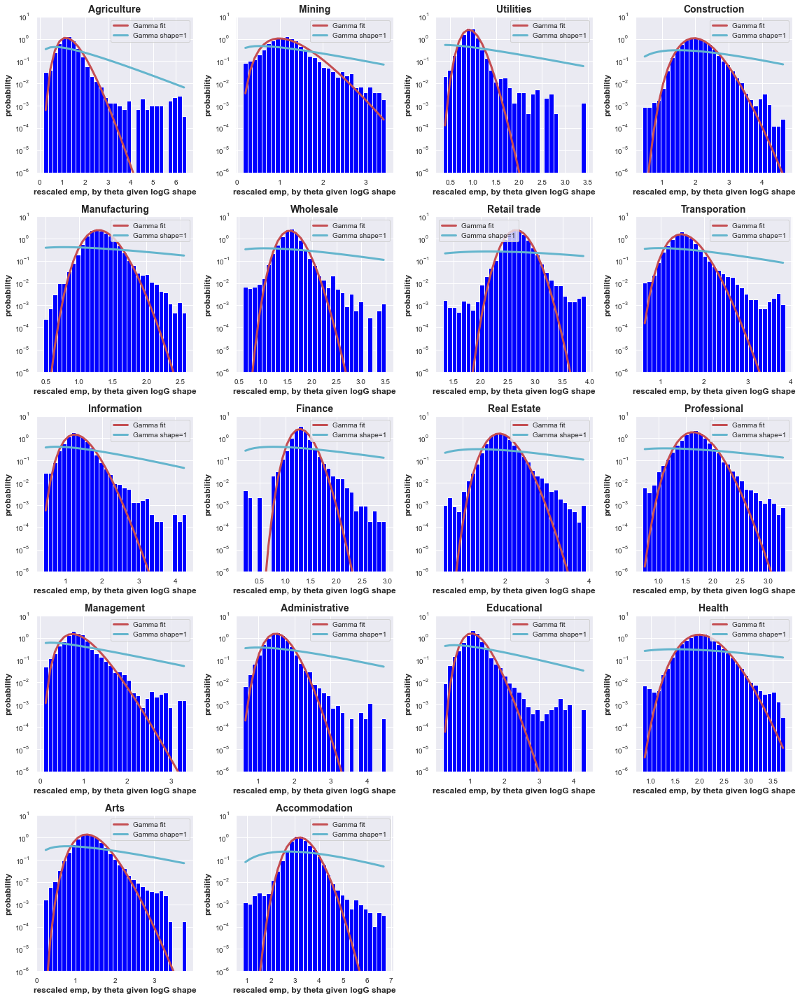

In [33]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_fitvals = pickle.load(handle)  
shape_param_list=[]
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    shape_param_list.append(logG_fitvals['NeutralTheory'][idx][1])

# df_gamma_fitted_shapeFixed=get_gamma_dist_params_constrained(
#     df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
#     shape_fixed=np.array(shape_param_list))


df_new=deepcopy(df_gamma_fitted_shapeFixed)

msas = df_new['msa'].values
n_msas = len(msas)
fig2 = plt.figure(figsize=(16, 20))
fig = plt.figure(figsize=(16, 20))

n_cols=4
n_rows=5
for ctr, naics_key in enumerate(naics_keys_to_plot):
    emp_rescaled_agg=[]
    ax1 = fig.add_subplot(n_rows,n_cols, ctr+1)
    ax_fig2 = fig2.add_subplot(n_rows,n_cols, ctr+1)
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics_key, shorten=True)
    for msa_idx,msa in enumerate(msas):
        for nidx,naics in enumerate([naics_key]):         
            df_sub=df_new[df_new['msa']==msa]
            naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
            imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
            if np.all(df_sub[imputed_keys_time].values==False):
                emp_time=df_sub[naics_time_keys].values
                theta_param=float(df_sub[naics+'-fit_scale_theta'])
                if theta_param!=0:                   
                    emp_rescaled_agg.extend(emp_time/theta_param)
                    

    emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
    n_bins=31
    histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
    bin_centers = 0.5*(bins[1:] + bins[:-1])
    ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

    a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
        emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )

    print (naics_key)
    print (a_gamma,loc_gamma, scale_gamma)
    logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 

#     print ('AIC=', 2*2-2*logLik )
    ax1.plot(bin_centers, scipy.stats.gamma.pdf(
        bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-', lw=3,label='Gamma fit')

    
    a_gamma2,_, _=scipy.stats.gamma.fit(
        emp_rescaled_agg,1.,floc=0.,fscale=1)
    ax1.plot(bin_centers, scipy.stats.gamma.pdf(
        bin_centers, a_gamma2,loc=0, scale= 1),'c-', lw=3,label='Gamma shape=1')
    
#     ax1.plot(bin_centers, scipy.stats.gamma.pdf(
#         bin_centers, shape_param_list[ctr],loc=0, scale= 1),'g-', lw=3,label='Gamma Prediction')
    
    ax1.legend(loc='best')
    res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax_fig2)
    ax_fig2.set_title(naics_name)
    ax1.set_xlabel('rescaled emp, by theta given logG shape')
    ax1.set_ylabel(r'probability')        
    ax1.set_ylim(1e-6,10.)
    ax1.set_yscale('log')
    ax1.set_title(naics_name)
    
    


fig.patch.set_facecolor('white')
fig.tight_layout()
fig2.patch.set_facecolor('white')
fig2.tight_layout()
plt.show()

rescaled by mean

11.676585507978807 0.0 0.08564147449754753
AIC= 4601.613364306714
7.827332076782202 0.0 0.12775745173329833
AIC= 9890.35486693821
36.543813273074036 0.0 0.027364413027384123
AIC= -17635.74455913463
29.248774762501693 0.0 0.03418946633217768
AIC= -32037.4228918695
61.66939391927889 0.0 0.01621549907412635
AIC= -79235.61462048338
78.27842512050053 0.0 0.012774912096923467
AIC= -55899.76162434176
259.57050725865827 0.0 0.003852517801660396
AIC= -198914.87413670303
34.837943159580234 0.0 0.028704335253644433
AIC= -19112.702462890047
22.56229031494169 0.0 0.044321741544906826
AIC= -12951.157692060242
71.1104204141153 0.0 0.01406263658935564
AIC= -84057.16520721126
59.275276113212804 0.0 0.01687044018302083
AIC= -67105.82855273409
59.84681457793148 0.0 0.01670932708870941
AIC= -37417.578965419394
8.846305713637294 0.0 0.11304153760573966
AIC= 14447.928758528544
35.274831251691765 0.0 0.028348824488055927
AIC= -25201.86588549395
18.482807092937836 0.0 0.05410433571976703
AIC= -4355.9020550788

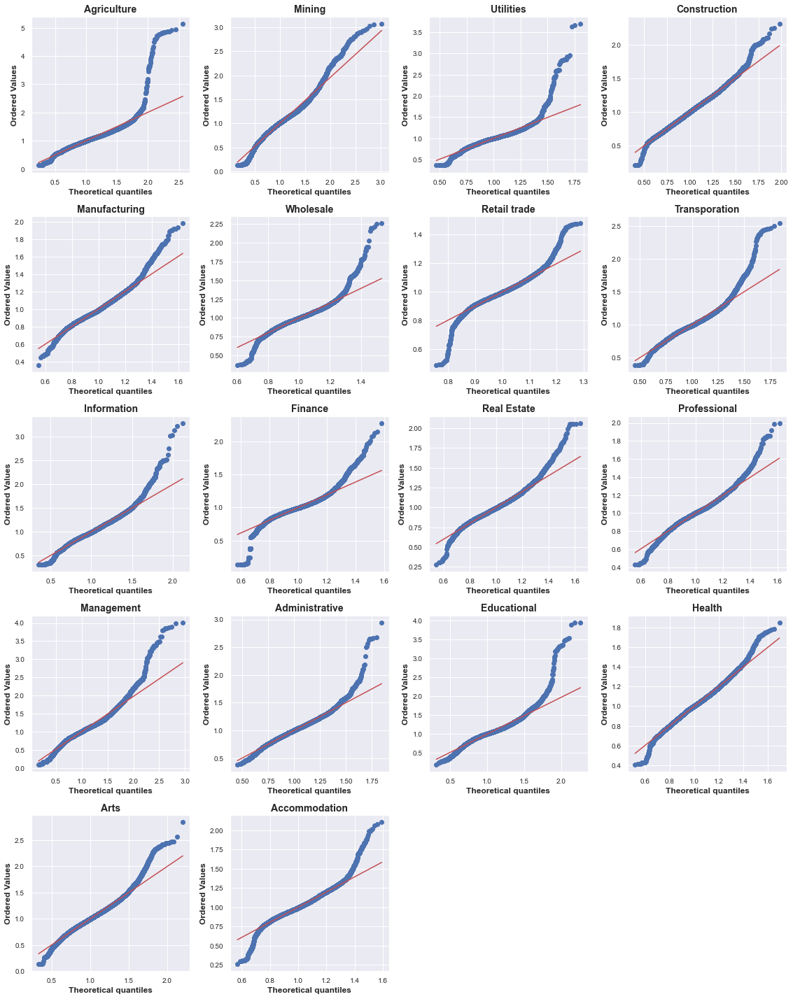

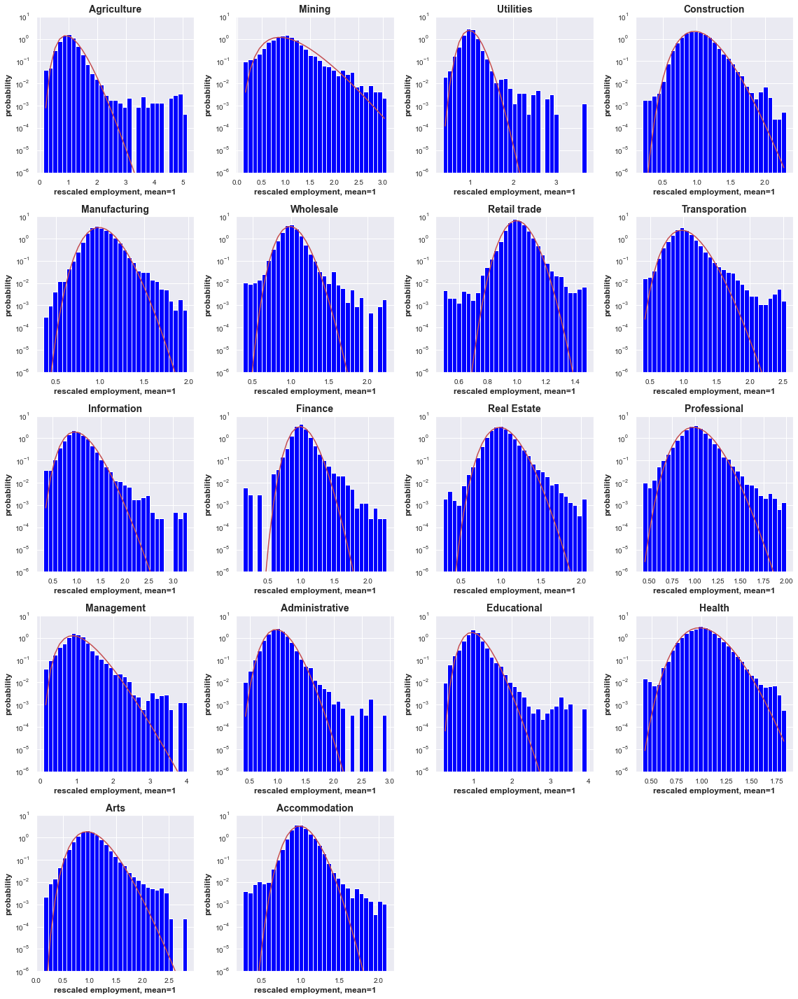

In [45]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)
msas = df_new['msa'].values
n_msas = len(msas)
fig2 = plt.figure(figsize=(16, 20))
fig = plt.figure(figsize=(16, 20))

n_cols=4
n_rows=5
for ctr, naics_key in enumerate(naics_keys_to_plot):
    emp_rescaled_agg=[]
    ax1 = fig.add_subplot(n_rows,n_cols, ctr+1)
    ax_fig2 = fig2.add_subplot(n_rows,n_cols, ctr+1)
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics_key, shorten=True)
    for msa_idx,msa in enumerate(msas):
        for nidx,naics in enumerate([naics_key]):         
            df_sub=df_new[df_new['msa']==msa]
            naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
            imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
            if np.all(df_sub[imputed_keys_time].values==False):
                emp_time=df_sub[naics_time_keys].values        
                emp_rescaled_agg.extend(emp_time/np.mean(emp_time))
    emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
    n_bins=31
    histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
    bin_centers = 0.5*(bins[1:] + bins[:-1])
    ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

    a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
        emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )

    print (a_gamma,loc_gamma, scale_gamma)
    logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 

    print ('AIC=', 2*2-2*logLik )
    ax1.plot(bin_centers, scipy.stats.gamma.pdf(
        bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')

    res=scipy.stats.probplot(emp_rescaled_agg, sparams=(a_gamma,loc_gamma, scale_gamma), dist='gamma', 
                         fit=True,plot=ax_fig2)
    ax_fig2.set_title(naics_name)
    ax1.set_xlabel('rescaled employment, mean=1')
    ax1.set_ylabel(r'probability')        
    ax1.set_ylim(1e-6,10.)
    ax1.set_yscale('log')
    ax1.set_title(naics_name)
    
    


fig.patch.set_facecolor('white')
fig.tight_layout()
fig2.patch.set_facecolor('white')
fig2.tight_layout()
plt.show()

##### standardized employment mean=0, variance=1.. Now we have to change the loc parameter of the gamma distribution as well, which is weird and not present in theory.

2150.231707404013 -46.20268262638834 0.021486387599423604
AIC= 2041205.8853809307


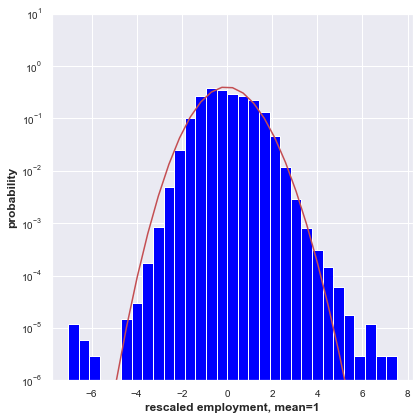

In [12]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_stdzd_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            emp_stdzd_agg.extend((emp_time-np.mean(emp_time))/np.std(emp_time))
emp_stdzd_agg=np.ravel(np.array(emp_stdzd_agg))
n_bins=31
histogram, bins = np.histogram(emp_stdzd_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_stdzd_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_stdzd_agg,1.,loc=0.,scale=np.var(emp_stdzd_agg) )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_stdzd_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
# AIC_dict['NeutralTheory'].append(2*2-2*logLik)
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
# xaxis_vals=np.linspace(ax1.get_xlim()[0],ax1.get_xlim()[1],10)
# ax1.legend(loc='best')
ax1.set_xlabel('rescaled employment, mean=1')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

80.08286741226766 -0.5379271043834297 0.019204196378077493
AIC= -498797.7122999901


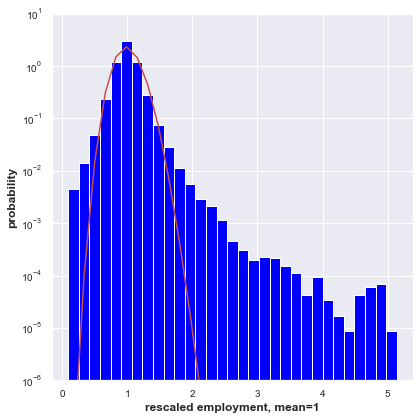

In [9]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            emp_rescaled_agg.extend(emp_time/np.mean(emp_time))
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,loc=0.,scale=np.var(emp_rescaled_agg) )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
# AIC_dict['NeutralTheory'].append(2*2-2*logLik)
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
# xaxis_vals=np.linspace(ax1.get_xlim()[0],ax1.get_xlim()[1],10)
# ax1.legend(loc='best')
ax1.set_xlabel('rescaled employment, mean=1')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

32.83916086590391 0.0 0.3045144801608726
AIC= 2830773.679734144


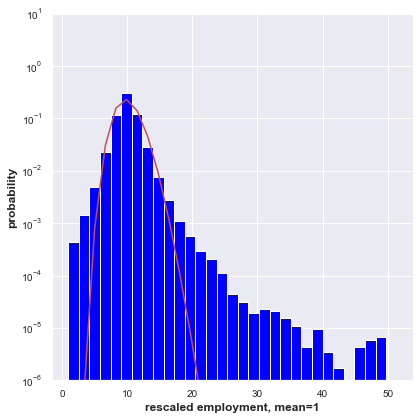

In [8]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_new=deepcopy(df_metro_time)

msas = df_new['msa'].values
n_msas = len(msas)
emp_rescaled_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values        
            emp_rescaled_agg.extend(10.*emp_time/np.mean(emp_time))
emp_rescaled_agg=np.ravel(np.array(emp_rescaled_agg))
n_bins=31
histogram, bins = np.histogram(emp_rescaled_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist(emp_rescaled_agg, bins=n_bins, color='blue',density=True)

a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(
    emp_rescaled_agg,1.,floc=0.,scale=np.var(emp_rescaled_agg) )
# a_gamma,loc_gamma, scale_gamma=scipy.stats.gamma.fit(emp,2.,loc=np.mean(emp),scale=np.var(emp))
print (a_gamma,loc_gamma, scale_gamma)
logLik = np.sum( scipy.stats.gamma.logpdf(emp_rescaled_agg, a_gamma,loc=loc_gamma, scale= scale_gamma) ) 
# AIC_dict['NeutralTheory'].append(2*2-2*logLik)
print ('AIC=', 2*2-2*logLik )
ax1.plot(bin_centers, scipy.stats.gamma.pdf(
    bin_centers, a_gamma,loc=loc_gamma, scale= scale_gamma),'r-',label='Gamma')
# xaxis_vals=np.linspace(ax1.get_xlim()[0],ax1.get_xlim()[1],10)
# ax1.legend(loc='best')
ax1.set_xlabel('rescaled employment, mean=1')

for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

In [11]:
np.shape(emp_time)

(1, 204)

###### a confused attempt at standardizing the pdf, which did not work.

In [36]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_metro_fitted=shared_func.get_gamma_dist_params(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list)
df_metroF_fitted=shared_func.get_gamma_dist_params(df_metroF_time, naics_keys_to_plot, time_stamps_likeCBP_list)

No handles with labels found to put in legend.


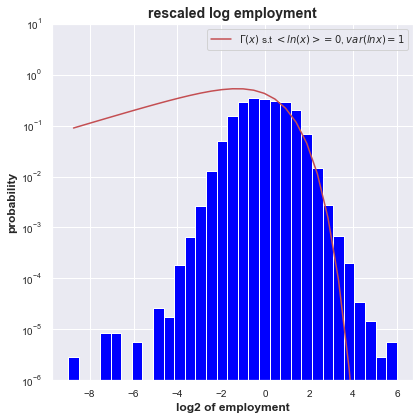

In [58]:
df_new=deepcopy(df_metro_fitted)

msas = df_new['msa'].values
n_msas = len(msas)
logemp_stdzd_agg=[]
fig = plt.figure(figsize=(6, 6))
ax1 = fig.add_subplot()

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):         
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            emp_time=df_sub[naics_time_keys].values
            
            log_emp=np.squeeze(np.log2(emp_time))
            log_emp_stdzed=(log_emp-np.mean(log_emp))/np.std(log_emp)
            

            logemp_stdzd_agg.extend(log_emp_stdzed)
logemp_stdzd_agg=np.ravel(np.array(logemp_stdzd_agg))
n_bins=31
histogram, bins = np.histogram(logemp_stdzd_agg, bins=n_bins, density=True)
bin_centers = 0.5*(bins[1:] + bins[:-1])
ax1.hist( logemp_stdzd_agg, bins=n_bins, color='blue',density=True)
ax1.legend(loc='best')

xaxis_vals=np.linspace(ax1.get_xlim()[0],ax1.get_xlim()[1],10)
'''
if we plot such that the x is gamma distributed such that <ln(x)>=0 and var(lnx)=1, 
we get a terrible fit as shown below.
what we need is to find the correct gamma distribution and plot that
too in the rescaled log relative abundances plot:
####
ax1.plot(bin_centers,  scipy.stats.gamma.pdf(np.power(2.0,bin_centers), 1.42626,scale=0.9658),'r-',
         label=r'$\Gamma(x)$ s.t $<ln(x)>=0$, $var(lnx)=1$')
'''

ax1.legend(loc='best')
ax1.set_xlabel('log2 of employment')
ax1.set_title('rescaled log employment')
for ax in [ax1]:
    ax.set_ylabel(r'probability')        
    ax.set_ylim(1e-6,10.)
    ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

## Grilli-MGF collapse

In [4]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_metro_fitted=shared_func.get_gamma_dist_params(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list)
df_metroF_fitted=shared_func.get_gamma_dist_params(df_metroF_time, naics_keys_to_plot, time_stamps_likeCBP_list)

### inferred gamma parameters on each trajectory.

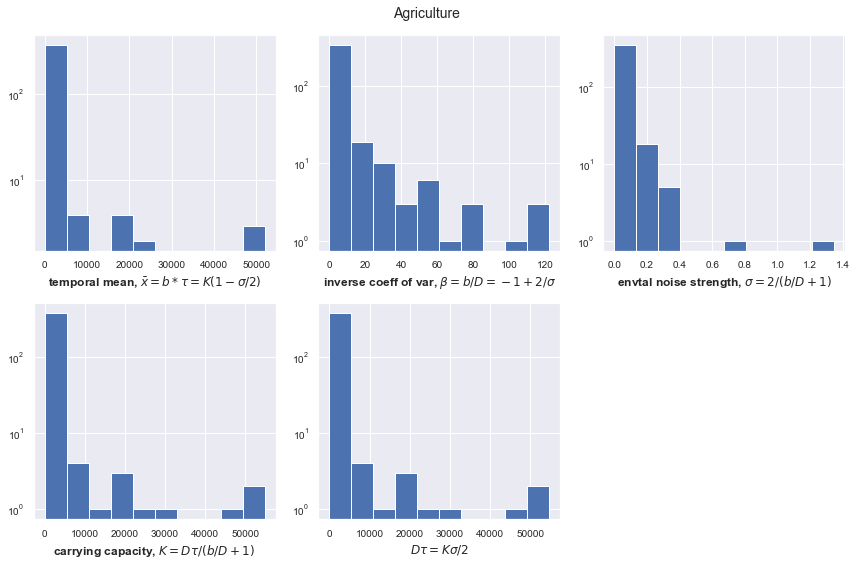

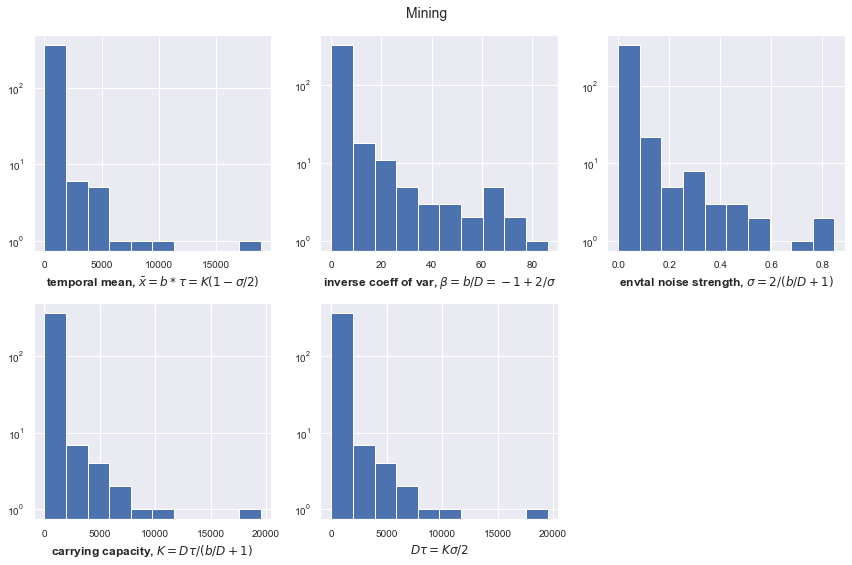

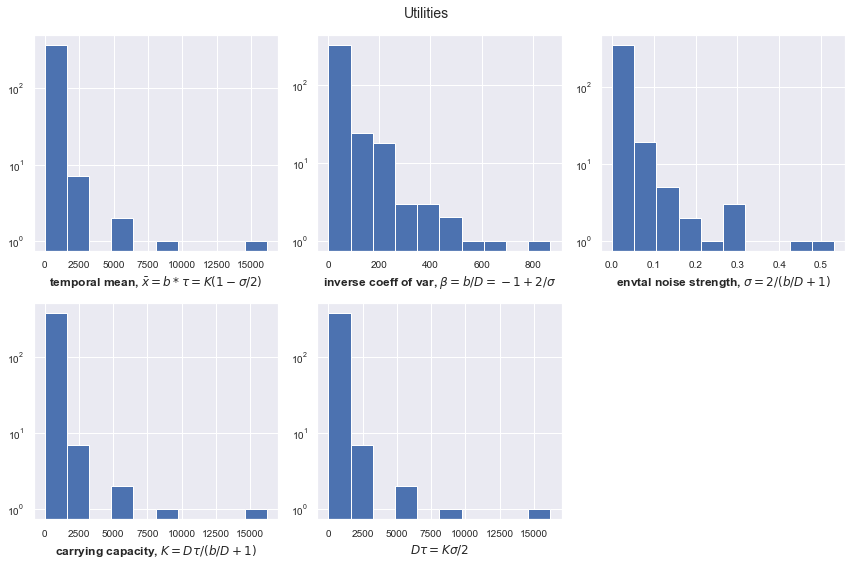

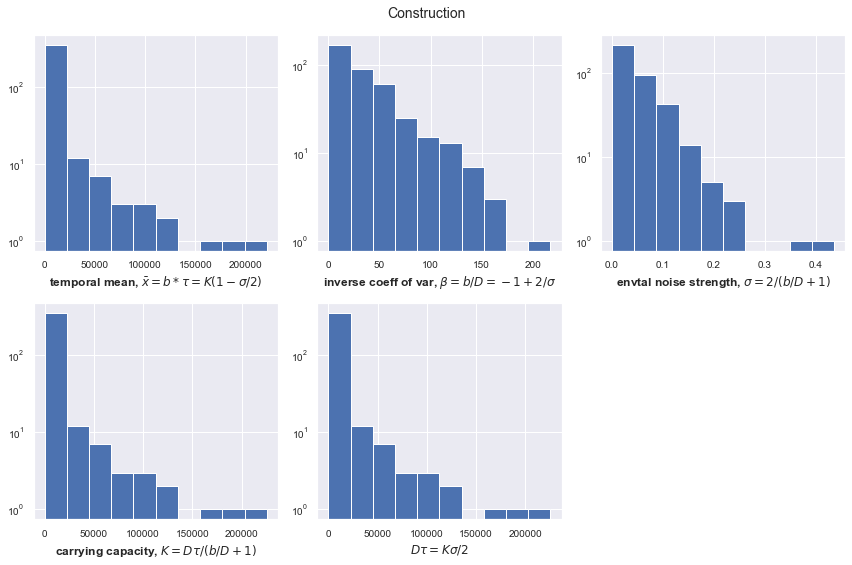

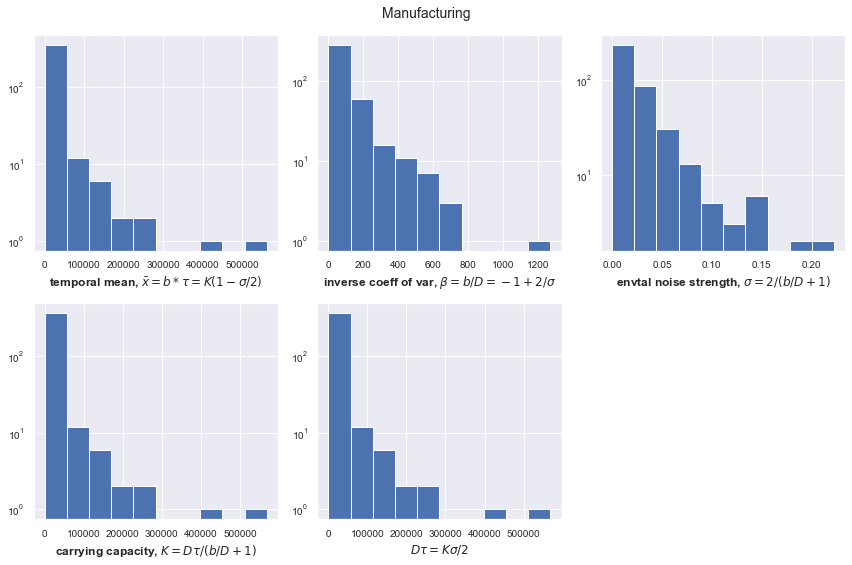

...

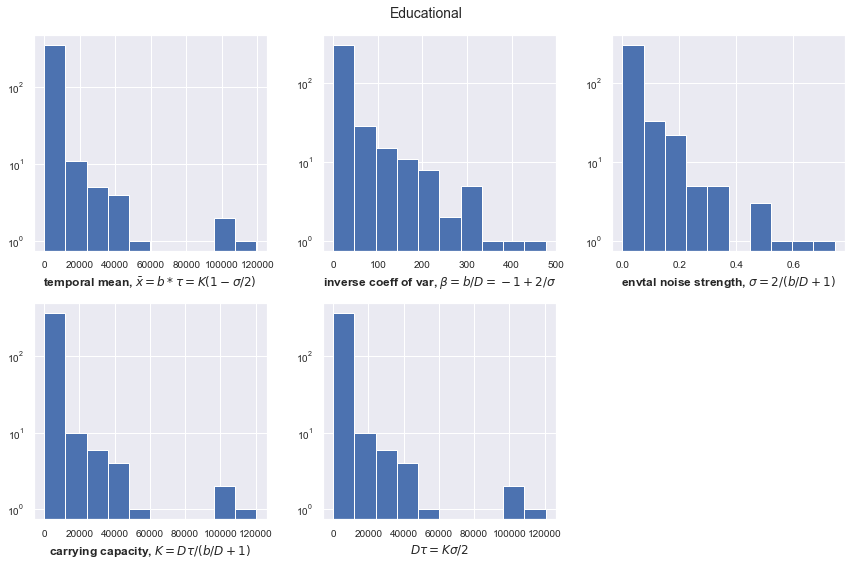

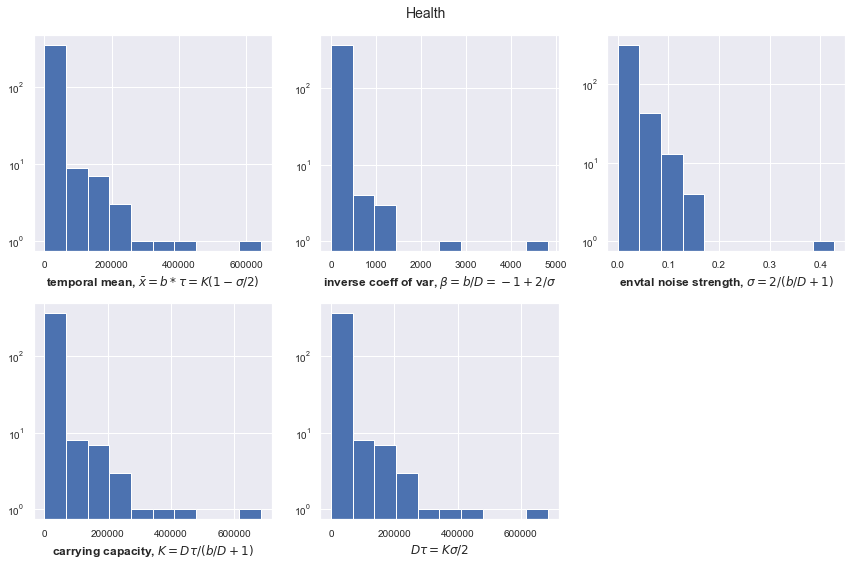

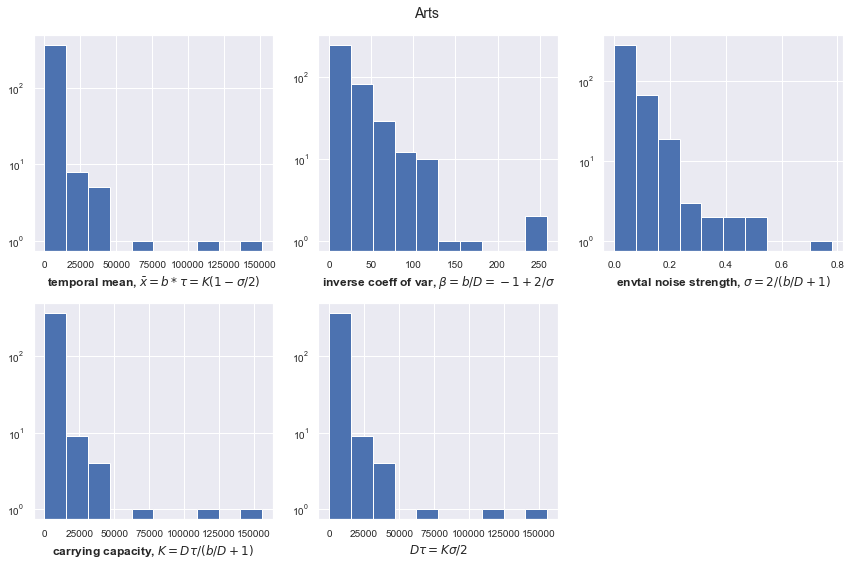

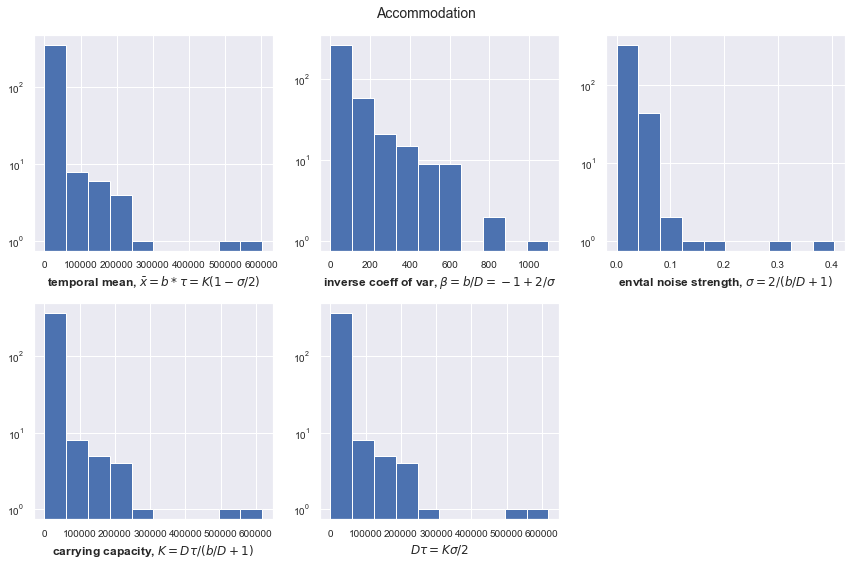

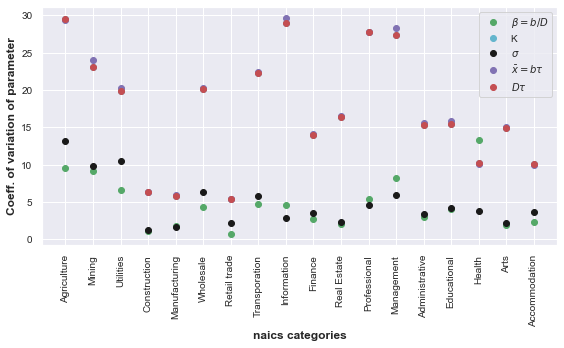

In [9]:
df_new=deepcopy(df_metro_fitted)
msas = df_new['msa'].values
n_msas = len(msas)

CV_sigma_list=[]
CV_xbar_list=[]
CV_beta_list=[]
CV_K_list=[]
CV_Dtau_list=[]
naics_name_list=[]
for nidx,naics in enumerate(naics_keys_to_plot): 
    fig = plt.figure(figsize=(12, 8))
    ax1 = fig.add_subplot(2,3,1)
    ax2 = fig.add_subplot(2,3,2)
    ax3 = fig.add_subplot(2,3,3)
    ax4 = fig.add_subplot(2,3,4)
    ax5 = fig.add_subplot(2,3,5)
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    naics_name_list.append(naics_name)
    
    temp=df_new[naics+'-fit_xbar'].values   
    CV_xbar_list.append(np.var(temp)/np.square(np.mean(temp)))
    ax1.hist(temp, log=True)
    ax1.set_xlabel(r'temporal mean, $\bar{x}=b*\tau=K(1-\sigma/2) $')
    
    temp=df_new[naics+'-fit_beta'].values   
    CV_beta_list.append(np.var(temp)/np.square(np.mean(temp)))
    ax2.hist(temp, log=True)
    ax2.set_xlabel(r'inverse coeff of var, $\beta = b/D = -1+2/\sigma$')
    
    temp=df_new[naics+'-fit_sigma'].values   
    CV_sigma_list.append(np.var(temp)/np.square(np.mean(temp)))
    ax3.hist(temp, log=True)
    ax3.set_xlabel(r'envtal noise strength, $\sigma = 2/(b/D+1)$')
    
    temp=df_new[naics+'-fit_K'].values   
    CV_K_list.append(np.var(temp)/np.square(np.mean(temp)))
    ax4.hist(temp, log=True)
    ax4.set_xlabel(r'carrying capacity, $K= D \tau / (b/D +1)$')
    
    
    Dtau=df_new[naics+'-fit_K'].values *df_new[naics+'-fit_sigma'].values  /2
    CV_Dtau_list.append(np.var(temp)/np.square(np.mean(temp)))
    ax5.hist(temp, log=True)
    ax5.set_xlabel(r'$D \tau = K \sigma/2$')
    

    
    
    plt.suptitle(naics_name)
    plt.tight_layout()
    plt.show()

fig2= plt.figure(figsize=(8, 5))
ax1 = fig2.add_subplot()
xvals=np.arange(len(CV_K_list))

ax1.plot(xvals, CV_beta_list,'go', label=r'$\beta =b/D$')
ax1.plot(xvals, CV_K_list,'co', label=r'K')
ax1.plot(xvals, CV_sigma_list,'ko', label=r'$\sigma$')
ax1.plot(xvals, CV_xbar_list,'mo', label=r'$\bar{x}=b \tau$')
ax1.plot(xvals, CV_Dtau_list,'ro', label=r'$D\tau$')
ax1.set_xticks(xvals)
ax1.set_xticklabels(naics_name_list,rotation=90 )

ax1.legend(loc='best')

ax1.set_xlabel('naics categories')
ax1.set_ylabel('Coeff. of variation of parameter')
plt.tight_layout()
plt.show()

### plot of rescaled MGFs

#### try 1 with definitions from df_metro_fitted only
Here $N_s$ is large and so  $e^{q n_i/N_S} \approx 1+ q n_i/N_s$ and so expression in Grilli can be used. 

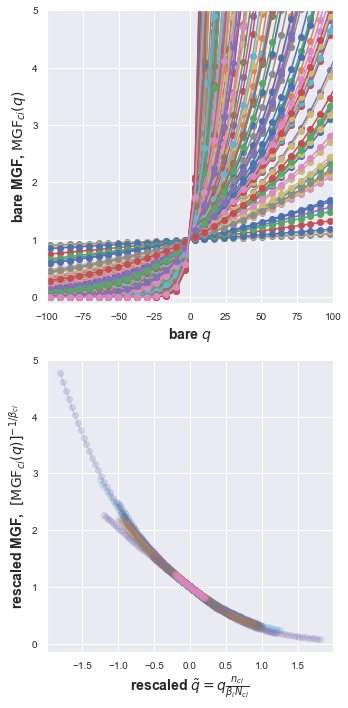

In [10]:
#
df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-300,300, 90)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)



for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
            ni_arr=emp_time=np.squeeze(df_sub[naics_time_keys].values)
            Ns_arr=np.squeeze(df_sub[tot_time_keys].values)
            betai=float(df_sub[naics+'-fit_beta'].values)
            MGF_q=[]
            MGF_q_rescaled=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai
            for q in q_array:
                mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr))
#                 #mgf_qval=np.mean(np.power(1.+q/Ns_arr,ni_arr))
#                 #mgf_qval=np.power(np.mean(np.power(1.+q/Ns_arr,ni_arr)),-1./betai)               
                MGF_q.append(float(mgf_qval))
                MGF_q_rescaled.append(float(np.power(mgf_qval,-1./betai)))
            ax1.plot(q_array,MGF_q,'-o')        
            qtilde_arr=q_array* np.mean(ni_arr)/ (betai *np.mean(Ns_arr))
            ax2.plot(qtilde_arr,MGF_q_rescaled,'-o', alpha=0.2)  
                        

            
    if msa_idx>15:
        break


# ax1.legend(loc='best')
ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare MGF, $\mathrm{MGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
ax1.set_xlim(-100,100)
ax1.set_ylim(-.1,5)
# ax2.set_xlim(-2,3)
# ax2.set_ylim(-.1,5)
ax2.set_xlabel(r'rescaled $\tilde{q}=q \frac{n_{ci}}{\beta_i N_{ci}} $',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled MGF,  $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

Plotting where the qtilde is uniformly sampled unlike before where only q was uniformly sampled\\
- using betai from fractions instead cos that makes sense
- MGF(q) looks straight because the range of q is much smaller than corresponding scale

skip_ctr= 440


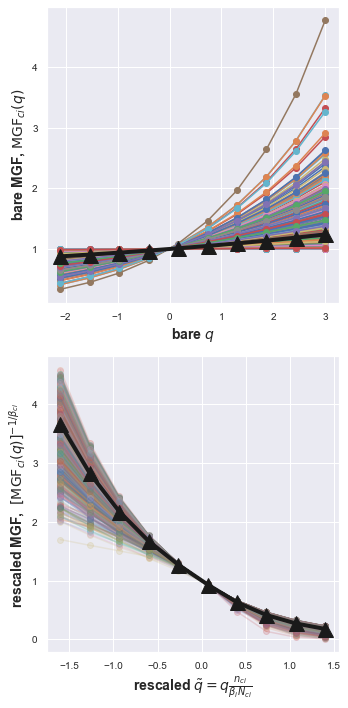

In [51]:
df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-300,300, 90)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)


skip_ctr=0

agg_MGF_rescaled=[]
agg_MGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
        df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
#         if np.all(df_sub[imputed_keys_time].values==False):
        if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            betai=np.longdouble(float(df_sub[naics+'-fit_beta'].values))
            betai_F=float(df_subF[naics+'-fit_beta'].values)
            betai=betai_F
            ### longdouble didn't really help very much
            MGF_q=[]
            MGF_q_rescaled=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai

            if betai>0:
                q_array1=np.linspace(-2.1,3, 10)
                for q in q_array1:
                    mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
                    MGF_q.append(float(mgf_qval))
                ax1.plot(q_array1,MGF_q,'-o')           
                agg_MGF.append(MGF_q)
                
                qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
                q_array2=np.longdouble(qtilde_arr*betai/ np.mean(ni_arr/Ns_arr) )
                np.seterr(all='warn')
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
                            mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
#                             MGF_q_rescaled.append(float(np.power(mgf_qval,-1./betai)))
#                             MGF_q_rescaled.append(float(np.power(mgf_qval,-1./betai)))
                            MGF_q_rescaled.append(np.power(mgf_qval,-1./betai))
                        ax2.plot(qtilde_arr,MGF_q_rescaled,'-o', alpha=0.2) 
                        agg_MGF_rescaled.append(MGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr+=1
    
#     if msa_idx>15:
#         break

print('skip_ctr=',skip_ctr)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare MGF, $\mathrm{MGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_xlim(-100,100)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \frac{n_{ci}}{\beta_i N_{ci}} $',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled MGF,  $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)

###plotting the average. 
ax1.plot(q_array1,np.mean(agg_MGF,axis=0),'k-^', lw=4,ms='15')
ax2.plot(qtilde_arr,np.mean(agg_MGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

logscaled

skip_ctr= 440


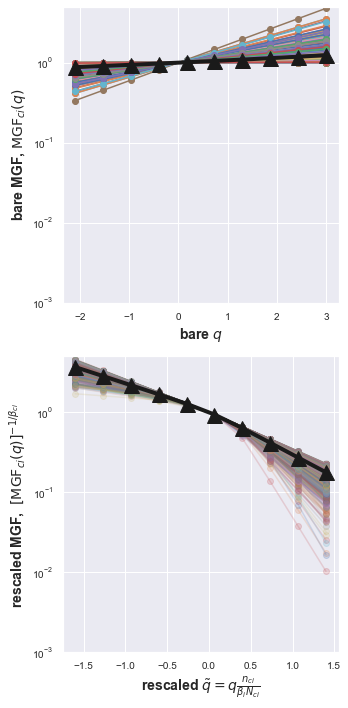

In [6]:
df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-300,300, 90)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)


skip_ctr=0

agg_MGF_rescaled=[]
agg_MGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
        df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
#         if np.all(df_sub[imputed_keys_time].values==False):
        if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            betai=np.longdouble(float(df_sub[naics+'-fit_beta'].values))
            betai_F=float(df_subF[naics+'-fit_beta'].values)
            betai=betai_F
            ### longdouble didn't really help very much
            MGF_q=[]
            MGF_q_rescaled=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai

            if betai>0:
                q_array1=np.linspace(-2.1,3, 10)
                for q in q_array1:
                    mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
                    MGF_q.append(float(mgf_qval))
                ax1.plot(q_array1,MGF_q,'-o')           
                agg_MGF.append(MGF_q)
                
                qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
                q_array2=np.longdouble(qtilde_arr*betai/ np.mean(ni_arr/Ns_arr) )
                np.seterr(all='warn')
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
                            mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
#                             MGF_q_rescaled.append(float(np.power(mgf_qval,-1./betai)))
#                             MGF_q_rescaled.append(float(np.power(mgf_qval,-1./betai)))
                            MGF_q_rescaled.append(np.power(mgf_qval,-1./betai))
                        ax2.plot(qtilde_arr,MGF_q_rescaled,'-o', alpha=0.2) 
                        agg_MGF_rescaled.append(MGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr+=1
    
#     if msa_idx>15:
#         break

print('skip_ctr=',skip_ctr)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare MGF, $\mathrm{MGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_xlim(-100,100)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \frac{n_{ci}}{\beta_i N_{ci}} $',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled MGF,  $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)

###plotting the average. 
ax1.plot(q_array1,np.mean(agg_MGF,axis=0),'k-^', lw=4,ms='15')
ax2.plot(qtilde_arr,np.mean(agg_MGF_rescaled,axis=0),'k-^', lw=4,ms='15')
ax1.set_ylim(.001,5)
ax1.set_yscale('log')

ax2.set_ylim(.001,5)
ax2.set_yscale('log')

fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

for other beta

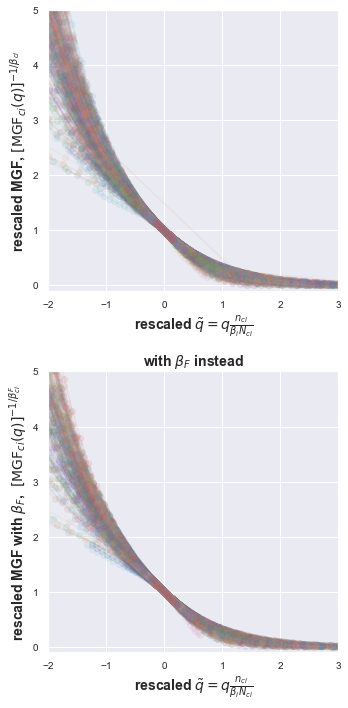

In [19]:
df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-500,500, 30)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)



for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
        df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.squeeze(df_sub[naics_time_keys].values)
            Ns_arr=np.squeeze(df_sub[tot_time_keys].values)
            betai=float(df_sub[naics+'-fit_beta'].values)
            
            betai_F=float(df_subF[naics+'-fit_beta'].values)
            MGF_q=[]
            MGF_q_betaF=[] ## qtilde =q times xbar/betai
            for q in q_array:
                mgf_qval=np.power(np.mean(np.power(1.+q/Ns_arr,ni_arr)),-1./betai)               
                MGF_q.append(float(mgf_qval))
                mgf_qval=np.power(np.mean(np.power(1.+q/Ns_arr,ni_arr)),-1./betai_F)               
                MGF_q_betaF.append(float(mgf_qval))
            
#             ax1.plot(q_array,MGF_q,'-o')

            qtilde_arr=q_array* np.mean(ni_arr)/ (betai *np.mean(Ns_arr))
            ax1.plot(qtilde_arr,MGF_q,'-o', alpha=0.1) 
            qtilde_arr2=q_array* np.mean(ni_arr)/ (betai_F *np.mean(Ns_arr))
            ax2.plot(qtilde_arr2,MGF_q_betaF,'-o', alpha=0.1) 


ax1.set_xlabel(r'rescaled $\tilde{q}=q \frac{n_{ci}}{\beta_i N_{ci}} $',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
ax2.set_title(r'with $\beta_F$ instead')
ax2.set_xlabel(r'rescaled $\tilde{q}=q \frac{n_{ci}}{\beta_i N_{ci}} $',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled MGF with $\beta_F$,  $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta^F_{ci}}$',fontsize=BIGGER_SIZE)

ax1.set_xlim(-2,3)
ax1.set_ylim(-.1,5)
ax2.set_xlim(-2,3)
ax2.set_ylim(-.1,5)

fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

#### try inverse plot MGF(qtilde) instead.

for this we need to probably use exp (qx) instead of 1+qx as the approximation for the exponential won't work

In [ ]:
df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
q_array=np.linspace(-3,1.5, 30)
# q_array=np.linspace(-500,500, 30)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

'''
this is not how to calculate the moment generating function of the data.
'''

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            ni_arr=emp_time=np.squeeze(df_sub[naics_time_keys].values)
            Ns_arr=np.squeeze(df_sub[tot_time_keys].values)
            betai=float(df_sub[naics+'-fit_beta'].values)
            MGF_q=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai
            for q in q_array:
                mgf_qval=np.power(np.mean(np.power(1.+q/Ns_arr,ni_arr)),-1./betai)               
                MGF_q.append(float(mgf_qval))
            ax1.plot(q_array,MGF_q,'-o')
            


            qtilde_arr=q_array* np.mean(ni_arr)/ (betai *np.mean(Ns_arr))
            qtilde_inv_arr=q_array*(betai *np.mean(Ns_arr))/ np.mean(ni_arr)
            
            for q in qtilde_inv_arr:
#                 mgf_qval=np.power(np.mean(np.power(1.+q/Ns_arr,ni_arr)),-1./betai)  
                    
                mgf_qval=np.power(np.mean(np.exp(q*ni_arr/Ns_arr)) ,-1./betai)  
                MGF_qtilde.append(float(mgf_qval))  
            ax2.plot(q_array,MGF_qtilde,'-o')     
            
#             ax2.plot(q_array,MGF_qtilde,'-o')## you have to plot against q, not q tilde.
            
    if msa_idx>15:
        break


# ax1.legend(loc='best')
ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax2.set_xlim(-4,4)
# ax2.set_ylim(-.1,7)
ax2.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)

ax2.set_ylabel(r'rescaled MGF of $\tilde{q}$ ,  $[\mathrm{MGF}_{ci}(\tilde{q})]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_title('rescaled log employment')
# for ax in [ax1]:/
#     ax.set_ylabel(r'MGF')        
#     ax.set_ylim(1e-6,10.)
#     ax.set_yscale('log')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

#### try 2 with defns from metroF_fitted

if we try from metroF_fitted, then the approximation for the expoentital, $e^{q n_i/N_S}$ as $1+ q n_i/N_s$ does not hold because $N_s=1$ 

Hence the MGF needs to be calculated by the sum of $e^{q n_i/N_S}$ over the data.

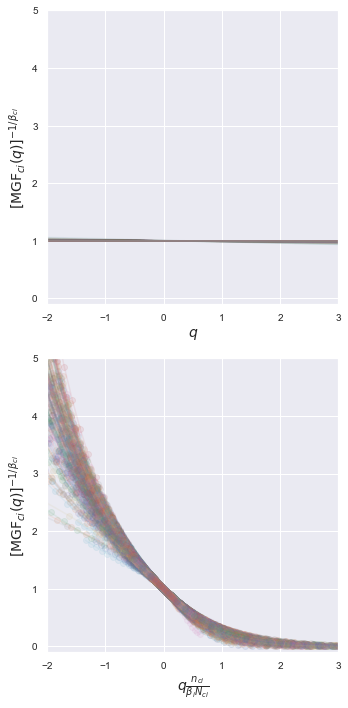

In [24]:
df_new=df_metroF_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-500,500, 30)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

'''
this is not how to calculate the moment generating function of the data.
'''

for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        if np.all(df_sub[imputed_keys_time].values==False):
            ni_arr=emp_time=np.squeeze(df_sub[naics_time_keys].values)
            Ns_arr=np.ones_like(ni_arr)### Ns is just 1 now!
            
            betai=float(df_sub[naics+'-fit_beta'].values)
            MGF_q=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai
            for q in q_array:
#                 mgf_qval=np.power(np.mean(np.power(1.+q/Ns_arr,ni_arr)),-1./betai) 
                #### use exponential directly as Ns is not large
                mgf_qval=np.power(np.mean(np.exp(q*ni_arr/Ns_arr)),-1./betai) 
                MGF_q.append(float(mgf_qval))
            ax1.plot(q_array,MGF_q,'-o',alpha=0.1)
            
#             qtilde_arr=q_array*betai/np.mean(ni_arr)
            
            qtilde_arr=q_array* np.mean(ni_arr)/ (betai *np.mean(Ns_arr))
            ax2.plot(qtilde_arr,MGF_q,'-o',alpha=0.1)  
            
            
#     if msa_idx>10:
#         break


# ax1.legend(loc='best')
ax1.set_xlabel(r'$q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'$[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)

ax2.set_xlabel(r'$q \frac{n_{ci}}{\beta_i N_{ci}} $',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'$[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)

ax1.set_xlim(-2,3)
ax1.set_ylim(-.1,5)
ax2.set_xlim(-2,3)
ax2.set_ylim(-.1,5)


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

In [18]:
scipy.stats.moment(emp_time,moment=3)

-5212327.33463033

## CGF collapse to test for gamma distribution
plotting rescaled CGF of ABSOLUTE abundance with MLE estimated parameters

For a gamma distribution,
$\mathrm{CGF}(q)=-k \log(1-\frac{q}{\theta})$

and so we plot
$\mathrm{CGF}_i(q)/k_i$ with respect to $\tilde{q}=q \theta_i$ for all trajectories and see if they all collapse onto the curve $-\log (1-\tilde{q})$

In [6]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_metro_fitted_MLE=shared_func.get_gamma_dist_params_MLE(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list)
df_metro_fitted_MLE=shared_func.get_gamma_dist_params(df_metro_fitted_MLE, naics_keys_to_plot, time_stamps_likeCBP_list)


skip_ctr= 309


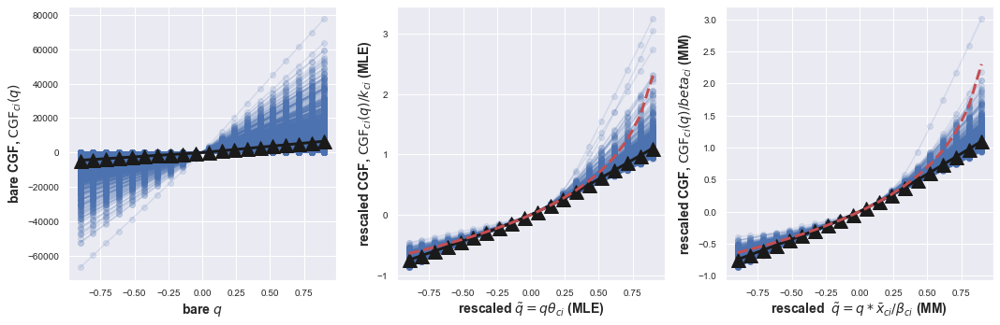

polyfit to avg CGF via MLE is:
 0.018 x^3 +  0.215 x^2 +  1.02 x +  0.013
polyfit to avg CGF via MM  is:
   0.018 x^3 +  0.213 x^2 +  1.01 x +  0.013


In [26]:

df_new=df_metro_fitted_MLE
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-300,300, 90)
fig = plt.figure(figsize=(15, 5))
ax1 = fig.add_subplot(1,3,1)
ax2 = fig.add_subplot(1,3,2)
ax3 = fig.add_subplot(1,3,3)




skip_ctr=0

agg_MGF_rescaled=[]
agg_MGF=[]
agg_CGF_rescaled_MM=[]
agg_CGF=[]
agg_CGF_rescaled_MLE=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_scale_MLE'].values))
            ki=np.longdouble(float(df_sub[naics+'-fit_shape_MLE'].values))
            betai=np.longdouble(float(df_sub[naics+'-fit_beta'].values))
            xbari=np.longdouble(float(df_sub[naics+'-fit_xbar'].values))
#             betai_F=float(df_subF[naics+'-fit_beta'].values)
#             betai=betai_F
            ### longdouble didn't really help very much
            MGF_q=[]
            MGF_q_rescaled=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai
            
            CGF_q=[]
            
#             CGF_qtilde=[] ## qtilde =q times xbar/betai

            if thetai>0 and betai>0:
                q_array1=np.longdouble(np.linspace(-.9,.9, 20,dtype='g'))
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
                qtilde_arr=np.longdouble(np.linspace(-.9,.9, 20,dtype='g'))
#                 q_array2=np.longdouble(qtilde_arr*betai/ np.mean(ni_arr/Ns_arr) )               
                q_array2=np.longdouble(qtilde_arr/ thetai )
                q_array3=np.longdouble(qtilde_arr*betai/ xbari )  
                np.seterr(all='warn')
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array1:

                            cgf_qval=scipy.special.logsumexp(q*ni_arr)-np.log(len(ni_arr))

                            CGF_q.append(float(cgf_qval))
                        ax1.plot(q_array1,CGF_q,'b-o', alpha=0.15)           
                        agg_CGF.append(CGF_q)
                        
                        
                        CGF_q_rescaled=[]
                        for q in q_array2:                
#                             mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
                            cgf_qval=scipy.special.logsumexp(q*ni_arr)-np.log(len(ni_arr))
#                             MGF_q_rescaled.append(np.power(mgf_qval,-1./ki))
                            CGF_q_rescaled.append(cgf_qval/ki)  
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'b-o', alpha=0.15) 
                        agg_CGF_rescaled_MLE.append(CGF_q_rescaled)
                        CGF_q_rescaled=[]
                        for q in q_array3:                
                            cgf_qval=scipy.special.logsumexp(q*ni_arr)-np.log(len(ni_arr))
                            CGF_q_rescaled.append(cgf_qval/betai)  
                        ax3.plot(qtilde_arr,CGF_q_rescaled,'b-o', alpha=0.15) 
                        agg_CGF_rescaled_MM.append(CGF_q_rescaled)
            
#                         print( scipy.special.logsumexp(0*ni_arr)-np.log(len(ni_arr)))
            
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr+=1
    
#     if msa_idx>10:
#         break

print('skip_ctr=',skip_ctr)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_{ci} $ (MLE)',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF, $\mathrm{CGF}_{ci}(q)/ k_{ci}$ (MLE)',fontsize=BIGGER_SIZE)

ax3.set_xlabel(r'rescaled  $\tilde{q}=q *\bar{x}_{ci}/ \beta_{ci} $ (MM)',fontsize=BIGGER_SIZE)
ax3.set_ylabel(r'rescaled CGF, $\mathrm{CGF}_{ci}(q)/beta_{ci}$ (MM)',fontsize=BIGGER_SIZE)


###plotting the average. 
ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=3,ms='15')
ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled_MLE,axis=0),'k-^', lw=3,ms='15')
ax2.plot(qtilde_arr,-np.log(1-qtilde_arr),'r--', lw=3)
ax3.plot(qtilde_arr,np.mean(agg_CGF_rescaled_MM,axis=0),'k-^', lw=3,ms='15')
ax3.plot(qtilde_arr,-np.log(1-qtilde_arr),'r--', lw=3)


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

coefs1=np.polyfit(qtilde_arr.astype(float),np.mean(agg_CGF_rescaled_MLE,axis=0).astype(float),3)

print('polyfit to avg CGF via MLE is:\n', '{:.3f}'.format(coefs1[0]), 
      'x^3 + ','{:.3f}'.format(coefs1[1]),'x^2 + ','{:.3}'.format(coefs1[2]),
      'x + ', '{:.3f}'.format(coefs1[3]) )


coefs1=np.polyfit(qtilde_arr.astype(float),np.mean(agg_CGF_rescaled_MM,axis=0).astype(float),3)

print('polyfit to avg CGF via MM  is:\n  ', '{:.3f}'.format(coefs1[0]), 
      'x^3 + ','{:.3f}'.format(coefs1[1]),'x^2 + ','{:.3}'.format(coefs1[2]),
      'x + ', '{:.3f}'.format(coefs1[3]) )

In [23]:
np.mean(agg_CGF_rescaled_MLE,axis=0)

array([-7.61884027e-01, -5.80824974e-01, -3.96954382e-01, -2.07008146e-01,
        6.90552059e-18,  2.46986293e-01,  5.16754158e-01,  7.94633350e-01,
        1.07632016e+00], dtype=float128)

In [24]:
qtilde_arr

array([-0.9  , -0.675, -0.45 , -0.225,  0.   ,  0.225,  0.45 ,  0.675,
        0.9  ], dtype=float128)

In [8]:
a= np.arange(10)
coefs1=np.polyfit(a,a+4, 3)

In [15]:
print('polyfit to black line is:\n  ', '{:.3f}'.format(coefs1[0]), 
      'x^3 + ','{:.3f}'.format(coefs1[1]),'x^2 + ','{:.3}'.format(coefs1[2]),
      'x + ', '{:.3f}'.format(coefs1[3]) )

polyfit to black line is:
   0.00 x^3 +  -0.00 x^2 +  1.00 x +  4.00


### for shape fixed by log  distribution

now repeat after inferring gamma assuming shape parameter are shared across cities for a given sector

In [43]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_fitvals = pickle.load(handle)  
shape_param_list=[]
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    shape_param_list.append(logG_fitvals['NeutralTheory'][idx][1])
    
df_metro_fitted_MLE_1=shared_func.get_gamma_dist_params_MLE(df_metro_time, naics_keys_to_plot,
                                                            time_stamps_likeCBP_list,
                                                           fix_shape=shape_param_list)


/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/special/_logsumexp.py:110: RuntimeWarning: underflow encountered in exp
  tmp = np.exp(a - a_max)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/special/_logsumexp.py:110: RuntimeWarning: underflow encountered in exp
  tmp = np.exp(a - a_max)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/special/_logsumexp.py:110: RuntimeWarning: underflow encountered in exp
  tmp = np.exp(a - a_max)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/special/_logsumexp.py:110: RuntimeWarning: underflow encountered in exp
  tmp = np.exp(a - a_max)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/special/_logsumexp.py:110: RuntimeWarning: underflow encountered in exp
  tmp = np.exp(a - a_max)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/special/_logsumexp.py:110: RuntimeWarning: underflow encountered in exp
  tmp = np.exp(a -

skip_ctr= 0


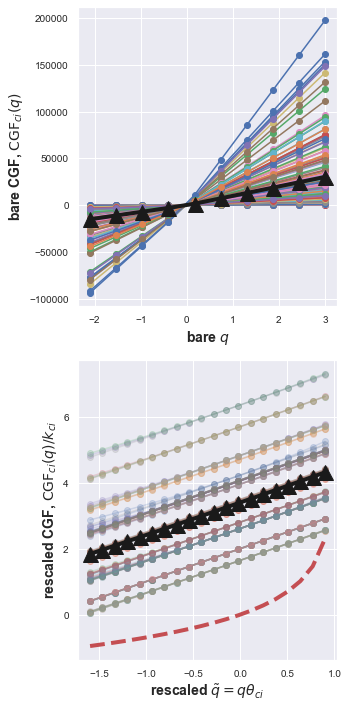

In [44]:

df_new=df_metro_fitted_MLE_1
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-300,300, 90)
fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)


skip_ctr=0

agg_MGF_rescaled=[]
agg_MGF=[]
agg_CGF_rescaled=[]
agg_CGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_scale_MLE'].values))
            ki=np.longdouble(float(df_sub[naics+'-fit_shape_MLE'].values))
#             betai_F=float(df_subF[naics+'-fit_beta'].values)
#             betai=betai_F
            ### longdouble didn't really help very much
            MGF_q=[]
            MGF_q_rescaled=[]
            MGF_qtilde=[] ## qtilde =q times xbar/betai
            
            CGF_q=[]
            CGF_q_rescaled=[]
            CGF_qtilde=[] ## qtilde =q times xbar/betai

            if thetai>0:
                q_array1=np.linspace(-2.1,3, 10)
                for q in q_array1:
#                     mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
                    cgf_qval=scipy.special.logsumexp(q*ni_arr)
                    CGF_q.append(float(cgf_qval))
                ax1.plot(q_array1,CGF_q,'-o')           
                agg_CGF.append(CGF_q)
                
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
                qtilde_arr=np.longdouble(np.linspace(-1.6,.9, 20,dtype='g'))
#                 q_array2=np.longdouble(qtilde_arr*betai/ np.mean(ni_arr/Ns_arr) )               
                q_array2=np.longdouble(qtilde_arr/ thetai )
                np.seterr(all='warn')
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
#                             mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
                            cgf_qval=scipy.special.logsumexp(q*ni_arr)

#                             MGF_q_rescaled.append(np.power(mgf_qval,-1./ki))
                            CGF_q_rescaled.append(cgf_qval/ki)
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'-o', alpha=0.2) 
                        agg_CGF_rescaled.append(CGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr+=1
    
    if msa_idx>15:
        break

print('skip_ctr=',skip_ctr)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_{ci} $',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF, $\mathrm{CGF}_{ci}(q)/ k_{ci}$',fontsize=BIGGER_SIZE)

###plotting the average. 
ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')
ax2.plot(qtilde_arr,-np.log(1-qtilde_arr),'r--', lw=4)


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

In [21]:
scipy.special.logsumexp(q*ni_arr)

403.13395769472950153

### for fractions instead of absolute abundances

In [36]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_metroF_fitted_MLE=shared_func.get_gamma_dist_params_MLE(df_metroF_time, naics_keys_to_plot, time_stamps_likeCBP_list)
df_metroF_fitted_MLE=shared_func.get_gamma_dist_params(df_metroF_fitted_MLE, naics_keys_to_plot, time_stamps_likeCBP_list)


skip_ctr= 0


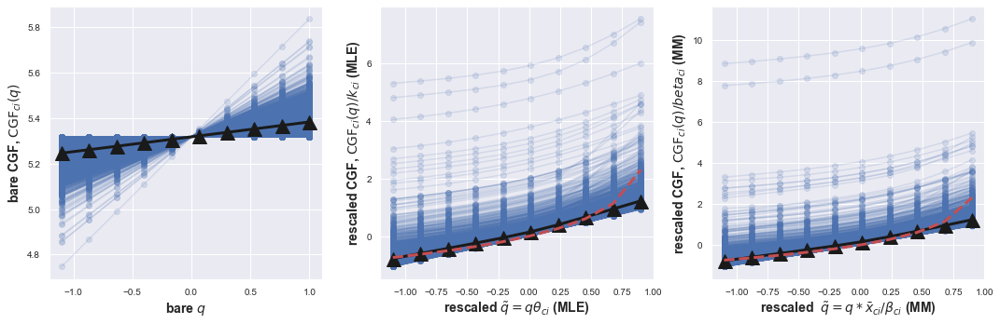

In [37]:

df_new=df_metroF_fitted_MLE
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array=np.linspace(-300,300, 90)
fig = plt.figure(figsize=(15, 5))
ax1 = fig.add_subplot(1,3,1)
ax2 = fig.add_subplot(1,3,2)
ax3 = fig.add_subplot(1,3,3)




skip_ctr=0

agg_MGF_rescaled=[]
agg_MGF=[]
agg_CGF_rescaled_MM=[]
agg_CGF=[]
agg_CGF_rescaled_MLE=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_scale_MLE'].values))
            ki=np.longdouble(float(df_sub[naics+'-fit_shape_MLE'].values))
            betai=np.longdouble(float(df_sub[naics+'-fit_beta'].values))
            xbari=np.longdouble(float(df_sub[naics+'-fit_xbar'].values))

            ### longdouble didn't really help very much

            
            CGF_q=[]
            
#             CGF_qtilde=[] ## qtilde =q times xbar/betai

            if thetai>0 and betai>0:
                q_array1=np.linspace(-1.1,1, 10)
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
                qtilde_arr=np.longdouble(np.linspace(-1.1,.9, 10,dtype='g'))
#                 q_array2=np.longdouble(qtilde_arr*betai/ np.mean(ni_arr/Ns_arr) )               
                q_array2=np.longdouble(qtilde_arr/ thetai )
                q_array3=np.longdouble(qtilde_arr*betai/ xbari )  
                np.seterr(all='warn')
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array1:

                            cgf_qval=scipy.special.logsumexp(q*ni_arr)

                            CGF_q.append(float(cgf_qval))
                        ax1.plot(q_array1,CGF_q,'b-o', alpha=0.15)           
                        agg_CGF.append(CGF_q)
                        
                        
                        CGF_q_rescaled=[]
                        for q in q_array2:                
#                             mgf_qval=np.mean(np.exp(q*ni_arr/Ns_arr)) 
                            cgf_qval=scipy.special.logsumexp(q*ni_arr)
#                             MGF_q_rescaled.append(np.power(mgf_qval,-1./ki))
                            CGF_q_rescaled.append(cgf_qval/ki)  
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'b-o', alpha=0.15) 
                        agg_CGF_rescaled_MLE.append(CGF_q_rescaled)
                        CGF_q_rescaled=[]
                        for q in q_array3:                
                            cgf_qval=scipy.special.logsumexp(q*ni_arr)
                            CGF_q_rescaled.append(cgf_qval/betai)  
                        ax3.plot(qtilde_arr,CGF_q_rescaled,'b-o', alpha=0.15) 
                        agg_CGF_rescaled_MM.append(CGF_q_rescaled)
            
            
            
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr+=1
    
#     if msa_idx>10:
#         break

print('skip_ctr=',skip_ctr)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled MGF, $[\mathrm{MGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_{ci} $ (MLE)',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF, $\mathrm{CGF}_{ci}(q)/ k_{ci}$ (MLE)',fontsize=BIGGER_SIZE)

ax3.set_xlabel(r'rescaled  $\tilde{q}=q *\bar{x}_{ci}/ \beta_{ci} $ (MM)',fontsize=BIGGER_SIZE)
ax3.set_ylabel(r'rescaled CGF, $\mathrm{CGF}_{ci}(q)/beta_{ci}$ (MM)',fontsize=BIGGER_SIZE)


###plotting the average. 
ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=3,ms='15')
ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled_MLE,axis=0),'k-^', lw=3,ms='15')
ax2.plot(qtilde_arr,-np.log(1-qtilde_arr),'r--', lw=3)
ax3.plot(qtilde_arr,np.mean(agg_CGF_rescaled_MM,axis=0),'k-^', lw=3,ms='15')
ax3.plot(qtilde_arr,-np.log(1-qtilde_arr),'r--', lw=3)


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

## fit AFD using b/d from log_g fit

### get fit parameters for log growth and save results



In [66]:
## does not need to be run every time,results are saved.
##function is shared with the plot fit by naics (plotted below)
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fit_vals_dict=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metro_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,tau=Delta_t,
                                                remove_imputed_values=True,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                               return_fit_vals=True,
                                                suppress_plots=True)

with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(fit_vals_dict, handle)


t/tau=  4.14e-03 ;  b/d=  1.26e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.05e-02 ;  b/d=  1.13e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.90e-04 ;  b/d=  9.33e-01 loc & scale are fixed= 0.0 1.0
t/tau=  5.58e-03 ;  b/d=  2.04e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.03e-03 ;  b/d=  1.31e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.48e-03 ;  b/d=  1.56e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.38e-04 ;  b/d=  2.66e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.65e-03 ;  b/d=  1.52e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.12e-03 ;  b/d=  1.31e+00 loc & scale are fixed= 0.0 1.0
t/tau=  7.36e-04 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.66e-03 ;  b/d=  1.90e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.90e-03 ;  b/d=  1.66e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.55e-03 ;  b/d=  8.36e-01 loc & scale are fixed= 0.0 1.0
t/tau=  4.35e-03 ;  b/d=  1.54e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.94e-03 ;  b/d=  1.10e+00 loc & scale are fixed= 0.0 1.0
t/tau=  9.

### fit gamma to AFD with and without fixed params

In [5]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
df_gamma_fitted_2freeparams=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list)

Delta_t=12
with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_fitvals = pickle.load(handle)
    
shape_param_list=[]
tau_param_list=[]
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    shape_param_list.append(logG_fitvals['NeutralTheory'][idx][1])
    tau_param_list.append(logG_fitvals['NeutralTheory'][idx][0])
df_gamma_fitted_shapeFixed=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
    shape_fixed=np.array(shape_param_list))

nparams= 2
nparams= 1


In [21]:
logG_fitvals['NeutralTheory'][idx]

array([1.96529230e-03, 3.23066367e+00, 0.00000000e+00, 1.00000000e+00])

### compare fits by gamma

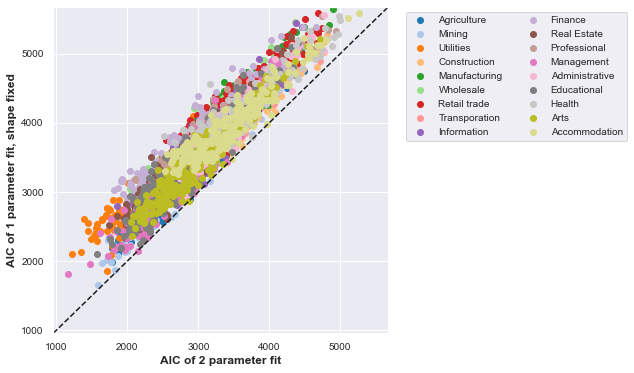

In [157]:
ctr=0
color_list=list(sns.color_palette(palette='tab20'))
fig=plt.figure(figsize=(6,6))
ax1=fig.add_subplot()
for nidx,naics in enumerate(naics_keys_to_plot):
    xvals=df_gamma_fitted_2freeparams[naics+'-fit_AIC'].values
    yvals=df_gamma_fitted_shapeFixed[naics+'-fit_AIC'].values
    
    idx_nonzero=np.nonzero(xvals)
    assert np.array_equal(idx_nonzero,np.nonzero(yvals)), 'both must be nonzero when fitted'
    ax1.scatter(xvals[idx_nonzero],yvals[idx_nonzero],color=color_list[nidx],
                label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    ctr+=1
#     if ctr>4:
#         break
axmin=min(ax1.get_xlim()[0], ax1.get_ylim()[0])
axmax=min(ax1.get_xlim()[1], ax1.get_ylim()[1])
ax1.set_xlim(axmin,axmax)
ax1.set_ylim(axmin,axmax)
ax1.plot([axmin,axmax],[axmin,axmax],'k--')
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)
ax1.set_xlabel('AIC of 2 parameter fit')
ax1.set_ylabel('AIC of 1 parameter fit, shape fixed')
plt.show()

##### AIC when gamma fit on  yearly samples instead of monthly
2 parameter fit is still superior

nparams= 2
nparams= 1


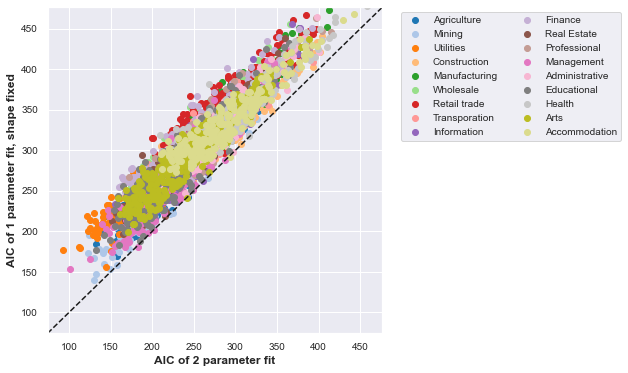

In [7]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

time_stamps_yearly=time_stamps_likeCBP_list[4::12] ## time stamps a year apart only

df_gamma_fitted_2freeparams_yearly=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_yearly)

Delta_t=12
with open(fit_params_path+'log_growth_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_fitvals = pickle.load(handle)
    
shape_param_list=[]
tau_param_list=[]
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    shape_param_list.append(logG_fitvals['NeutralTheory'][idx][1])
    tau_param_list.append(logG_fitvals['NeutralTheory'][idx][0])
df_gamma_fitted_shapeFixed_yearly=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_yearly,
    shape_fixed=np.array(shape_param_list))


ctr=0
color_list=list(sns.color_palette(palette='tab20'))
fig=plt.figure(figsize=(6,6))
ax1=fig.add_subplot()
for nidx,naics in enumerate(naics_keys_to_plot):
    xvals=df_gamma_fitted_2freeparams_yearly[naics+'-fit_AIC'].values
    yvals=df_gamma_fitted_shapeFixed_yearly[naics+'-fit_AIC'].values
    
    idx_nonzero=np.nonzero(xvals)
    assert np.array_equal(idx_nonzero,np.nonzero(yvals)), 'both must be nonzero when fitted'
    ax1.scatter(xvals[idx_nonzero],yvals[idx_nonzero],color=color_list[nidx],
                label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    ctr+=1
#     if ctr>4:
#         break
axmin=min(ax1.get_xlim()[0], ax1.get_ylim()[0])
axmax=min(ax1.get_xlim()[1], ax1.get_ylim()[1])
ax1.set_xlim(axmin,axmax)
ax1.set_ylim(axmin,axmax)
ax1.plot([axmin,axmax],[axmin,axmax],'k--')
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)
ax1.set_xlabel('AIC of 2 parameter fit')
ax1.set_ylabel('AIC of 1 parameter fit, shape fixed')
plt.show()

In [6]:
time_stamps_likeCBP_list[4::12]

['03-Q2-M2',
 '04-Q2-M2',
 '05-Q2-M2',
 '06-Q2-M2',
 '07-Q2-M2',
 '08-Q2-M2',
 '09-Q2-M2',
 '10-Q2-M2',
 '11-Q2-M2',
 '12-Q2-M2',
 '13-Q2-M2',
 '14-Q2-M2',
 '15-Q2-M2',
 '16-Q2-M2',
 '17-Q2-M2',
 '18-Q2-M2',
 '19-Q2-M2']

### plot inferred b and D vs total city size

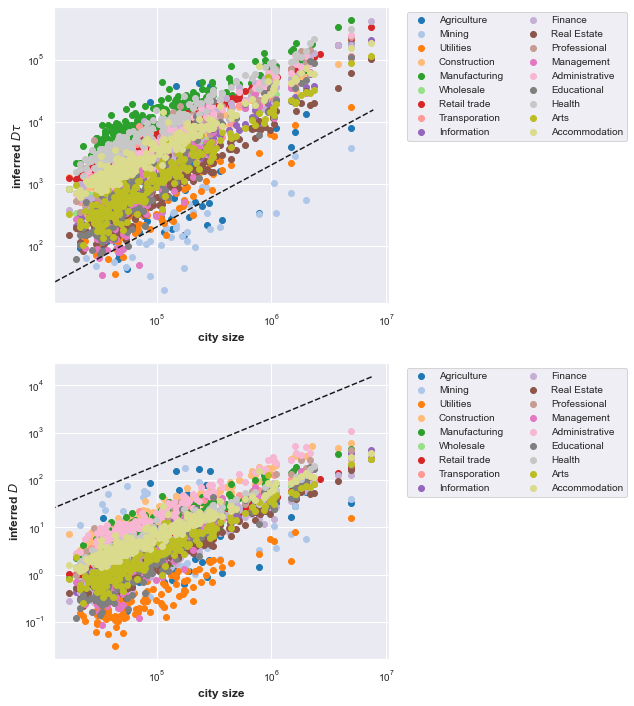

In [12]:
ctr=0
color_list=list(sns.color_palette(palette='tab20'))
fig=plt.figure(figsize=(6,12))
ax1=fig.add_subplot(2,1,1)
ax2=fig.add_subplot(2,1,2)
tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
avg_total_emp=np.mean(df_gamma_fitted_shapeFixed[tot_time_keys].values,axis=1)
for nidx,naics in enumerate(naics_keys_to_plot):
#     Dtau=df_gamma_fitted_2freeparams[naics+'-fit_scale_theta'].values
    Dtau=df_gamma_fitted_shapeFixed[naics+'-fit_scale_theta'].values   
    idx_nonzero=np.nonzero(Dtau)
    
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_fitvals['naics'])==naics_code)[0][0]
    temp=logG_fitvals['NeutralTheory'][idx]
    tau_fit=1./logG_fitvals['NeutralTheory'][idx][0] ## t/tau is actually fit
      
    ax1.scatter(avg_total_emp[idx_nonzero],Dtau[idx_nonzero],color=color_list[nidx],
                label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    ax2.scatter(avg_total_emp[idx_nonzero],Dtau[idx_nonzero]/tau_fit,color=color_list[nidx],
                label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    
    
    
    
    ctr+=1
#     if ctr>4:
#         break

# ax1.set_xlim(axmin,axmax)
# ax1.set_ylim(axmin,axmax)
for ax in [ax1,ax2]:
    axmin=min(ax.get_xlim()[0], ax.get_ylim()[0])
    axmax=max(ax.get_xlim()[1], ax.get_ylim()[1])
    ax.plot(np.array([axmin,axmax]),np.array([axmin,axmax])*.002,'k--')
    ax.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlabel('city size')
ax1.set_ylabel(r'inferred $D \tau$')
ax2.set_ylabel(r'inferred $D$')
plt.show()

In [5]:
df_gamma_fitted_shapeFixed.keys()

Index(['msa', 'msa_name', 'FIPS', 'naics_10-Y03-Q1-M1', 'naics_11-Y03-Q1-M1',
       'naics_21-Y03-Q1-M1', 'naics_22-Y03-Q1-M1', 'naics_23-Y03-Q1-M1',
       'naics_31-33-Y03-Q1-M1', 'naics_42-Y03-Q1-M1',
       ...
       'naics_61-fit_AIC', 'naics_62-fit_shape_k', 'naics_62-fit_scale_theta',
       'naics_62-fit_AIC', 'naics_71-fit_shape_k', 'naics_71-fit_scale_theta',
       'naics_71-fit_AIC', 'naics_72-fit_shape_k', 'naics_72-fit_scale_theta',
       'naics_72-fit_AIC'],
      dtype='object', length=16513)

In [7]:
tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]

In [13]:
np.shape(np.mean(df_gamma_fitted_shapeFixed[tot_time_keys].values,axis=1))

(383,)

### fit negative binomial to AFD

## fit AFD using different distributions
gaussian did just as well (or poorly) as gamma. monthly and yearly sampling for AFD did not make a difference.

In [21]:
def get_gaussian_dist_params(df_metro_time, naics_keys_to_plot, time_stamps):     
    df_new=deepcopy(df_metro_time)
    msas = df_new['msa'].values
    n_msas = len(msas)
    for nidx,naics in enumerate(naics_keys_to_plot): 
        df_new[naics+'-fit_gauss_mu']=0
        df_new[naics+'-fit_gauss_sigma']=0
        df_new[naics+'-fit_gauss_AIC']=0
    for msa_idx,msa in enumerate(msas):
        for nidx,naics in enumerate(naics_keys_to_plot):                     
            df_sub=df_new[df_new['msa']==msa]
            naics_time_keys=[naics+'-Y'+ t for t in time_stamps]
            imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps]
            if np.all(df_sub[imputed_keys_time].values==False):
                emp_time=df_sub[naics_time_keys].values
                mu, sigma=scipy.stats.norm.fit(
                            np.ravel(emp_time), loc=np.mean(emp_time),scale=np.var(emp_time) )
                n_params=2               
                logLik = np.sum( stats.norm.logpdf(emp_time,loc=mu,scale= sigma ) ) 
                AIC=2*n_params-2*logLik
                if msa_idx==0 and nidx==0: print ('nparams=', n_params)
                df_new.loc[msa_idx, naics+'-fit_gauss_mu']=mu
                df_new.loc[msa_idx, naics+'-fit_gauss_sigma']=sigma
                df_new.loc[msa_idx, naics+'-fit_gauss_AIC']=AIC
    
    return df_new



def get_lognormal_dist_params(df_metro_time, naics_keys_to_plot, time_stamps):     
    df_new=deepcopy(df_metro_time)
    msas = df_new['msa'].values
    n_msas = len(msas)
    for nidx,naics in enumerate(naics_keys_to_plot): 
        df_new[naics+'-fit_lognorm_shape']=0
        df_new[naics+'-fit_lognorm_scale']=0
        df_new[naics+'-fit_lognorm_loc']=0
        df_new[naics+'-fit_lognorm_AIC']=0
    for msa_idx,msa in enumerate(msas):
        for nidx,naics in enumerate(naics_keys_to_plot):                     
            df_sub=df_new[df_new['msa']==msa]
            naics_time_keys=[naics+'-Y'+ t for t in time_stamps]
            imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps]
            if np.all(df_sub[imputed_keys_time].values==False):
                emp_time=df_sub[naics_time_keys].values

#                 sfit, locfit, scalefit=scipy.stats.lognorm.fit(np.ravel(emp_time) )
                
                sfit, locfit, scalefit=scipy.stats.lognorm.fit(np.ravel(emp_time),floc=0. )
                n_params=2              
                logLik = np.sum( stats.lognorm.logpdf(emp_time,sfit,
                                                   loc=locfit,scale= scalefit ) ) 
                AIC=2*n_params-2*logLik
                if msa_idx==0 and nidx==0: print ('nparams=', n_params)
                df_new.loc[msa_idx, naics+'-fit_lognorm_shape']=sfit
                df_new.loc[msa_idx, naics+'-fit_lognorm_scale']=scalefit
                df_new.loc[msa_idx, naics+'-fit_lognorm_loc']=locfit
                df_new.loc[msa_idx, naics+'-fit_lognorm_AIC']=AIC
    
    return df_new


In [22]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

# time_stamps_yearly=time_stamps_likeCBP_list[3::12]## monthly time intervals didn't make a difference
df_gamma_fit=get_gamma_dist_params_constrained(
    df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list)

df_gaussian_fit=get_gaussian_dist_params(df_metro_time, naics_keys_to_plot,
                                         time_stamps_likeCBP_list)

df_lognormal_fit=get_lognormal_dist_params(df_metro_time, naics_keys_to_plot,
                                         time_stamps_likeCBP_list)

nparams= 2
nparams= 2
nparams= 2


##### gaussian vs gamma

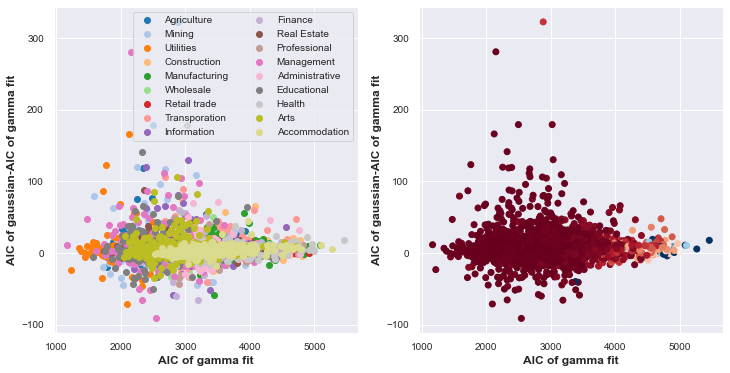

5.421825026519327


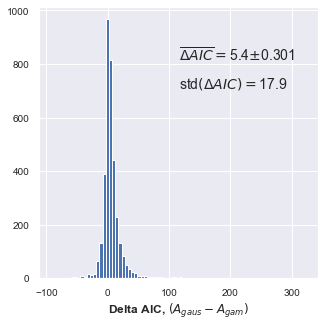

In [23]:
ctr=0
color_list=list(sns.color_palette(palette='tab20'))

delta_AIC=[]
fig=plt.figure(figsize=(12,6))
ax1=fig.add_subplot(1,2,1)
ax2=fig.add_subplot(1,2,2)
for nidx,naics in enumerate(naics_keys_to_plot):
    xvals=df_gamma_fit[naics+'-fit_AIC'].values
    yvals=df_gaussian_fit[naics+'-fit_gauss_AIC'].values
    zvals=df_gamma_fit['naics_10-Y03-Q1-M1'].values
    idx_nonzero=np.nonzero(xvals)
    assert np.array_equal(idx_nonzero,np.nonzero(yvals)), 'both must be nonzero when fitted'
#     ax1.scatter(xvals[idx_nonzero],yvals[idx_nonzero],color=color_list[nidx],
#                 label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    ax1.scatter(xvals[idx_nonzero],yvals[idx_nonzero]-xvals[idx_nonzero],color=color_list[nidx],
                label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    ax2.scatter(xvals[idx_nonzero],yvals[idx_nonzero]-xvals[idx_nonzero],
                c=zvals[idx_nonzero],cmap='RdBu' )
    delta_AIC.extend((yvals[idx_nonzero]-xvals[idx_nonzero]) ) 
    ctr+=1

ax1.legend(loc='upper right',bbox_to_anchor=(1.0,1),ncol=2)
ax1.set_xlabel('AIC of gamma fit')
ax1.set_ylabel('AIC of gaussian-AIC of gamma fit')
ax2.set_xlabel('AIC of gamma fit')
ax2.set_ylabel('AIC of gaussian-AIC of gamma fit')
plt.show()

fig2=plt.figure(figsize=(5,5))
ax1=fig2.add_subplot()
ax1.hist(np.ravel(delta_AIC), bins=80)
ax1.set_xlabel('Delta AIC, $(A_{gaus}-A_{gam})$')
ax1.text(0.5,.8,r'$\overline{\Delta AIC}=$'+'{:.1f}'.format(np.mean(delta_AIC))
         +'$\pm$'+'{:.3f}'.format(np.std(delta_AIC)/np.sqrt(len(delta_AIC)) ),
         transform=ax1.transAxes, fontsize=BIGGER_SIZE)

ax1.text(0.5,.7,r'std$(\Delta AIC)=$'+'{:.1f}'.format(np.std(delta_AIC)),
         transform=ax1.transAxes, fontsize=BIGGER_SIZE)
print(np.mean(delta_AIC))
plt.show()

##### gamma vs lognormal


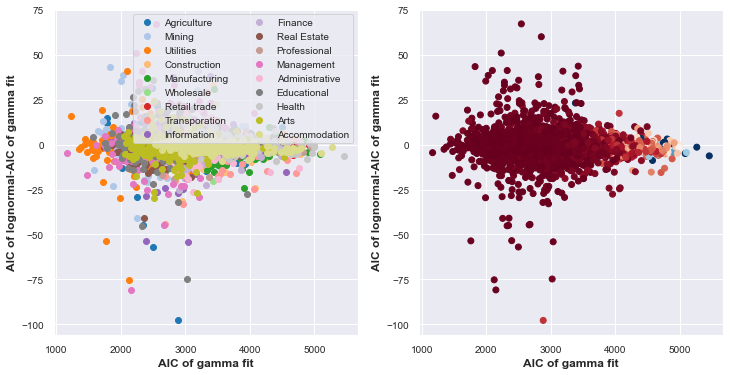

-0.6354256522346082


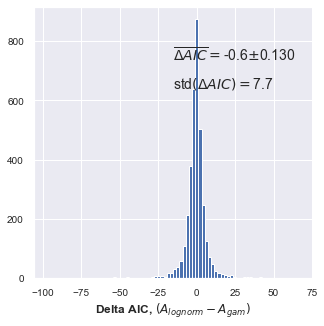

In [25]:
ctr=0
color_list=list(sns.color_palette(palette='tab20'))

delta_AIC=[]
fig=plt.figure(figsize=(12,6))
ax1=fig.add_subplot(1,2,1)
ax2=fig.add_subplot(1,2,2)
for nidx,naics in enumerate(naics_keys_to_plot):
    xvals=df_gamma_fit[naics+'-fit_AIC'].values
    yvals=df_lognormal_fit[naics+'-fit_lognorm_AIC'].values
    zvals=df_gamma_fit['naics_10-Y03-Q1-M1'].values
    idx_nonzero=np.nonzero(xvals)
    assert np.array_equal(idx_nonzero,np.nonzero(yvals)), 'both must be nonzero when fitted'
#     ax1.scatter(xvals[idx_nonzero],yvals[idx_nonzero],color=color_list[nidx],
#                 label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    ax1.scatter(xvals[idx_nonzero],yvals[idx_nonzero]-xvals[idx_nonzero],color=color_list[nidx],
                label=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True) )
    
    ax2.scatter(xvals[idx_nonzero],yvals[idx_nonzero]-xvals[idx_nonzero],
                c=zvals[idx_nonzero],cmap='RdBu' )
    delta_AIC.extend((yvals[idx_nonzero]-xvals[idx_nonzero]) ) 
    ctr+=1

ax1.legend(loc='upper right',bbox_to_anchor=(1.0,1),ncol=2)
ax1.set_xlabel('AIC of gamma fit')
ax1.set_ylabel('AIC of lognormal-AIC of gamma fit')
ax2.set_xlabel('AIC of gamma fit')
ax2.set_ylabel('AIC of lognormal-AIC of gamma fit')
plt.show()

fig2=plt.figure(figsize=(5,5))
ax1=fig2.add_subplot()
ax1.hist(np.ravel(delta_AIC), bins=80)
ax1.set_xlabel('Delta AIC, $(A_{lognorm}-A_{gam})$')
ax1.text(0.5,.8,r'$\overline{\Delta AIC}=$'+'{:.1f}'.format(np.mean(delta_AIC))
         +'$\pm$'+'{:.3f}'.format(np.std(delta_AIC)/np.sqrt(len(delta_AIC)) ),
         transform=ax1.transAxes, fontsize=BIGGER_SIZE)

ax1.text(0.5,.7,r'std$(\Delta AIC)=$'+'{:.1f}'.format(np.std(delta_AIC)),
         transform=ax1.transAxes, fontsize=BIGGER_SIZE)
print(np.mean(delta_AIC))
plt.show()

## Tweedie CGF collapse

correction: xlabel should be \tilde{q}= q/theta_i.
The analytical prediction of the CGF will all diverse at \tilde{q}=-1 but the data does not.

In [30]:
np.linspace(-1,1., 10,dtype='g')

array([-1.        , -0.77777778, -0.55555556, -0.33333333, -0.11111111,
        0.11111111,  0.33333333,  0.55555556,  0.77777778,  1.        ],
      dtype=float128)

In [4]:

# df_metroF_fitted=shared_func.get_gamma_dist_params(df_metroF_time, naics_keys_to_plot, time_stamps_likeCBP_list)

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:83: RuntimeWarning: divide by zero encountered in power


skip_ctrs= 39 0


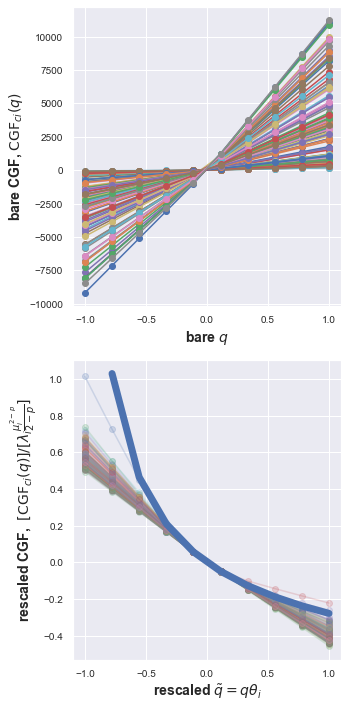

<Figure size 432x288 with 0 Axes>

In [39]:
Taylor_exp=p=1.68
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

df_metro_fitted=shared_func.get_Tweedie_dist_params(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
                                                    Taylor_exp)
df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)
q_array1=np.longdouble(np.linspace(-1,1., 10,dtype='g'))
qtilde_arr=np.longdouble(np.linspace(-1.,1., 10,dtype='g'))
alpha=shared_func.alpha_Tweedie_from_p(p)

fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

skip_ctr1=0
skip_ctr2=0

agg_CGF_rescaled=[]
agg_CGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            lambdai=np.longdouble(float(df_sub[naics+'-fit_lambda-Tweedie'].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_theta-Tweedie'].values))
            ### longdouble didn't really help very much
            CGF_q=[]
            CGF_q_rescaled=[]
            CGF_qtilde=[] ## qtilde =q times xbar/betai

            if lambdai>0:
                np.seterr(all='warn')
                
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array1:
        #                     cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q.append(float(cgf_qval))
                        ax1.plot(q_array1,CGF_q,'-o')           
                        agg_CGF.append(CGF_q)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr1+=1
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
                
                q_array2=np.longdouble(qtilde_arr*thetai)
#                 q_array2=np.longdouble(qtilde_arr/thetai)
                
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
#                             cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q_rescaled.append(
                                cgf_qval/(lambdai* shared_func.kappa_Tweedie(thetai,alpha) ))
                            
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'-o', alpha=0.2) 
                        agg_CGF_rescaled.append(CGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr2+=1

    if msa_idx>15:
        break
ax2.plot(qtilde_arr,np.power(1+qtilde_arr,alpha)-1,'b-', lw=7) 
print('skip_ctrs=',skip_ctr1,skip_ctr2)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled CGF, $[\mathrm{CGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_xlim(-100,100)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_i$',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF,  $[\mathrm{CGF}_{ci}(q)]/ [\lambda_i \frac{\mu_i^{2-p}}{2-p}   ]$',fontsize=BIGGER_SIZE)

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

### comparing data collapse at different values of p.
try at a different p to see if data collapse would still work, if it does not work at different p, then the data collapse isn't tautological
p =1.1, 1.2, etc don't collapse, but p=1.9,1.97 works as well as 1.68..

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:85: RuntimeWarning: divide by zero encountered in power


skip_ctrs= 39 1


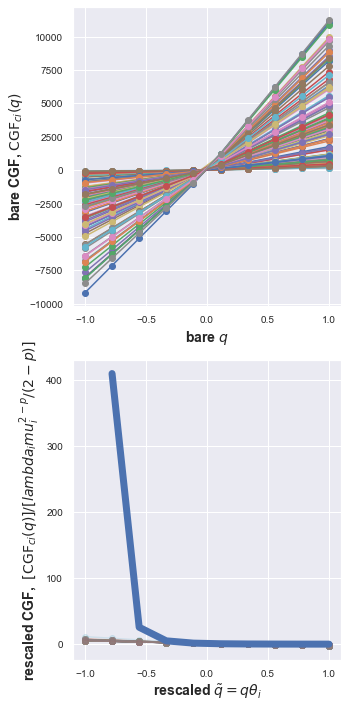

<Figure size 432x288 with 0 Axes>

In [38]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Taylor_exp=p=1.2
df_metro_fitted=shared_func.get_Tweedie_dist_params(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
                                                    Taylor_exp)
q_array1=np.longdouble(np.linspace(-1,1., 10,dtype='g'))
qtilde_arr=np.longdouble(np.linspace(-1.,1., 10,dtype='g'))

df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)

alpha=shared_func.alpha_Tweedie_from_p(p)

fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

skip_ctr1=0
skip_ctr2=0

agg_CGF_rescaled=[]
agg_CGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            lambdai=np.longdouble(float(df_sub[naics+'-fit_lambda-Tweedie'].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_theta-Tweedie'].values))
            ### longdouble didn't really help very much
            CGF_q=[]
            CGF_q_rescaled=[]
            CGF_qtilde=[] ## qtilde =q times xbar/betai

            if lambdai>0:
                np.seterr(all='warn')
#                 q_array1=np.linspace(-2.1e-2,3e-2, 10)
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array1:
        #                     cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q.append(float(cgf_qval))
                        ax1.plot(q_array1,CGF_q,'-o')           
                        agg_CGF.append(CGF_q)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr1+=1
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
#                 qtilde_arr=np.longdouble(np.linspace(-2e-1,3e-1, 10,dtype='g'))
                q_array2=np.longdouble(qtilde_arr*thetai)
#                 q_array2=np.longdouble(qtilde_arr/thetai)
                
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
#                             cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q_rescaled.append(
                                cgf_qval/(lambdai* shared_func.kappa_Tweedie(thetai,alpha) ))
                            
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'-o', alpha=0.2) 
                        agg_CGF_rescaled.append(CGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr2+=1


    if msa_idx>15:
        break
ax2.plot(qtilde_arr,np.power(1+qtilde_arr,alpha)-1,'b-', lw=7) 
print('skip_ctrs=',skip_ctr1,skip_ctr2)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled CGF, $[\mathrm{CGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_xlim(-100,100)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_i$',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF,  $[\mathrm{CGF}_{ci}(q)]/ [lambda_i \frac{\mu_i^{2-p}}{2-p}   ]$',fontsize=BIGGER_SIZE)

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

data collapse is pretty good at 1.9

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: divide by zero encountered in power


skip_ctrs= 39 0


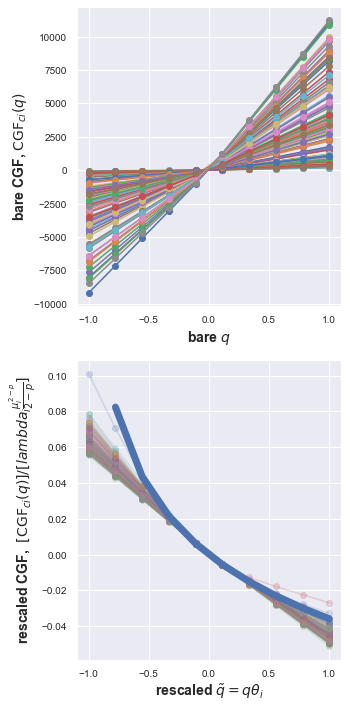

<Figure size 432x288 with 0 Axes>

In [40]:
Taylor_exp=p=1.95
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

df_metro_fitted=shared_func.get_Tweedie_dist_params(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
                                                    Taylor_exp)
q_array1=np.longdouble(np.linspace(-1,1., 10,dtype='g'))
qtilde_arr=np.longdouble(np.linspace(-1.,1., 10,dtype='g'))

df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)

alpha=shared_func.alpha_Tweedie_from_p(p)

fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

skip_ctr1=0
skip_ctr2=0

agg_CGF_rescaled=[]
agg_CGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            lambdai=np.longdouble(float(df_sub[naics+'-fit_lambda-Tweedie'].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_theta-Tweedie'].values))
            ### longdouble didn't really help very much
            CGF_q=[]
            CGF_q_rescaled=[]
            CGF_qtilde=[] ## qtilde =q times xbar/betai

            if lambdai>0:
                np.seterr(all='warn')
#                 q_array1=np.linspace(-2.1e-2,3e-2, 10)
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array1:
        #                     cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q.append(float(cgf_qval))
                        ax1.plot(q_array1,CGF_q,'-o')           
                        agg_CGF.append(CGF_q)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr1+=1
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
#                 qtilde_arr=np.longdouble(np.linspace(-2e-1,3e-1, 10,dtype='g'))
                q_array2=np.longdouble(qtilde_arr*thetai)
#                 q_array2=np.longdouble(qtilde_arr/thetai)
                
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
#                             cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q_rescaled.append(
                                cgf_qval/(lambdai* shared_func.kappa_Tweedie(thetai,alpha) ))
                            
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'-o', alpha=0.2) 
                        agg_CGF_rescaled.append(CGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr2+=1


    if msa_idx>15:
        break
ax2.plot(qtilde_arr,np.power(1+qtilde_arr,alpha)-1,'b-', lw=7) 
print('skip_ctrs=',skip_ctr1,skip_ctr2)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled CGF, $[\mathrm{CGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_xlim(-100,100)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_i$',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF,  $[\mathrm{CGF}_{ci}(q)]/ [lambda_i \frac{\mu_i^{2-p}}{2-p}  ]$',fontsize=BIGGER_SIZE)

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: divide by zero encountered in power


skip_ctrs= 39 0


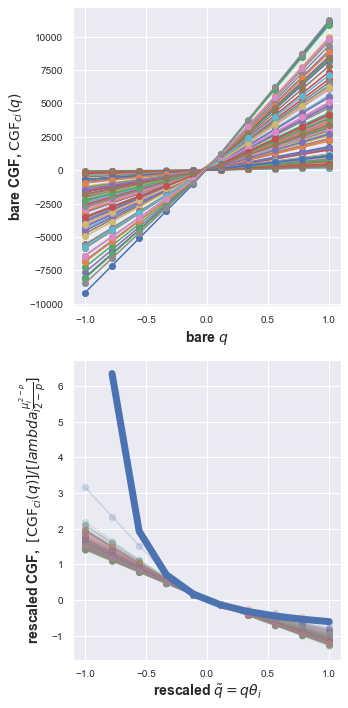

<Figure size 432x288 with 0 Axes>

In [15]:
Taylor_exp=p=1.43
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

df_metro_fitted=shared_func.get_Tweedie_dist_params(df_metro_time, naics_keys_to_plot, time_stamps_likeCBP_list,
                                                    Taylor_exp)
q_array1=np.longdouble(np.linspace(-1,1., 10,dtype='g'))
qtilde_arr=np.longdouble(np.linspace(-1.,1., 10,dtype='g'))

df_new=df_metro_fitted
msas = df_new['msa'].values
n_msas = len(msas)
# q_array=np.linspace(0,1.5, 10)

alpha=shared_func.alpha_Tweedie_from_p(p)

fig = plt.figure(figsize=(5, 10))
ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

skip_ctr1=0
skip_ctr2=0

agg_CGF_rescaled=[]
agg_CGF=[]
for msa_idx,msa in enumerate(msas):
    for nidx,naics in enumerate(naics_keys_to_plot):    
        moments_list=[]
        df_sub=df_new[df_new['msa']==msa]
#         df_subF=df_metroF_fitted[df_metroF_fitted['msa']==msa]
        naics_time_keys=[naics+'-Y'+ t for t in time_stamps_likeCBP_list]
        tot_time_keys=['naics_10-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time=[naics+'_imputed-Y'+ t for t in time_stamps_likeCBP_list]
        imputed_keys_time.extend(['naics_10_imputed-Y'+ t for t in time_stamps_likeCBP_list])
        if np.all(df_sub[imputed_keys_time].values==False):
#         if np.all(df_sub[imputed_keys_time].values==False) and np.all(df_subF[imputed_keys_time].values==False):
            ni_arr=emp_time=np.longdouble(np.squeeze(df_sub[naics_time_keys].values))
            Ns_arr=np.longdouble(np.squeeze(df_sub[tot_time_keys].values))
            lambdai=np.longdouble(float(df_sub[naics+'-fit_lambda-Tweedie'].values))
            thetai=np.longdouble(float(df_sub[naics+'-fit_theta-Tweedie'].values))
            ### longdouble didn't really help very much
            CGF_q=[]
            CGF_q_rescaled=[]
            CGF_qtilde=[] ## qtilde =q times xbar/betai

            if lambdai>0:
                np.seterr(all='warn')
#                 q_array1=np.linspace(-2.1e-2,3e-2, 10)
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array1:
        #                     cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q.append(float(cgf_qval))
                        ax1.plot(q_array1,CGF_q,'-o')           
                        agg_CGF.append(CGF_q)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr1+=1
#                 qtilde_arr=np.longdouble(np.linspace(-1.6,1.4, 10,dtype='g'))
#                 qtilde_arr=np.longdouble(np.linspace(-2e-1,3e-1, 10,dtype='g'))
                q_array2=np.longdouble(qtilde_arr*thetai)
#                 q_array2=np.longdouble(qtilde_arr/thetai)
                
                with warnings.catch_warnings():
                    warnings.filterwarnings('error')
                    try:
                        for q in q_array2:                
#                             cgf_qval=np.log(np.mean(np.exp(q*ni_arr/Ns_arr)) )
                            cgf_qval=np.log(np.mean(np.exp(q*ni_arr)) )
                            CGF_q_rescaled.append(
                                cgf_qval/(lambdai* shared_func.kappa_Tweedie(thetai,alpha) ))
                            
                        ax2.plot(qtilde_arr,CGF_q_rescaled,'-o', alpha=0.2) 
                        agg_CGF_rescaled.append(CGF_q_rescaled)
                    except Warning:                   
#                         print('skipped',np.max(q_array2), np.min(q_array2))
                        skip_ctr2+=1


    if msa_idx>15:
        break
ax2.plot(qtilde_arr,np.power(1+qtilde_arr,alpha)-1,'b-', lw=7) 
print('skip_ctrs=',skip_ctr1,skip_ctr2)

ax1.set_xlabel(r'bare $q$',fontsize=BIGGER_SIZE)
ax1.set_ylabel(r'bare CGF, $\mathrm{CGF}_{ci}(q)$',fontsize=BIGGER_SIZE)
# ax1.set_ylabel(r'rescaled CGF, $[\mathrm{CGF}_{ci}(q)]^{-1/ \beta_{ci}}$',fontsize=BIGGER_SIZE)
# ax1.set_xlim(-100,100)
# ax1.set_ylim(-.1,5)


ax2.set_xlabel(r'rescaled $\tilde{q}=q \theta_i$',fontsize=BIGGER_SIZE)
ax2.set_ylabel(r'rescaled CGF,  $[\mathrm{CGF}_{ci}(q)]/ [lambda_i \frac{\mu_i^{2-p}}{2-p}  ]$',fontsize=BIGGER_SIZE)

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

###plotting the average. 
# ax1.plot(q_array1,np.mean(agg_CGF,axis=0),'k-^', lw=4,ms='15')
# ax2.plot(qtilde_arr,np.mean(agg_CGF_rescaled,axis=0),'k-^', lw=4,ms='15')


fig.patch.set_facecolor('white')
plt.tight_layout()
plt.show()

## log of growth rates distribution

mean 0.0008459095491014555 0.0 sigma 0.08543050946976485 0.08543050946976485
error= 278.00430836010656
hybrid method failed
error= 2.8421709430404007e-13 method= lm
k=  0.3810 ;  lambda=  0.0063
Levy parameters quick estimate = (1.0779735898042846, -0.008189902107664642, 0.0015047473326016013, 0.012041722041474284)


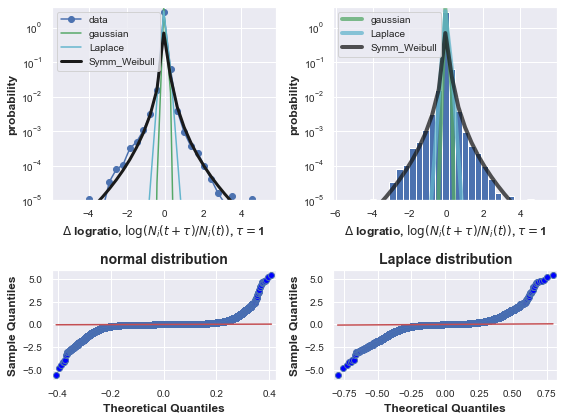

no imputed values


In [5]:
naics_keys_to_plot =naics_colnames 
shared_func.plot_DeltaLogRatio_distribution(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')
print ('no imputed values')

#### via MLE
here MLE is done on full data with full levy stable pdf, not just tails and that might be making it hard to get a good fit.

k=  0.5687 ;  lambda=  0.0215
mu_norm=  0.0008 ;  sigma_norm=  0.0854
mu_data=  0.0008 ;  sigma_data=  0.0854
scale_laplace=  0.0307
k=  0.5687 ;  lambda=  0.0215
Levy parameters quick estimate = (1.0779735898042846, -0.008189902107664642, 0.0015047473326016013, 0.012041722041474284)
pylevy is available, performing fit
parameterization1:  (par=1, alpha=1.07, beta=0.00, mu=0.00, sigma=0.01, -2105023.784982197)
parameterization0:  [1.07390191 0.         0.00162383 0.01206583]


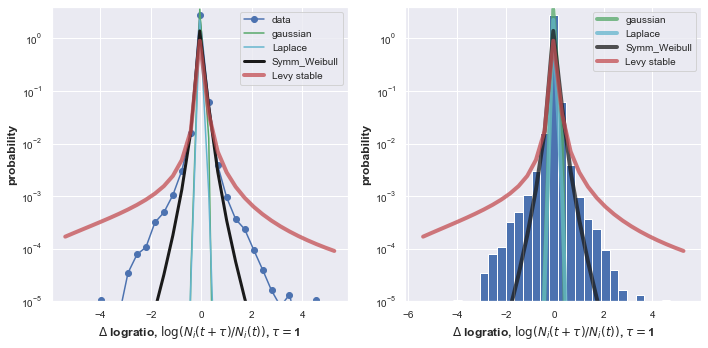

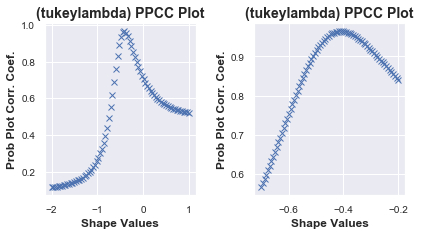

no imputed values


In [69]:
naics_keys_to_plot =naics_colnames
shared_func.plot_DeltaLogRatio_distribution_MLE(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')
print ('no imputed values')

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1797: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1797: RuntimeWarning: invalid value encountered in log
  return log(self._pdf(x, *args))


k=  0.5687 ;  lambda=  0.0215
mu_norm=  0.0008 ;  sigma_norm=  0.0854
mu_data=  0.0008 ;  sigma_data=  0.0854
scale_laplace=  0.0307
k=  0.5687 ;  lambda=  0.0215
Levy parameters quick estimate = (1.0779735898042846, -0.008189902107664642, 0.0015047473326016013, 0.012041722041474284)


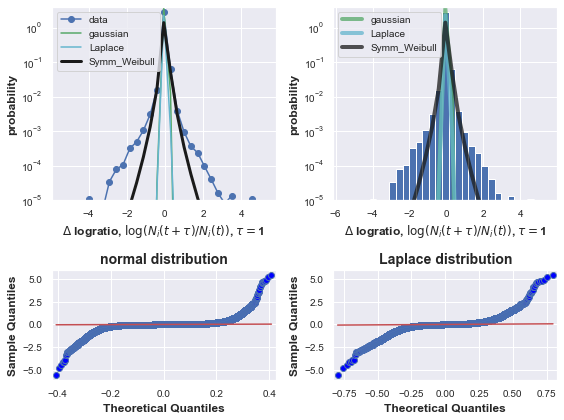

no imputed values


In [212]:
naics_keys_to_plot =naics_colnames
shared_func.plot_DeltaLogRatio_distribution_MLE(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')
print ('no imputed values')

In [3]:
naics_keys_to_plot =naics_colnames

## log growth rate -collapse- stratified by naics category

monthly


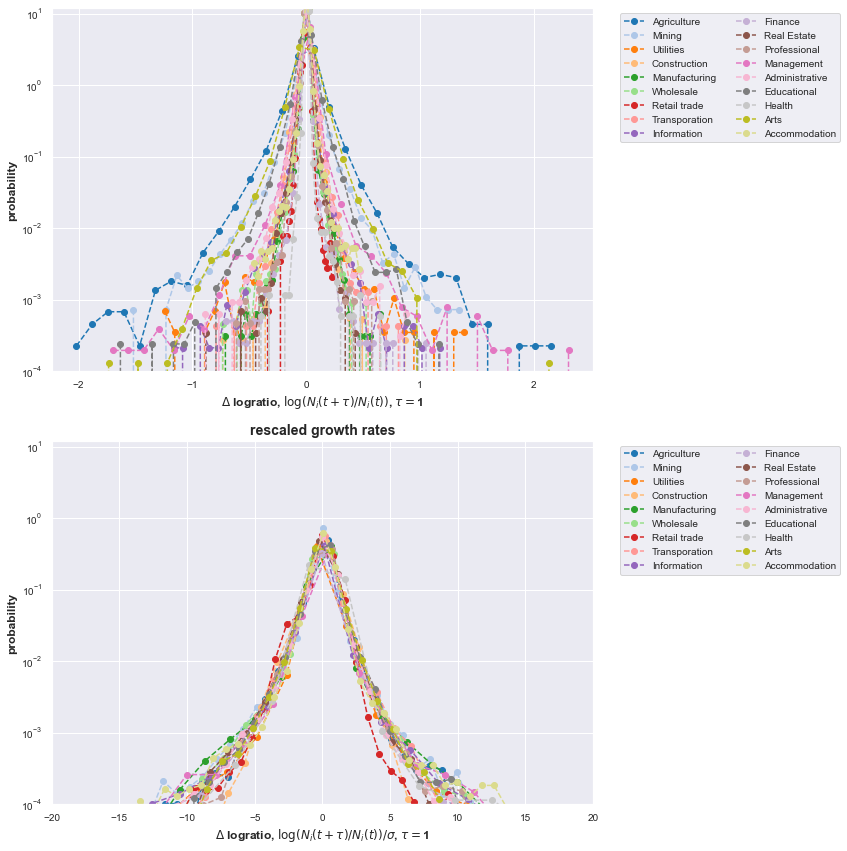

yearly


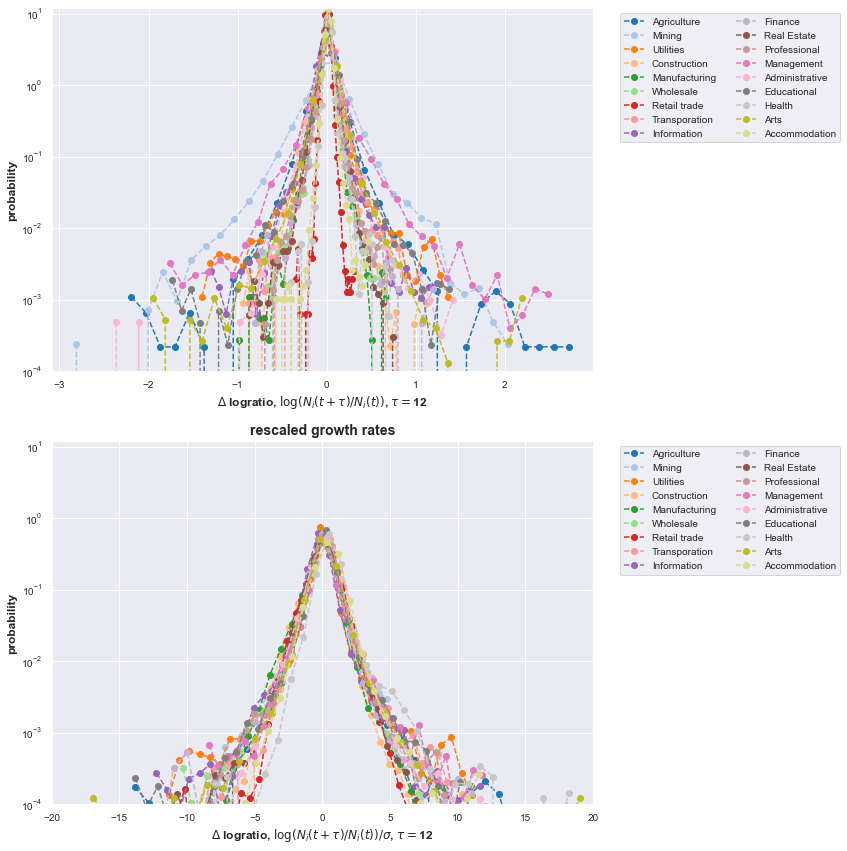

In [53]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
print('monthly')
shared_func.plot_DeltaLogRatio_by_naics(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')


print('yearly')
shared_func.plot_DeltaLogRatio_by_naics(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            tau=12,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')


### for big cities only
deviation from laplace in the tails is not an artifact from small cities

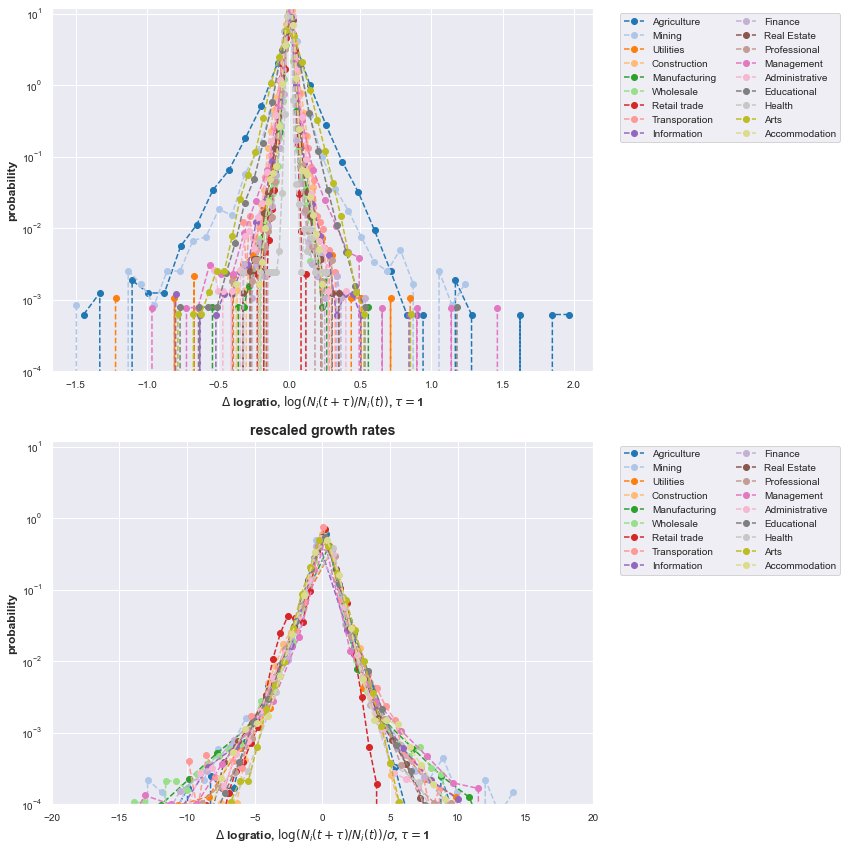

yearly


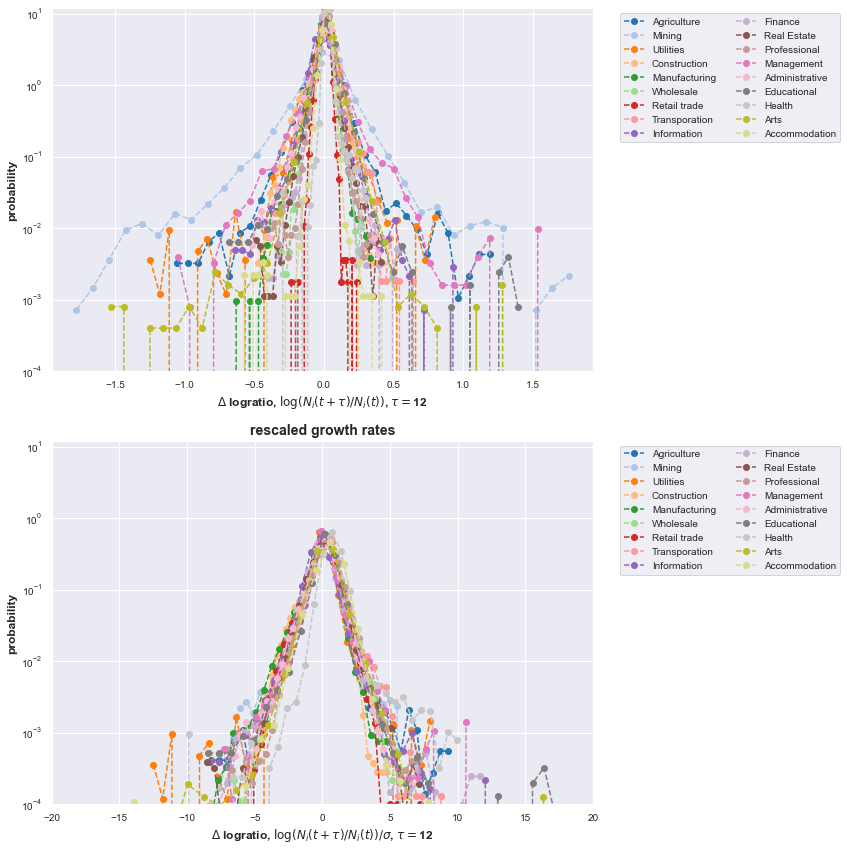

In [54]:
##### for big cities only
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

df_big_cities_time=shared_func.get_cities_based_on_size(df_metro_time, time_stamps_likeCBP_list[0],
                                                        big_only=True, BLS=True)
shared_func.plot_DeltaLogRatio_by_naics(df_big_cities_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')
print('yearly')

shared_func.plot_DeltaLogRatio_by_naics(df_big_cities_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,tau=12,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')


## fit log growth of each category separately

for monthly intervals, neutral theory outperforms laplace and weibull often but not always. Weibull does a reasonable job as well.

t/tau=  1.69e-03 ;  b/d=  8.90e-01 loc & scale are fixed= 0.0 1.0
t/tau=  2.42e-04 ;  b/d=  6.97e-01 loc & scale are fixed= 0.0 1.0
t/tau=  4.27e-05 ;  b/d=  8.45e-01 loc & scale are fixed= 0.0 1.0
t/tau=  4.12e-04 ;  b/d=  1.26e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.33e-05 ;  b/d=  8.52e-01 loc & scale are fixed= 0.0 1.0
t/tau=  3.81e-05 ;  b/d=  9.29e-01 loc & scale are fixed= 0.0 1.0
t/tau=  7.32e-05 ;  b/d=  1.10e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.26e-04 ;  b/d=  8.88e-01 loc & scale are fixed= 0.0 1.0
t/tau=  6.85e-05 ;  b/d=  9.47e-01 loc & scale are fixed= 0.0 1.0
hybrid method failed
error= 5.684341886080802e-14 method= lm
t/tau=  2.64e-05 ;  b/d=  1.09e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.92e-04 ;  b/d=  1.25e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.05e-04 ;  b/d=  1.11e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.16e-05 ;  b/d=  6.83e-01 loc & scale are fixed= 0.0 1.0
t/tau=  4.24e-04 ;  b/d=  1.25e+00 loc & scale are fixed= 0.0 1.0
t/tau=  6.44e-0

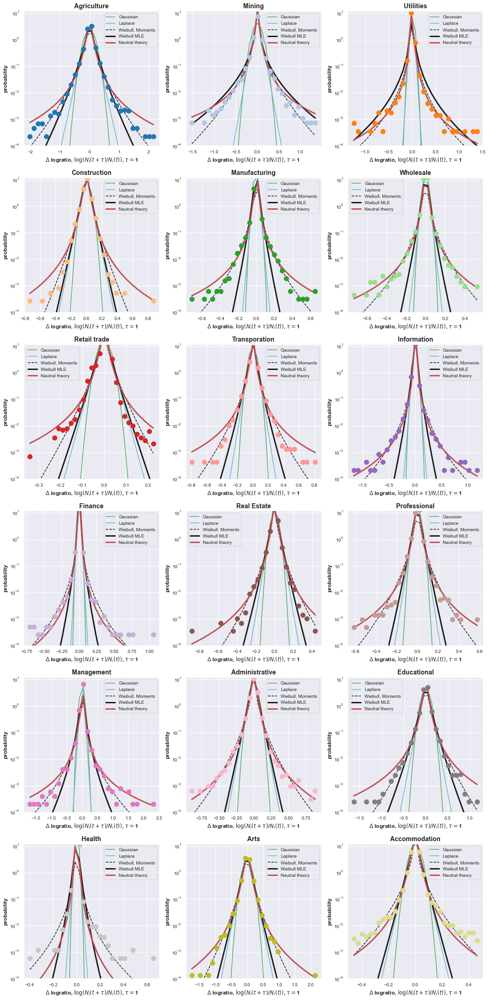

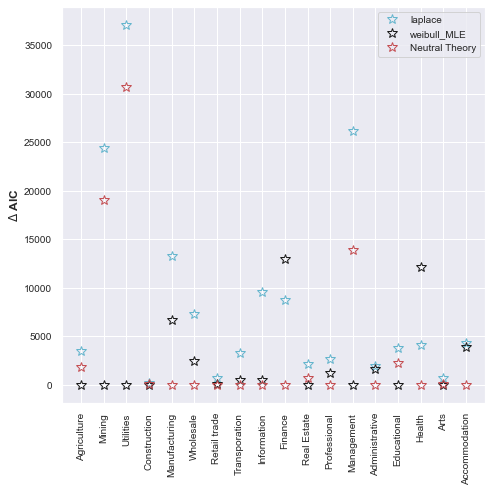

In [9]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    shared_func.plot_DeltaLogRatio_fit_by_naics(df_metro_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')


for yearly intervals, neutral theory outperforms laplace and Weibull consistently.

- The neutral theory fit recognizes that the timescale has become larger, but not necessarily by a factor of 12. b/d remians O(1) in both fits but is not the same.
- The timescale here is 1000 years which means that a sector in a city does not die for a very long time, and evolution is slow. To compare, for a single firm, Geoff West estimates half-life to be 10, but that is because mergers and acquisitions are also considered as death

t/tau=  4.14e-03 ;  b/d=  1.26e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.05e-02 ;  b/d=  1.13e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.90e-04 ;  b/d=  9.33e-01 loc & scale are fixed= 0.0 1.0
t/tau=  5.58e-03 ;  b/d=  2.04e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.03e-03 ;  b/d=  1.31e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.48e-03 ;  b/d=  1.56e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.38e-04 ;  b/d=  2.66e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.65e-03 ;  b/d=  1.52e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.12e-03 ;  b/d=  1.31e+00 loc & scale are fixed= 0.0 1.0
t/tau=  7.36e-04 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.66e-03 ;  b/d=  1.90e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.90e-03 ;  b/d=  1.66e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.55e-03 ;  b/d=  8.36e-01 loc & scale are fixed= 0.0 1.0
t/tau=  4.35e-03 ;  b/d=  1.54e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.94e-03 ;  b/d=  1.10e+00 loc & scale are fixed= 0.0 1.0
t/tau=  9.

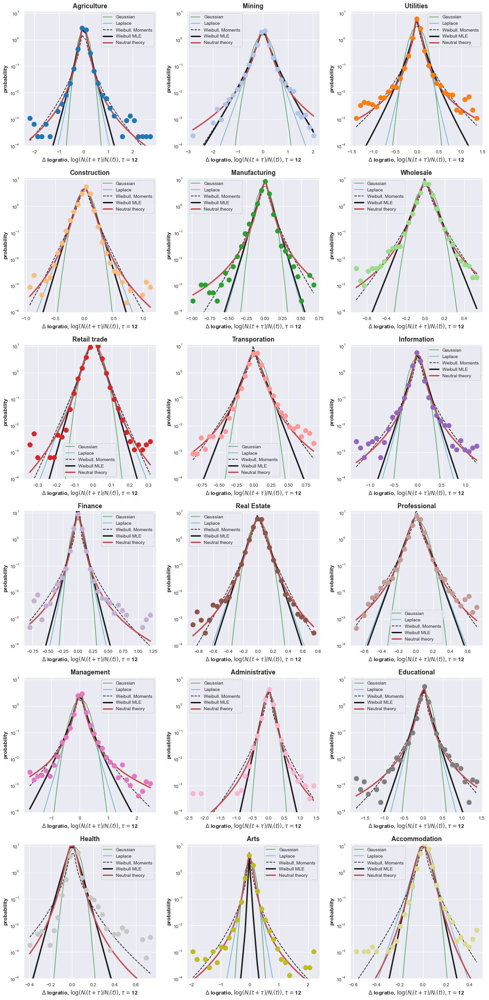

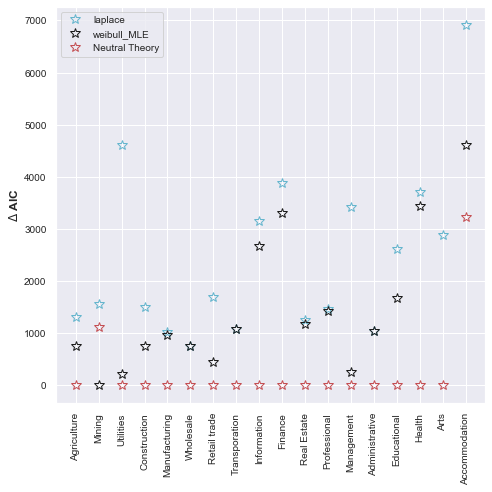

In [3]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    shared_func.plot_DeltaLogRatio_fit_by_naics(df_metro_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,tau=12,
                                                remove_imputed_values=True,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')


for fractions, plotting only BDI model fit

t/tau=  4.14e-03 ;  b/d=  1.27e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.26e-03 ;  b/d=  1.05e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.40e-03 ;  b/d=  1.06e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.47e-03 ;  b/d=  1.90e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.29e-04 ;  b/d=  1.43e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.38e-04 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.63e-04 ;  b/d=  2.39e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.52e-03 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.57e-03 ;  b/d=  1.41e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.31e-04 ;  b/d=  1.38e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.58e+00 loc & scale are fixed= 0.0 1.0
t/tau=  9.93e-04 ;  b/d=  1.33e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.47e-03 ;  b/d=  8.29e-01 loc & scale are fixed= 0.0 1.0
t/tau=  2.73e-03 ;  b/d=  1.36e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.03e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.

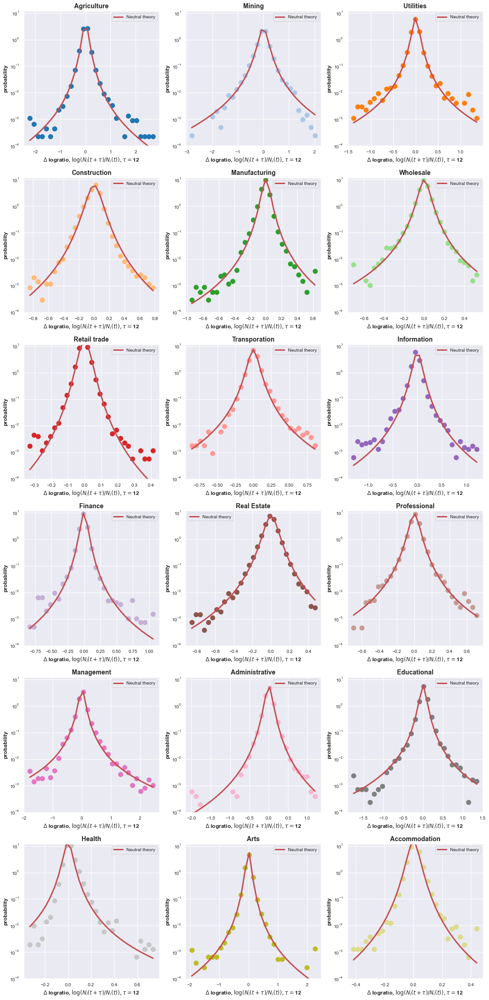

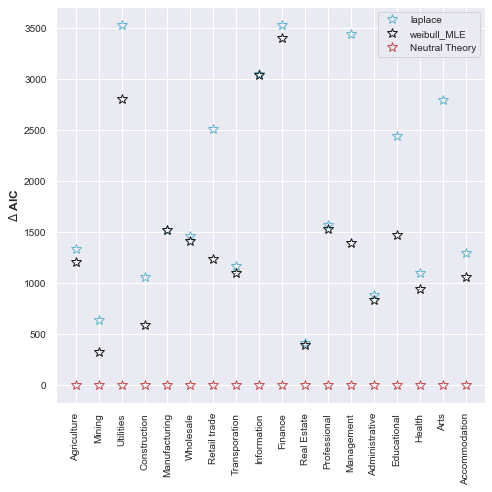

In [10]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,tau=12,
                                                remove_imputed_values=True,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                               plot_only_BDI=True)
with open(destfold+'fit_AFD_with_logG_K-fitvals-tau_'+str(tau)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit, handle)  

## rescaled aggregate logarithmic growth rates
for monthly data, weibull does better than laplace in AIC, unlike CBP

for monthly time interval
weibull MLE, k=  0.8612 ;  lambda=  0.5526
weibull MM, k=  0.4663 ;  lambda=  0.1636
AIC dict= {'gaussian': [2704564.7940483196], 'laplace': [2131295.0087153227], 'weibull_MLE': [1743593.803281167], 'weibull_MM': []}


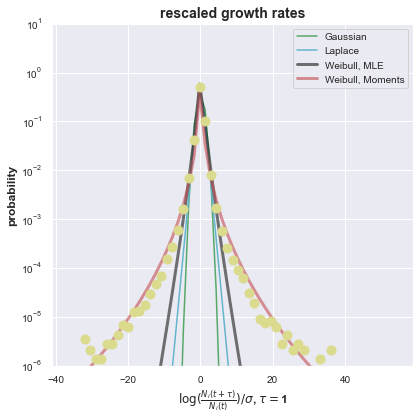

for yearly time interval
weibull MLE, k=  0.9952 ;  lambda=  0.6704
weibull MM, k=  0.6559 ;  lambda=  0.4028
AIC dict= {'gaussian': [183592.5320587041], 'laplace': [165563.42665640937], 'weibull_MLE': [165562.5583776761], 'weibull_MM': []}


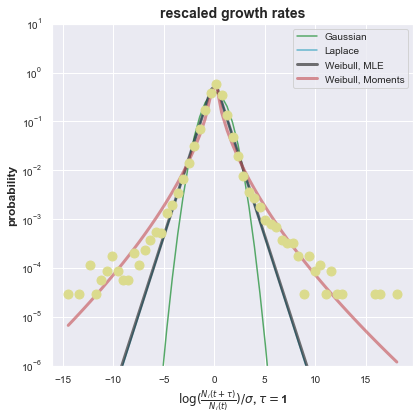

In [33]:

### for monthly and yearly data..
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    print('for monthly time interval')
    
    
    shared_func.plot_agg_rescaled_DeltaLogRatio(df_metro_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')
#     shared_func.plot_agg_rescaled_DeltaLogRatio_rescaled(df_metro_time, naics_keys_to_plot, 
#                                                 time_stamps_likeCBP_list,remove_imputed_values=True,
#                                                 xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')
    print('for yearly time interval')
    years = [k.zfill(2) for k in np.arange(3, 18).astype(int).astype(str)]
    time_stamp_single_month_list=[k+'-Q1-M2' for k in years]
    shared_func.plot_agg_rescaled_DeltaLogRatio(df_metro_time, naics_keys_to_plot, 
                                                time_stamp_single_month_list,remove_imputed_values=True,
                                                xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')

### for big cities only.

for monthly time interval
weibull MLE, k=  0.9225 ;  lambda=  0.5805
weibull MM, k=  0.4934 ;  lambda=  0.1963
AIC dict= {'gaussian': [1267684.808152679], 'laplace': [1049198.1501617082], 'weibull_MLE': [1005310.371649661], 'weibull_MM': []}


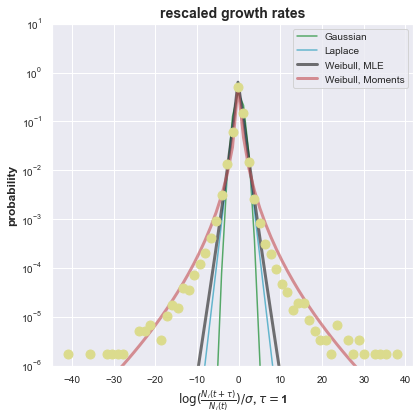

for yearly time interval
weibull MLE, k=  1.0714 ;  lambda=  0.7545
weibull MM, k=  0.7148 ;  lambda=  0.4763
AIC dict= {'gaussian': [86351.18414100404], 'laplace': [81076.34602933232], 'weibull_MLE': [82261.82336446598], 'weibull_MM': []}


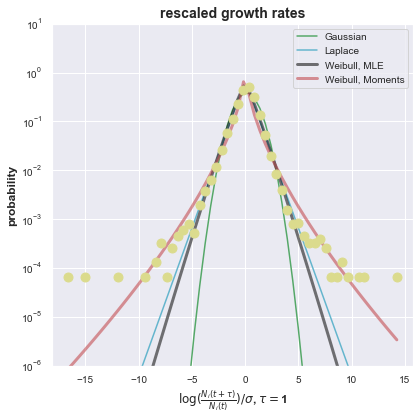

In [49]:

### for monthly and yearly data..
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

df_big_cities_time=shared_func.get_cities_based_on_size(df_metro_time, time_stamps_likeCBP_list[0],
                                                        big_only=True, BLS=True)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    print('for monthly time interval')
    
    
    shared_func.plot_agg_rescaled_DeltaLogRatio(df_big_cities_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')
#     shared_func.plot_agg_rescaled_DeltaLogRatio_rescaled(df_metro_time, naics_keys_to_plot, 
#                                                 time_stamps_likeCBP_list,remove_imputed_values=True,
#                                                 xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')
    print('for yearly time interval')
    years = [k.zfill(2) for k in np.arange(3, 18).astype(int).astype(str)]
    time_stamp_single_month_list=[k+'-Q1-M2' for k in years]
    shared_func.plot_agg_rescaled_DeltaLogRatio(df_big_cities_time, naics_keys_to_plot, 
                                                time_stamp_single_month_list,remove_imputed_values=True,
                                                xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')

In [43]:
med_size=np.median(df_metro_time['naics_10-Y'+time_stamps_likeCBP_list[0]].values)

### rescaled log growth for different tau
this takes a long time to run... so don't rerun casually.

AIC dict= {'gaussian': [2687282.7508383878, 5199271.936903653, 7544445.457218434, 9728382.821032368, 11750227.46084588, 13610704.849705942, 15309800.002658369, 16848238.605799243, 18224245.15178825, 19436904.581238072], 'laplace': [2381596.413008243, 4721700.307237069, 6960110.533604991, 9074478.45347085, 11051888.540013311, 12883521.781714883, 14562766.471814997, 16089350.812464073, 17459538.096109524, 18668069.345695075], 'weibull_MLE': [2380992.486323539, 4721632.8849234665, 6957806.192370155, 9066978.728192037, 11036746.92424266, 12859209.769586012, 14528636.324936109, 16045137.6328204, 17405554.723574962, 18605171.362630654], 'taus': array([ 12,  24,  36,  48,  60,  72,  84,  96, 108, 120])}


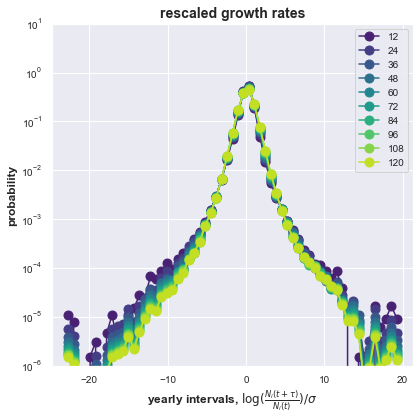

10 10


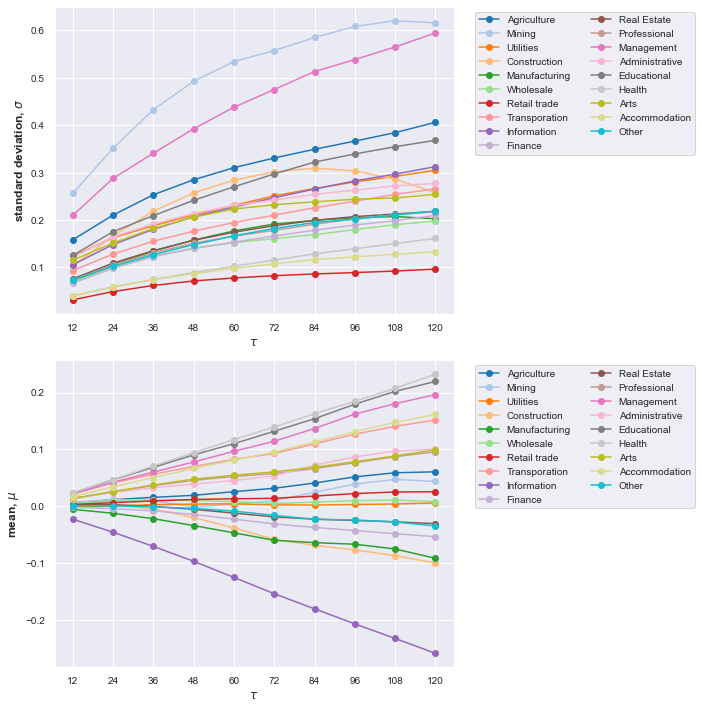

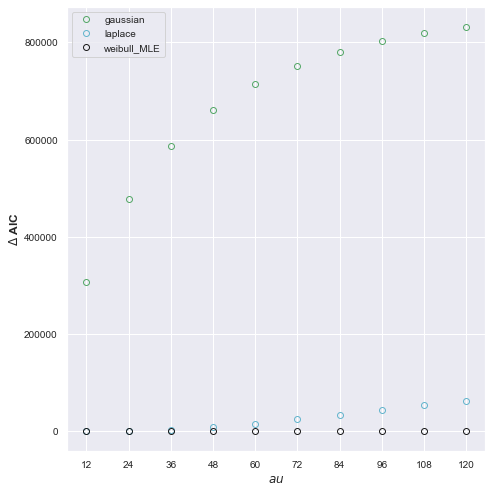

AIC dict= {'gaussian': [2898641.1316931183, 5685363.307775494, 8410260.09949992, 11079067.307781406, 13675591.939270832, 16217505.340953639, 18712962.113563593, 21138943.424734745, 23513167.28364211, 25842707.630895246, 28104444.592268232, 30316236.945972096, 32484779.74939264, 34585157.172929615, 36635828.81925982, 38642397.58277541, 40582094.85555647, 42471737.757403105, 44317206.33528412, 46096253.80635436, 47825773.20380968, 49510514.840031266, 51128798.36075862, 52697612.168540865, 54221959.17486666], 'laplace': [2281251.398695105, 4690350.888564462, 7130030.598182608, 9546340.874640478, 11940680.230126051, 14323566.329974677, 16675653.231148992, 18979855.5069113, 21257320.591862522, 23497709.759467535, 25681825.709650785, 27832152.10671719, 29942972.0402427, 31993578.922901455, 34006267.50830374, 35976420.93028024, 37884681.216079734, 39751278.547101416, 41573411.80803219, 43332570.38660304, 45047749.73436562, 46717212.78332688, 48323430.885607004, 49885111.19765984, 51401245.268

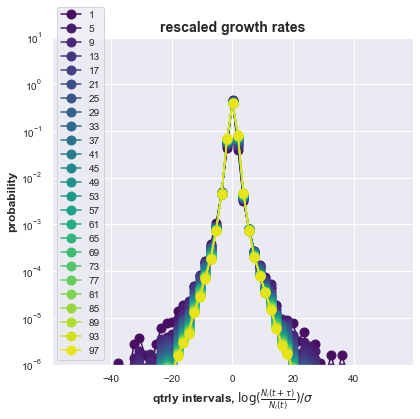

25 25


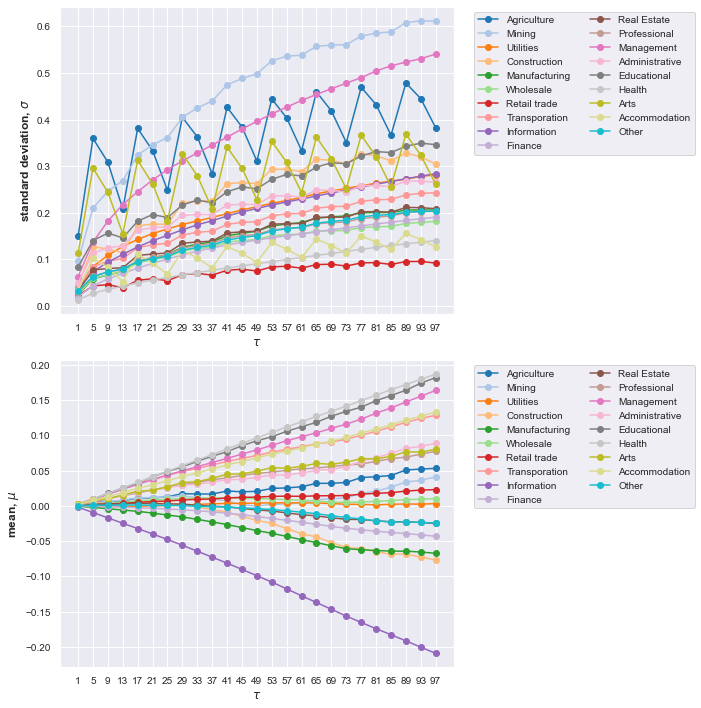

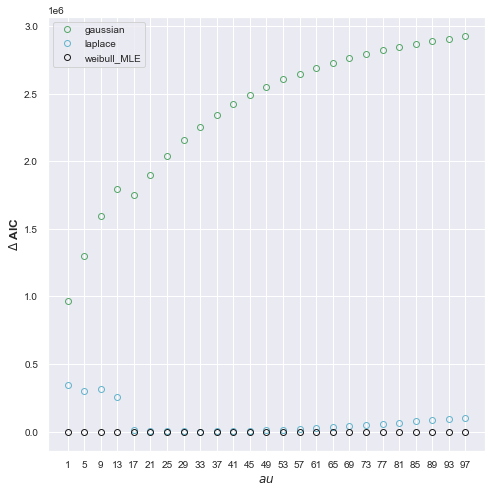

In [20]:
##  yearly intervals..
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

taus=np.arange(12,121,12)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    shared_func.plot_agg_rescaled_DeltaLogRatio_taus(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,taus=taus,
                                            remove_imputed_values=True,
                                            xlabel=r'yearly intervals, $\log(\frac{N_i(t+\tau)}{N_i(t)})$')

taus=np.arange(1,100,4)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    shared_func.plot_agg_rescaled_DeltaLogRatio_taus(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,taus=taus,
                                            remove_imputed_values=True,
                                            xlabel=r'qtrly intervals, $\log(\frac{N_i(t+\tau)}{N_i(t)})$')


    
    

## compare all growths with growth in cities with many firms

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))


AIC dict= {'gaussian': [], 'laplace': [-3707039.697590226, 2131295.0087153227, -3086933.0944984746, 1624299.298777871], 'weibull_MLE': [-4364208.352287527, 1743593.803281167, -3163921.3464361196, 1561687.8338181623], 'weibull_MM': []}


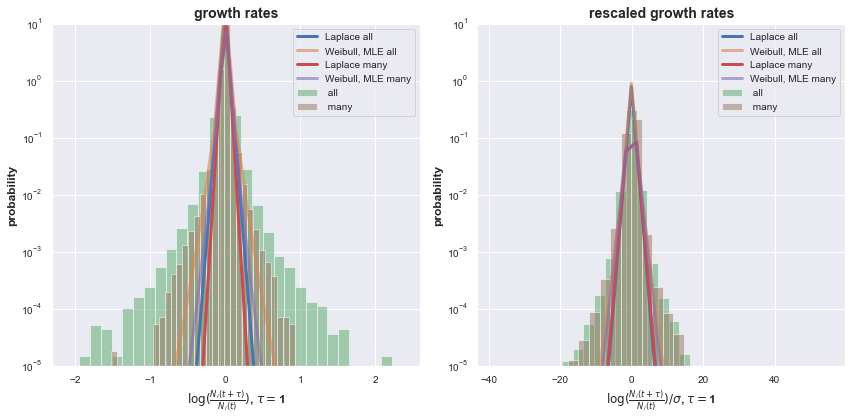

In [64]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')


# with warnings.catch_warnings():
#     warnings.simplefilter("ignore")
shared_func.compare_growth_of_manyfirms_and_all_cities(df_metro_time, naics_keys_to_plot, 
                                        time_stamps_likeCBP_list,
                                        xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$',
                                        Nest_cutoff=100)

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/Dropbox/research/James-research/city establishment data/shared_analysis_functions.py:81: RuntimeWarning: divide by zero encountered in power
  return k * np.power(np.abs(x),k-1.) * np.exp(-np.power(np.abs(x),k))/2.
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))


AIC dict= {'gaussian': [], 'laplace': [-1963303.1493111632, 2242923.990412248, -1768325.7154724137, 1709062.5886469956], 'weibull_MLE': [-1990323.4116108424, 2259072.1045953264, -1770188.86500393, 1737394.8367983103], 'weibull_MM': []}


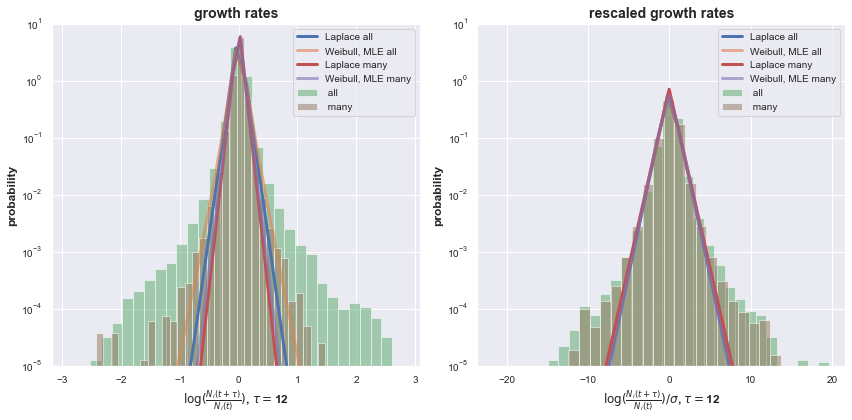

In [65]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')


# with warnings.catch_warnings():
#     warnings.simplefilter("ignore")
shared_func.compare_growth_of_manyfirms_and_all_cities(df_metro_time, naics_keys_to_plot, 
                                        time_stamps_likeCBP_list,tau=12,
                                        xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$',
                                        Nest_cutoff=100)

### compare big and all cities log g

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))
/Users/ashish/Dropbox/research/James-research/city establishment data/shared_analysis_functions.py:81: RuntimeWarning: divide by zero encountered in power
  return k * np.power(np.abs(x),k-1.) * np.exp(-np.power(np.abs(x),k))/2.
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1833: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))


AIC dict= {'gaussian': [], 'laplace': [-3707039.697590226, 2131295.0087153227, -1927673.0500719948, 1049198.1501617082], 'weibull_MLE': [-4364208.352287527, 1743593.803281167, -2007221.3068124938, 1005310.371649661], 'weibull_MM': []}


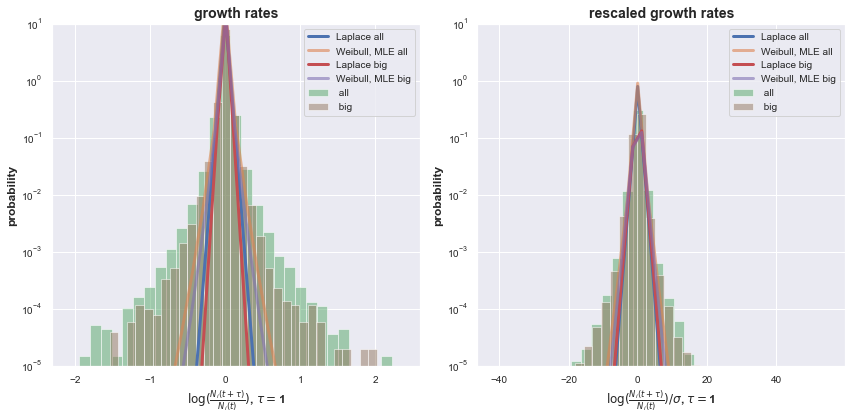

In [6]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

df_big_cities_time=shared_func.get_cities_based_on_size(df_metro_time, time_stamps_likeCBP_list[0],
                                                        big_only=True, BLS=True)


# with warnings.catch_warnings():
#     warnings.simplefilter("ignore")
shared_func.plot_compare_growth_of_big_and_all_cities(df_metro_time, df_big_cities_time, naics_keys_to_plot, 
                                        time_stamps_likeCBP_list,remove_imputed_values=True,
                                        xlabel=r'$\log(\frac{N_i(t+\tau)}{N_i(t)})$')

### scatter plot of log employment growth and city growth
Large fluctuations are not from fast-growing vs slow-growing cities.

In [64]:
df_new=shared_func.insert_colored_by_columns(df_metro_time, time_stamps_likeCBP_list,
                                           colored_by='city_growth', BLS=True)

xval_list=[]
yval_list=[]
time_stamps=time_stamps_likeCBP_list
tau=1
naics_keys_to_plot=naics_keys
for i in range(len(time_stamps)-tau):
    time_stamp1=time_stamps[i]
    time_stamp2=time_stamps[i+tau]
    naics_yr = [naics+'-Y'+time_stamp1 for naics in naics_keys_to_plot]
    naics_yr2 = [naics+'-Y'+time_stamp2 for naics in naics_keys_to_plot] 
    imputed_yr = [naics+'_imputed-Y'+time_stamp1 for naics in naics_keys_to_plot]
    imputed_yr2 = [naics+'_imputed-Y'+time_stamp2 for naics in naics_keys_to_plot] 
    
    for idx, naics2 in enumerate(naics_yr2):
        naics1=naics_yr[idx]
        imputed1=imputed_yr[idx]
        imputed2=imputed_yr2[idx]
        logratio_change_naics=np.log(df_new[naics2].values*1./df_new[naics1].values)
        masks=np.ones(len(logratio_change_naics)).astype(bool)
        masks[np.where(df_new[naics2]<1)]=False
        masks[np.where(df_new[naics1]<1)]=False
        masks[np.where(imputed2==True)]=False
        masks[np.where(imputed1==True)]=False
        masks[np.isnan(logratio_change_naics)]=False
        masks[np.isnan(df_new['city_growth'].values)]=False
        
        if np.any(np.isnan(logratio_change_naics[masks])):
            print(logratio_change_naics)
            sys.exit(1)
            break
        yval_list.extend(logratio_change_naics[masks])
        xval_list.extend(df_new['city_growth'].values[masks])

   

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid valu

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encou

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid valu

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountere

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountere

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value enco

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountere

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value enco

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountere

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid val

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountere

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encou

/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid valu

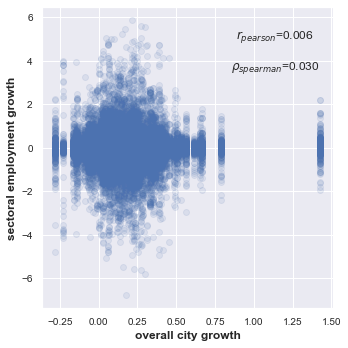

In [76]:
spearman_corr=scipy.stats.spearmanr(xval_list,yval_list)[0]
pearson_corr=scipy.stats.pearsonr(xval_list,yval_list)[0]
fig = plt.figure(figsize=(5,5))
ax1 = fig.add_subplot()
ax1.scatter(xval_list,yval_list,alpha=.1)
ax1.set_xlabel('overall city growth')
ax1.set_ylabel('sectoral employment growth')
ax1.text(0.8, 0.8, r'$\rho_{spearman}$='+'{:.3f}'.format(spearman_corr), horizontalalignment='center',
         verticalalignment='center', transform=ax1.transAxes)
ax1.text(0.8, 0.9, r'$r_{pearson}$='+'{:.3f}'.format(pearson_corr), horizontalalignment='center',
         verticalalignment='center', transform=ax1.transAxes)
plt.tight_layout()
plt.show()

In [67]:
scipy.stats.spearmanr(xval_list,yval_list)

SpearmanrResult(correlation=0.02972170325828039, pvalue=1.968124183843231e-281)

In [66]:
scipy.stats.pearsonr(xval_list,yval_list)

(0.006416619479818645, 1.0129544566840289e-14)

## fit temporal MSD and MedSD

Seasonal fluctuations make this plot not useful

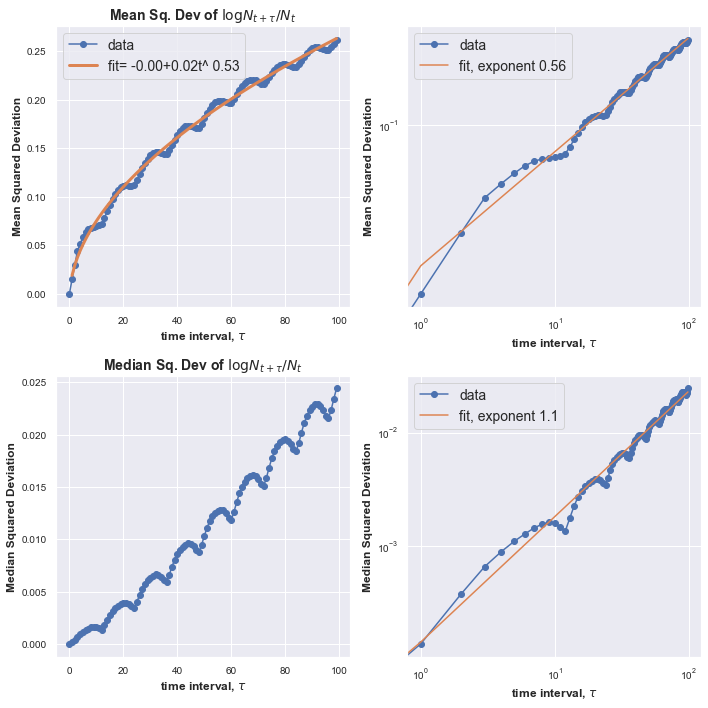

In [38]:
taus=np.arange(100).astype(int)
naics_keys_to_plot =naics_colnames
shared_func.plot_MeanMedianSD_time(df_metro_time, taus, naics_keys_to_plot, 
                       time_stamps_likeCBP_list,
                       title_suffix=r' of $\log N_{t+\tau}/N_{t}$')

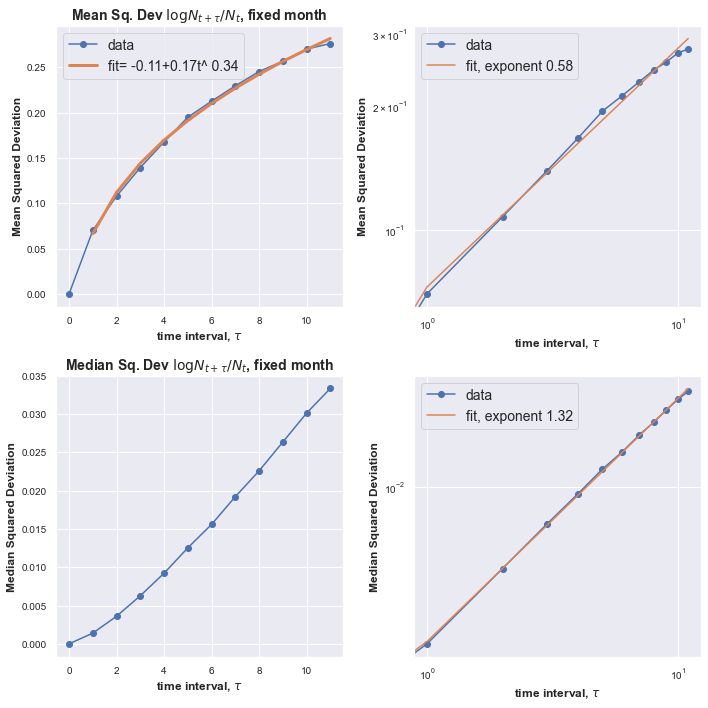

In [47]:
taus=np.arange(12).astype(int)
naics_keys_to_plot =naics_colnames
years = [k.zfill(2) for k in np.arange(3, 18).astype(int).astype(str)]
time_stamp_single_month_list=[k+'-Q1-M2' for k in years]
shared_func.plot_MeanMedianSD_time(df_metro_time, taus, naics_keys_to_plot, 
                       time_stamp_single_month_list,
                       title_suffix=r' $\log N_{t+\tau}/N_{t}$, fixed month')

/Users/ashish/Dropbox/research/James-research/city establishment data/shared_analysis_functions.py:280: RuntimeWarning: invalid value encountered in true_divide
  ratio_change_naics_yr=np.ravel(empF_naics2[empF_naics1>0]*1./empF_naics1[empF_naics1>0])


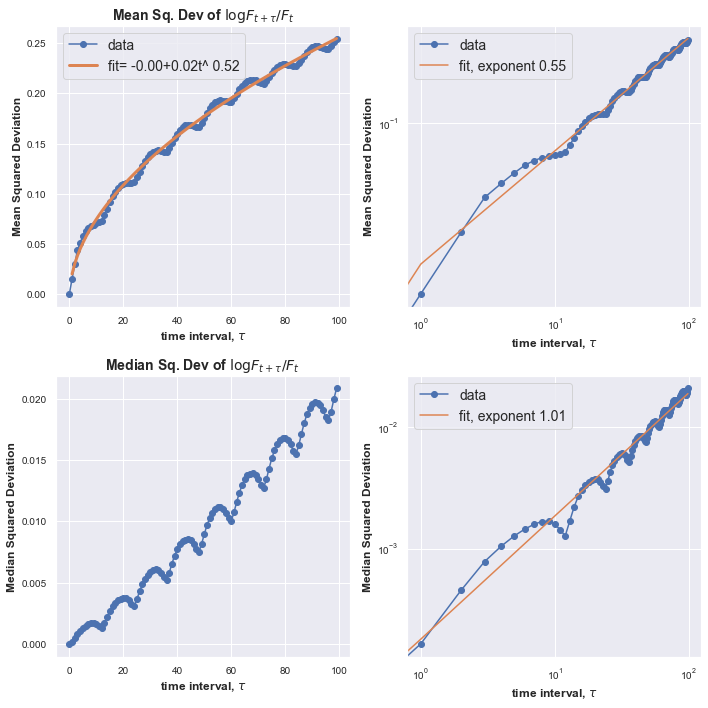

In [39]:
# years = [k.zfill(2) for k in np.arange(2, 18).astype(int).astype(str)]
taus=np.arange(100).astype(int)
naics_keys_to_plot =naics_colnames
shared_func.plot_MeanMedianSD_time(df_metroF_time, taus, naics_keys_to_plot, 
                       time_stamps_likeCBP_list,
                       title_suffix=r' of $\log F_{t+\tau}/F_{t}$')

## temporal MSD stratified by NAICS

Occupation in some sectors is extremely seasonal (agriculture, arts, etc.) , while occupation in other sectors (finance, information, etc) is not seasonal.

/Users/ashish/Dropbox/research/James-research/city establishment data/shared_analysis_functions.py:461: RuntimeWarning: invalid value encountered in true_divide
  np.log (df_metro_time[naics_y2].values[idx_used]/
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3420: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3703: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  subok=False)
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value 

fit unsuccessful for  19 naics_92


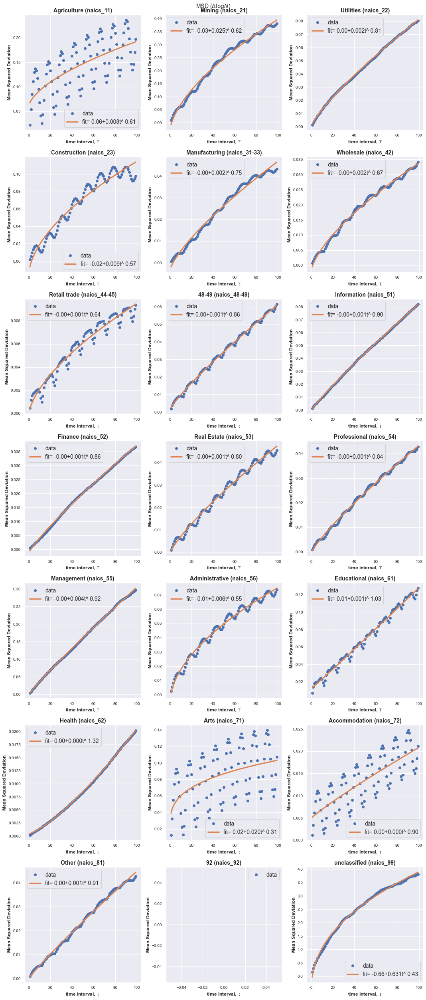

fit unsuccessful for  2 848.1836232864081
fit unsuccessful for  3 14016.665546169785
fit unsuccessful for  4 25674.272858161083
fit unsuccessful for  5 9662.545583799258
fit unsuccessful for  6 34140.50385366626
fit unsuccessful for  7 7695.9699591610715
fit unsuccessful for  8 6529.02752064048
fit unsuccessful for  9 13376.009498024943
fit unsuccessful for  10 4925.653794492949
fit unsuccessful for  11 15624.12229601518
fit unsuccessful for  12 3804.438214051215
fit unsuccessful for  13 16237.238224570281
fit unsuccessful for  14 6541.900099606103
fit unsuccessful for  15 38492.34464082687
fit unsuccessful for  16 4927.288191014681
fit unsuccessful for  17 27047.228848637373
fit unsuccessful for  18 10095.029016453382
fit unsuccessful for  19 nan


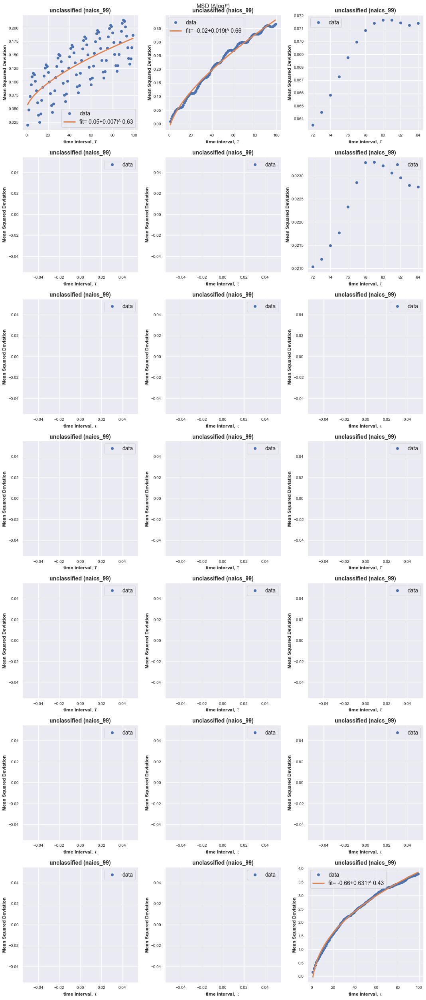

fit unsuccessful for  19 nan


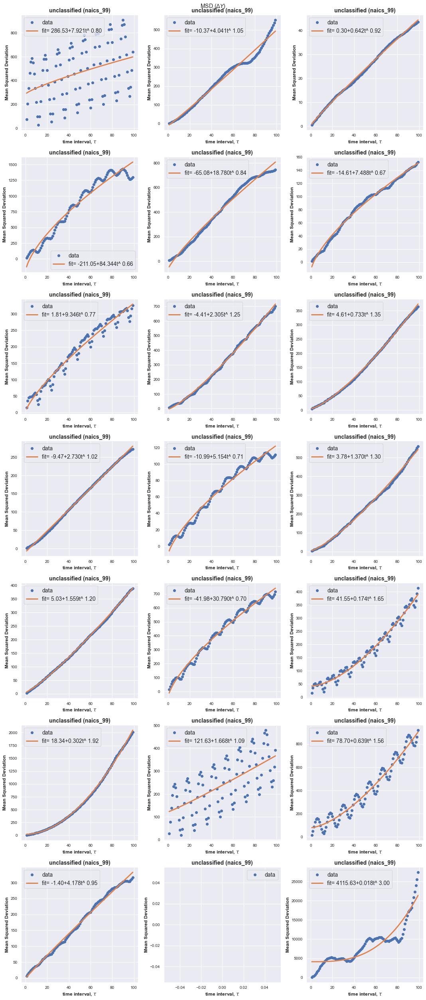

In [63]:
shared_func.fit_temporalMSD_stratified_by_naics(df_metroF_time, df_metro_time,
                            naics_keys_to_plot,  time_stamps_likeCBP_list,
                            taus=np.arange(1,100),
                              remove_imputed_values=True, BLS=True)

## Taylor's law
mean and variance of each naics category across cities for a time point
the mean and variance are indeed related but not well enough to call it a powerlaw.

### cross-sectional variance vs cross-sectional mean

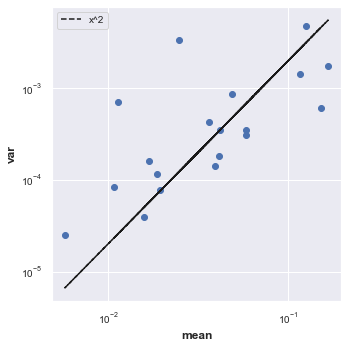

In [6]:
time_point=time_stamps_list[80]

mean_list=[]
var_list=[]
temp_list=deepcopy(naics_keys)
temp_list.remove('naics_92')
temp_list.remove('naics_99')

for naics in temp_list:
    fracs=df_metroF_time[df_metroF_time[naics+'_imputed'+time_point
                                       ]==False][naics+time_point].values
    mean_list.append(np.mean(fracs))
    var_list.append(np.var(fracs))
    
    
fig = plt.figure(figsize=(5,5))
ax1 = fig.add_subplot()
ax1.plot(mean_list,var_list,'o')
ax1.plot(mean_list,.2*np.square(mean_list),'k--',label='x^2')
ax1.legend(loc='best')
ax1.set_xlabel('mean')
ax1.set_ylabel('var')
ax1.set_xscale('log')
ax1.set_yscale('log')

plt.tight_layout()
plt.show()

### temporal variance of individual trajectories
- our predictions should only use cross-sectional variance actually. Because we only see that the cross-sectional distribution is converging to a SSD. The temporal variance will not be reflect the variance relationship of the SSD since timescale is so short.

for total abundance

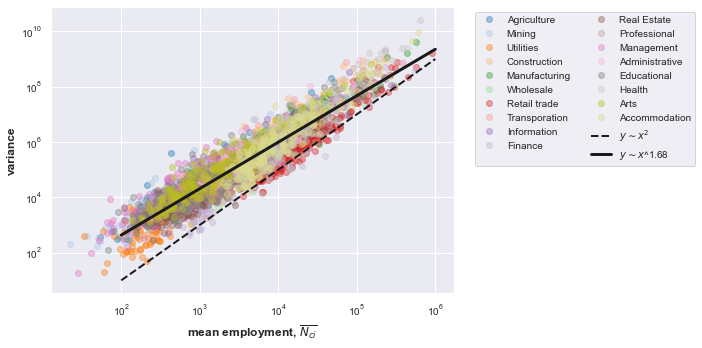

In [3]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
color_list=list(sns.color_palette(palette='tab20'))

variance_list=[]
mean_list=[]
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot()

    
for naics_idx,naics in enumerate(naics_keys_to_plot):
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    naics_key_time=[naics+t for t in time_stamps_list]
    naics_key_time_imputed=[naics+'_imputed'+t for t in time_stamps_list]
    ctr=0
    for idx, row in df_metro_time.iterrows():
        if np.all(row[naics_key_time_imputed].values==False):
            variance_list.append(np.var(row[naics_key_time].values))
            mean_list.append(np.mean(row[naics_key_time].values))
            
            if ctr==0: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx], label=naics_name,alpha=0.4 ) 
                ctr+=1
            else: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx],alpha=0.4 ) 
                

fit_result = scipy.stats.linregress(np.log10(mean_list), np.log10(variance_list))
xdummy=np.linspace(1e2, 1e6,5)                
ax1.plot(xdummy,.001*xdummy**2, 'k--', lw=2, label=r'$y \sim x^2$')

ax1.plot(xdummy,(10.**fit_result.intercept)*(xdummy**fit_result.slope), 'k-',
         lw=3, label=r'$y \sim x$^'+ '{:.2f}'.format(fit_result.slope))
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)       
ax1.set_xlabel(r'mean employment, $\overline{N_{ci}}$')
ax1.set_ylabel(r'variance')
ax1.set_xscale('log')
ax1.set_yscale('log')        
plt.tight_layout()
plt.show()

for fractions

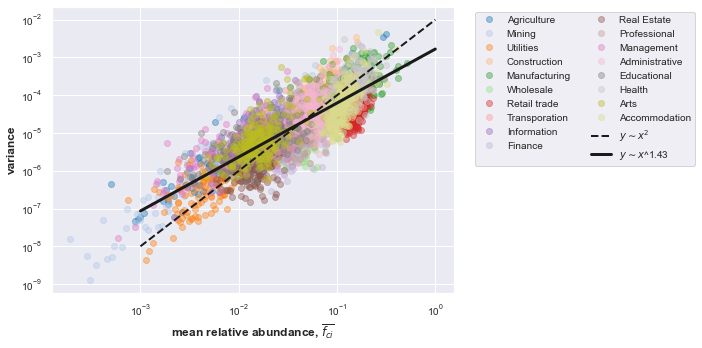

In [16]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
color_list=list(sns.color_palette(palette='tab20'))

variance_list=[]
mean_list=[]
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot()

    
for naics_idx,naics in enumerate(naics_keys_to_plot):
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    naics_key_time=[naics+t for t in time_stamps_list]
    naics_key_time_imputed=[naics+'_imputed'+t for t in time_stamps_list]
    ctr=0
    for idx, row in df_metroF_time.iterrows():
        if np.all(row[naics_key_time_imputed].values==False):
            variance_list.append(np.var(row[naics_key_time].values))
            mean_list.append(np.mean(row[naics_key_time].values))
            
            if ctr==0: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx], label=naics_name,alpha=0.4 ) 
                ctr+=1
            else: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx],alpha=0.4 ) 
fit_result = scipy.stats.linregress(np.log10(mean_list), np.log10(variance_list))
xdummy=np.linspace(1e-3, 1e0,5)                
ax1.plot(xdummy,.01*xdummy**2, 'k--', lw=2, label=r'$y \sim x^2$')
ax1.plot(xdummy,(10.**fit_result.intercept)*(xdummy**fit_result.slope), 'k-',
         lw=3, label=r'$y \sim x$^'+ '{:.2f}'.format(fit_result.slope))
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)       
ax1.set_xlabel(r'mean relative abundance, $\overline{f_{ci}}$')
ax1.set_ylabel(r'variance')
ax1.set_xscale('log')
ax1.set_yscale('log')        
plt.tight_layout()
plt.show()

### for a single sector

In [4]:
naics_keys_to_plot

['naics_11',
 'naics_21',
 'naics_22',
 'naics_23',
 'naics_31-33',
 'naics_42',
 'naics_44-45',
 'naics_48-49',
 'naics_51',
 'naics_52',
 'naics_53',
 'naics_54',
 'naics_55',
 'naics_56',
 'naics_61',
 'naics_62',
 'naics_71',
 'naics_72']

#### for total abundances

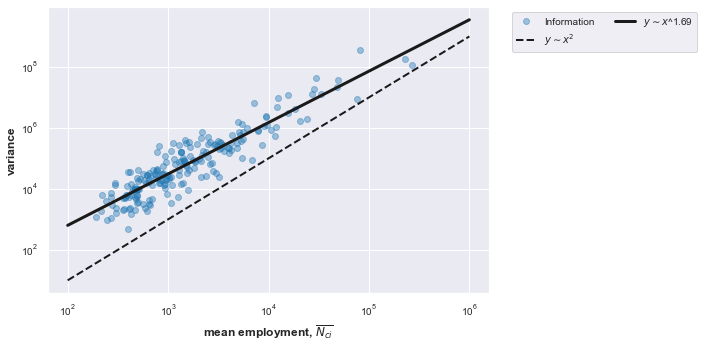

In [5]:
naics_keys_to_plot=['naics_51']
color_list=list(sns.color_palette(palette='tab20'))

variance_list=[]
mean_list=[]
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot()

    
for naics_idx,naics in enumerate(naics_keys_to_plot):
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    naics_key_time=[naics+t for t in time_stamps_list]
    naics_key_time_imputed=[naics+'_imputed'+t for t in time_stamps_list]
    ctr=0
    for idx, row in df_metro_time.iterrows():
        if np.all(row[naics_key_time_imputed].values==False):
            variance_list.append(np.var(row[naics_key_time].values))
            mean_list.append(np.mean(row[naics_key_time].values))
            
            if ctr==0: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx], label=naics_name,alpha=0.4 ) 
                ctr+=1
            else: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx],alpha=0.4 ) 
                

fit_result = scipy.stats.linregress(np.log10(mean_list), np.log10(variance_list))
xdummy=np.linspace(1e2, 1e6,5)                
ax1.plot(xdummy,.001*xdummy**2, 'k--', lw=2, label=r'$y \sim x^2$')

ax1.plot(xdummy,(10.**fit_result.intercept)*(xdummy**fit_result.slope), 'k-',
         lw=3, label=r'$y \sim x$^'+ '{:.2f}'.format(fit_result.slope))
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)       
ax1.set_xlabel(r'mean employment, $\overline{N_{ci}}$')
ax1.set_ylabel(r'variance')
ax1.set_xscale('log')
ax1.set_yscale('log')        
plt.tight_layout()
plt.show()

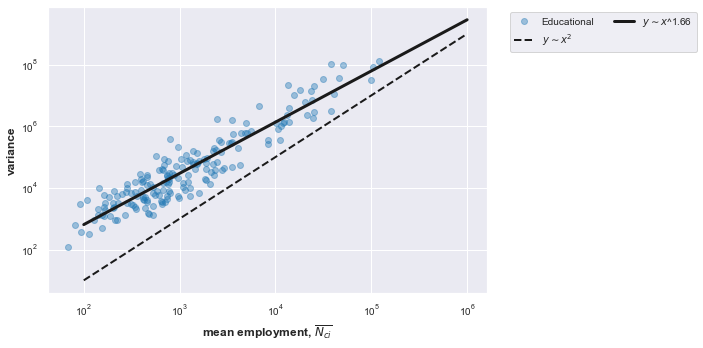

In [9]:
naics_keys_to_plot=['naics_61']
color_list=list(sns.color_palette(palette='tab20'))

variance_list=[]
mean_list=[]
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot()

    
for naics_idx,naics in enumerate(naics_keys_to_plot):
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    naics_key_time=[naics+t for t in time_stamps_list]
    naics_key_time_imputed=[naics+'_imputed'+t for t in time_stamps_list]
    ctr=0
    for idx, row in df_metro_time.iterrows():
        if np.all(row[naics_key_time_imputed].values==False):
            variance_list.append(np.var(row[naics_key_time].values))
            mean_list.append(np.mean(row[naics_key_time].values))
            
            if ctr==0: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx], label=naics_name,alpha=0.4 ) 
                ctr+=1
            else: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx],alpha=0.4 ) 
                

fit_result = scipy.stats.linregress(np.log10(mean_list), np.log10(variance_list))
xdummy=np.linspace(1e2, 1e6,5)                
ax1.plot(xdummy,.001*xdummy**2, 'k--', lw=2, label=r'$y \sim x^2$')

ax1.plot(xdummy,(10.**fit_result.intercept)*(xdummy**fit_result.slope), 'k-',
         lw=3, label=r'$y \sim x$^'+ '{:.2f}'.format(fit_result.slope))
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)       
ax1.set_xlabel(r'mean employment, $\overline{N_{ci}}$')
ax1.set_ylabel(r'variance')
ax1.set_xscale('log')
ax1.set_yscale('log')        
plt.tight_layout()
plt.show()

#### for relative abudances

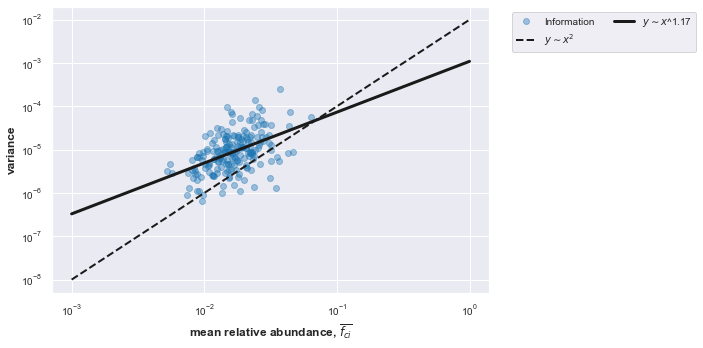

In [6]:
naics_keys_to_plot=['naics_51']
color_list=list(sns.color_palette(palette='tab20'))

variance_list=[]
mean_list=[]
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot()

    
for naics_idx,naics in enumerate(naics_keys_to_plot):
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    naics_key_time=[naics+t for t in time_stamps_list]
    naics_key_time_imputed=[naics+'_imputed'+t for t in time_stamps_list]
    ctr=0
    for idx, row in df_metroF_time.iterrows():
        if np.all(row[naics_key_time_imputed].values==False):
            variance_list.append(np.var(row[naics_key_time].values))
            mean_list.append(np.mean(row[naics_key_time].values))
            
            if ctr==0: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx], label=naics_name,alpha=0.4 ) 
                ctr+=1
            else: ## label only one of them
                ax1.plot(np.mean(row[naics_key_time].values), np.var(row[naics_key_time].values),
                             'o',color= color_list[naics_idx],alpha=0.4 ) 
fit_result = scipy.stats.linregress(np.log10(mean_list), np.log10(variance_list))
xdummy=np.linspace(1e-3, 1e0,5)                
ax1.plot(xdummy,.01*xdummy**2, 'k--', lw=2, label=r'$y \sim x^2$')
ax1.plot(xdummy,(10.**fit_result.intercept)*(xdummy**fit_result.slope), 'k-',
         lw=3, label=r'$y \sim x$^'+ '{:.2f}'.format(fit_result.slope))
ax1.legend(loc='upper left',bbox_to_anchor=(1.04,1),ncol=2)       
ax1.set_xlabel(r'mean relative abundance, $\overline{f_{ci}}$')
ax1.set_ylabel(r'variance')
ax1.set_xscale('log')
ax1.set_yscale('log')        
plt.tight_layout()
plt.show()

# Fits with AFD and log_g sharing shape constraints

## fit AFD with log_g shape parameter

using the log_g shape parameter did not do a good job at fitting the distribution

t/tau=  4.14e-03 ;  b/d=  1.27e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.26e-03 ;  b/d=  1.05e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.40e-03 ;  b/d=  1.06e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.47e-03 ;  b/d=  1.90e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.29e-04 ;  b/d=  1.43e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.38e-04 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.63e-04 ;  b/d=  2.39e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.52e-03 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.57e-03 ;  b/d=  1.41e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.31e-04 ;  b/d=  1.38e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.58e+00 loc & scale are fixed= 0.0 1.0
t/tau=  9.93e-04 ;  b/d=  1.33e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.47e-03 ;  b/d=  8.29e-01 loc & scale are fixed= 0.0 1.0
t/tau=  2.73e-03 ;  b/d=  1.36e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.03e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.

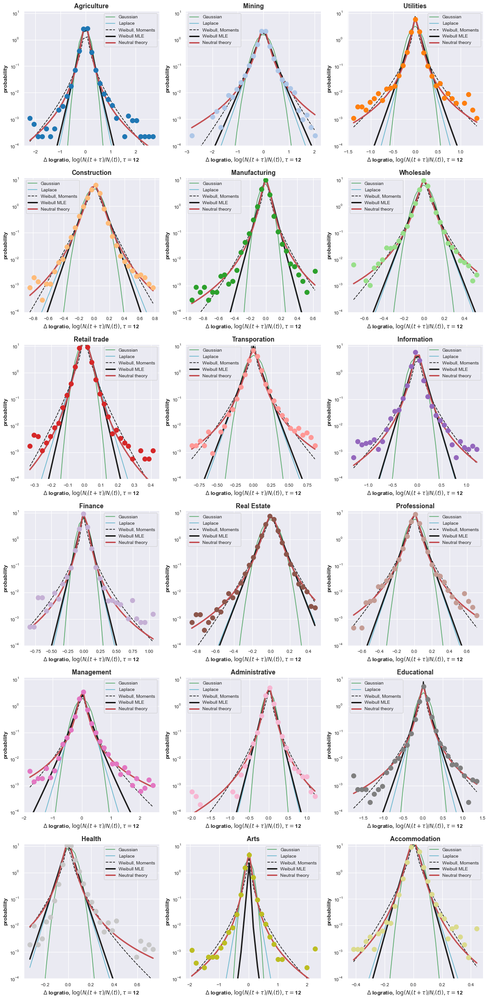

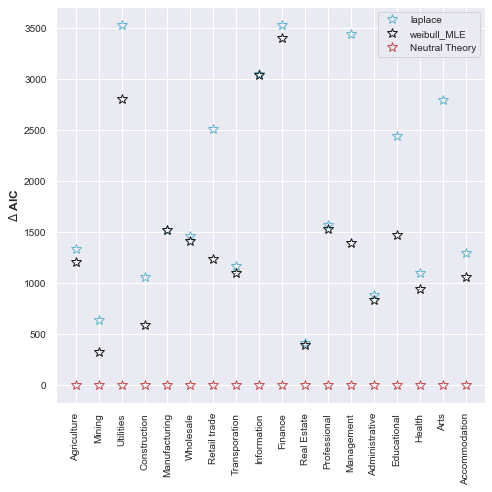

In [6]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_logg_F_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')
with open(fit_params_path+'log_growth_F_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_logg_F_fit, handle)

In [26]:
Delta_t=12
with open(fit_params_path+'log_growth_F_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_F_fitvals = pickle.load(handle)
    
shape_param_dict={}

for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(logG_F_fitvals['naics'])==naics_code)[0][0]
    temp=logG_F_fitvals['NeutralTheory'][idx]   
    shape_param_dict.update({naics:logG_F_fitvals['NeutralTheory'][idx][1]})
    
    


Agriculture
gamma shape=  1.2682580888218213 scale=  0.02149433780697118
Mining
gamma shape=  1.0507847429587847 scale=  0.012738831736898966
Utilities
gamma shape=  1.063624808490745 scale=  0.0049854730427522104
Construction
gamma shape=  1.9032483434660448 scale=  0.0278254389900505
Manufacturing
gamma shape=  1.4275662841176353 scale=  0.0877325664061866
Wholesale
gamma shape=  1.3044657659413343 scale=  0.031179030212358624
Retail trade
gamma shape=  2.3935004597426373 scale=  0.06281977718468951
Transporation
gamma shape=  1.2959001902533192 scale=  0.028642196900803867
Information
gamma shape=  1.4131615113265397 scale=  0.012558742181627204
Finance
gamma shape=  1.379903247815923 scale=  0.028139627116887243
Real Estate
gamma shape=  1.5756717869228396 scale=  0.009497868968886698
Professional
gamma shape=  1.3321137921785051 scale=  0.03626661245984184
Management
gamma shape=  0.829485605516324 scale=  0.0144155841965825
Administrative
gamma shape=  1.362318915149717 scale=  0

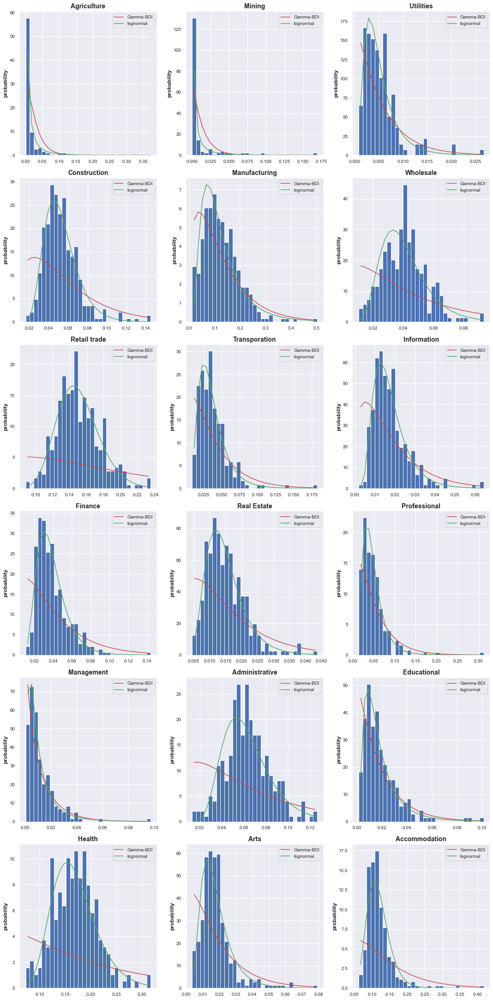

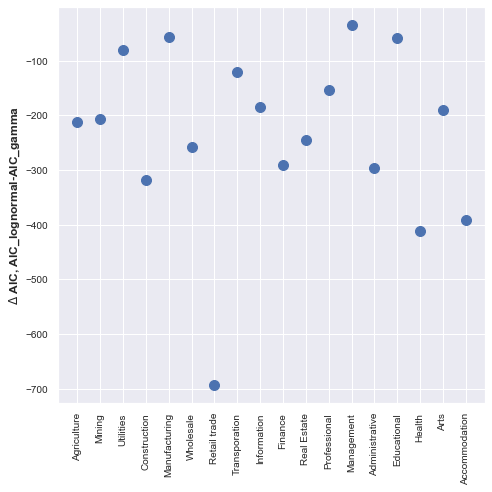

In [29]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
time_stamp='12-Q2-M2'

shared_func.plot_abundance_fit_by_naics(df_metroF_time, naics_keys_to_plot, time_stamp,
                             remove_imputed_values=True,
                            Gamma_shape=shape_param_dict)

### Fit AFD of emp/total population rather than emp/total employment.

Agriculture
gamma shape=  1.2682580888218213 scale=  0.006332054748313643
Mining
gamma shape=  1.0507847429587847 scale=  0.004354344416982546
Utilities
gamma shape=  1.063624808490745 scale=  0.0015600878359742455
Construction
gamma shape=  1.9032483434660448 scale=  0.009226299006398112
Manufacturing
gamma shape=  1.4275662841176353 scale=  0.030234199261278877
Wholesale
gamma shape=  1.3044657659413343 scale=  0.010613187272499514
Retail trade
gamma shape=  2.3935004597426373 scale=  0.020647183101431474
Transporation
gamma shape=  1.2959001902533192 scale=  0.00946274552758131
Information
gamma shape=  1.4131615113265397 scale=  0.004335308829434015
Finance
gamma shape=  1.379903247815923 scale=  0.009710449336069515
Real Estate
gamma shape=  1.5756717869228396 scale=  0.0031423096792602195
Professional
gamma shape=  1.3321137921785051 scale=  0.012126516891010528
Management
gamma shape=  0.829485605516324 scale=  0.0050202828939158095
Administrative
gamma shape=  1.362318915149717

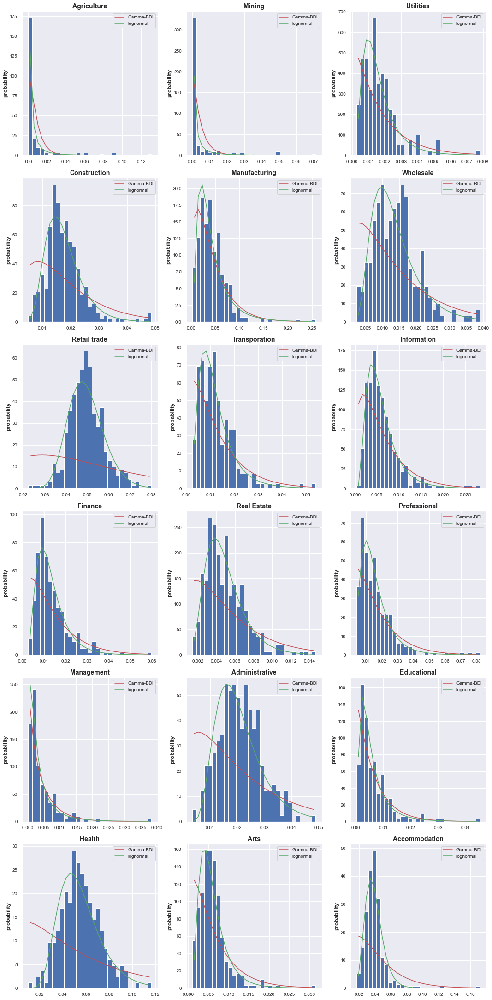

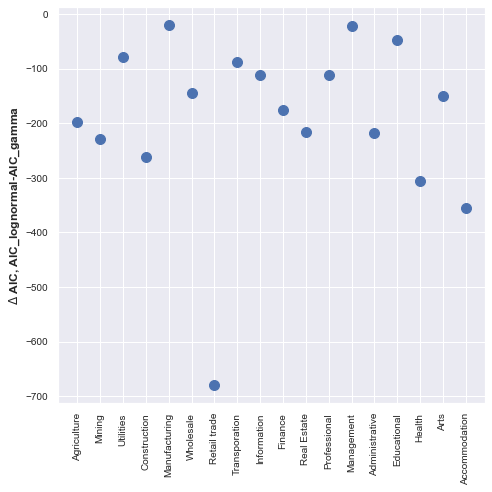

In [28]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
time_stamp='12-Q2-M2'

shared_func.plot_abundance_fit_by_naics(df_metroX_time, naics_keys_to_plot, time_stamp,
                             remove_imputed_values=True,
                            Gamma_shape=shape_param_dict)

### distribution of fit parameters

In [13]:
with open(fit_params_path+'log_growth_F_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_F_fitvals = pickle.load(handle)

In [18]:
logG_F_fitvals ['NeutralTheory']

[array([0.0041361 , 1.26825809, 0.        , 1.        ]),
 array([0.00826153, 1.05078474, 0.        , 1.        ]),
 array([0.00140236, 1.06362481, 0.        , 1.        ]),
 array([0.00346629, 1.90324834, 0.        , 1.        ]),
 array([8.29301267e-04, 1.42756628e+00, 0.00000000e+00, 1.00000000e+00]),
 array([8.38223778e-04, 1.30446577e+00, 0.00000000e+00, 1.00000000e+00]),
 array([5.63433146e-04, 2.39350046e+00, 0.00000000e+00, 1.00000000e+00]),
 array([0.00152294, 1.29590019, 0.        , 1.        ]),
 array([0.00257113, 1.41316151, 0.        , 1.        ]),
 array([8.31213652e-04, 1.37990325e+00, 0.00000000e+00, 1.00000000e+00]),
 array([0.00167254, 1.57567179, 0.        , 1.        ]),
 array([9.93354183e-04, 1.33211379e+00, 0.00000000e+00, 1.00000000e+00]),
 array([0.00246584, 0.82948561, 0.        , 1.        ]),
 array([0.00272561, 1.36231892, 0.        , 1.        ]),
 array([0.00166756, 1.03207474, 0.        , 1.        ]),
 array([3.82564706e-04, 1.21811760e+00, 0.00000000

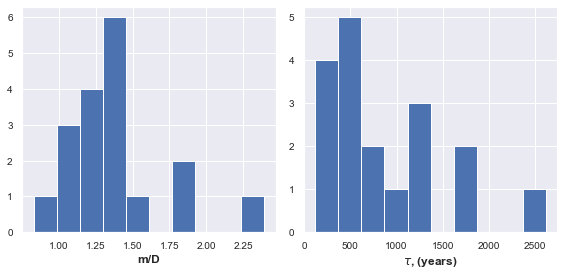

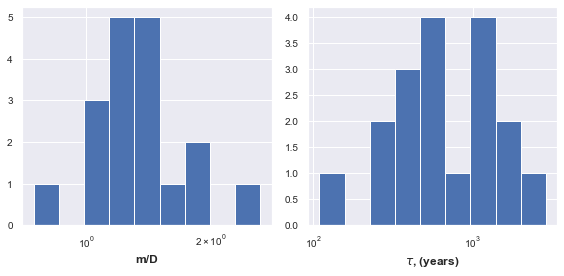

In [24]:
Delta_t=12
with open(fit_params_path+'log_growth_F_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_F_fitvals = pickle.load(handle)

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
ax1.hist(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])
ax1.set_xlabel('m/D')
ax2.hist(1./np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ax2.set_xlabel(r'$\tau$, (years)')
fig.tight_layout()


fig2 = plt.figure(figsize=(8, 4))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
lb=np.min(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])*.9
ub=np.max(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])*1.1

ax1.hist(np.array(logG_F_fitvals ['NeutralTheory'])[:,1],
        bins=np.logspace(np.log10(lb),np.log10(ub), 10))
ax1.set_xlabel('m/D')
ax1.set_xscale('log')

lb=.9/np.max(np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ub=1.1/np.min(np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ax2.hist(1./np.array(logG_F_fitvals ['NeutralTheory'])[:,0],
        bins=np.logspace(np.log10(lb),np.log10(ub), 10) )
ax2.set_xscale('log')
ax1.set_xlabel('m/D')
ax2.set_xlabel(r'$\tau$, (years)')
fig2.tight_layout()

## Fit log_g with shape from AFD

the fits of the log_g distribution don't look that terrible although the AIC is significantly worse... but gives hope for a simultaneous fit to succeed somewhat.

Also, upon aggregation of different shape parameters, if different trajectories dominate the AFD and log_g distribution then that would justify a free shape parameter..
A test of this would be from a BDI model simulation?

Agriculture
gamma shape=  0.5165415160763834 scale=  0.04756477007939157
Mining
gamma shape=  0.4365182283385942 scale=  0.023919499883458248
Utilities
gamma shape=  2.5828118976753878 scale=  0.00198704101232886
Construction
gamma shape=  9.085601270844343 scale=  0.006562695959616484
Manufacturing
gamma shape=  2.912503649937725 scale=  0.04209566251388651
Wholesale
gamma shape=  7.21472512756462 scale=  0.005386978920180725
Retail trade
gamma shape=  35.83934394479371 scale=  0.00407210173012195
Transporation
gamma shape=  3.6750559324768384 scale=  0.01021374381608854
Information
gamma shape=  3.7283354384941587 scale=  0.004111207389198497
Finance
gamma shape=  4.9380754890458745 scale=  0.0076308030610650725
Real Estate
gamma shape=  6.74565658618128 scale=  0.0022734560962844753
Professional
gamma shape=  3.8207732857292824 scale=  0.012671324164590872
Management
gamma shape=  1.4337711065510008 scale=  0.008829144756156012
Administrative
gamma shape=  10.127359947158078 scale= 

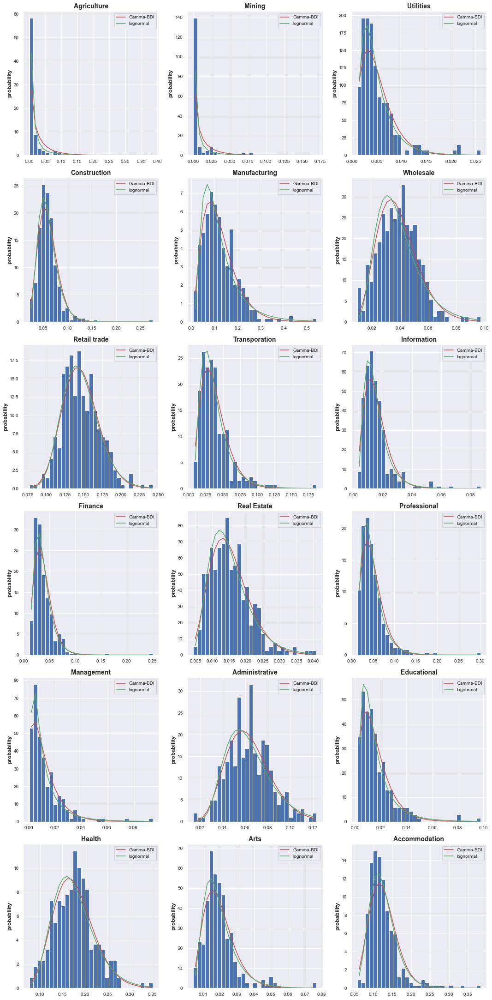

In [18]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
# time_stamp='12-Q2-M2'
time_stamp='17-Q3-M2'
AFD_fit_vals=shared_func.plot_abundance_fit_by_naics(df_metroF_time, naics_keys_to_plot, time_stamp,
                             remove_imputed_values=True,return_fit_vals=True)

with open(fit_params_path+'AFD_fit_vals-T'+time_stamp+'.pkl', 'wb') as handle:
    pickle.dump(AFD_fit_vals, handle)

for X instead of F:

Agriculture
gamma shape=  0.5361600027763683 scale=  0.014978140129488523
Mining
gamma shape=  0.38593917653602133 scale=  0.011855439813133289
Utilities
gamma shape=  2.955945740161207 scale=  0.0005613594671992703
Construction
gamma shape=  8.171391552954006 scale=  0.002148953233540938
Manufacturing
gamma shape=  2.391831067994785 scale=  0.0180453059876343
Wholesale
gamma shape=  4.636187958028217 scale=  0.0029861902903496646
Retail trade
gamma shape=  36.04003260666981 scale=  0.001371226346685403
Transporation
gamma shape=  3.3066051041574824 scale=  0.003708569164818942
Information
gamma shape=  3.309933453990822 scale=  0.0018509410121473856
Finance
gamma shape=  3.923210904772894 scale=  0.003415437227780127
Real Estate
gamma shape=  5.902033317051782 scale=  0.000838905584128109
Professional
gamma shape=  3.0920414955447035 scale=  0.005224347870129411
Management
gamma shape=  1.1960532197541602 scale=  0.0034816614573212126
Administrative
gamma shape=  6.606031057205132 sca

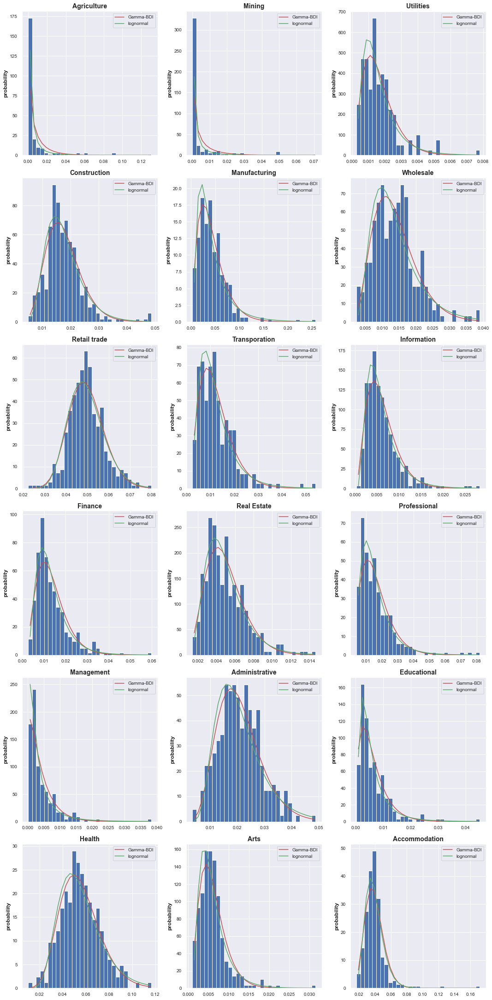

In [31]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
time_stamp='12-Q2-M2'

AFD_fit_vals=shared_func.plot_abundance_fit_by_naics(df_metroX_time, naics_keys_to_plot, time_stamp,
                             remove_imputed_values=True,return_fit_vals=True)

with open(fit_params_path+'AFD_X_fit_vals-T'+time_stamp+'.pkl', 'wb') as handle:
    pickle.dump(AFD_fit_vals, handle)

0.6099968155894884
0.6099968155894884
t/tau=  1.24e-03 ;  b/d=  6.10e-01 loc & scale are fixed= 0.0 1.0
0.393797856540711


KeyboardInterrupt: 

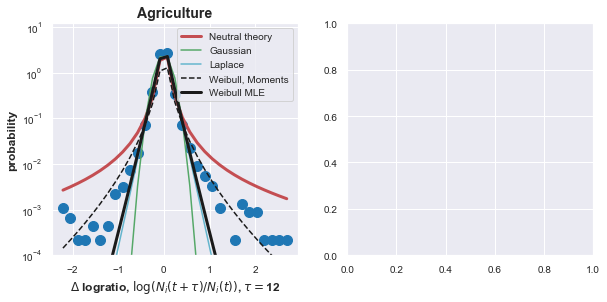

In [7]:
time_stamp='12-Q2-M2'
with open(fit_params_path+'AFD_fit_vals-T'+time_stamp+'.pkl', 'rb') as handle:
    AFD_fit_vals = pickle.load(handle)
shape_param_dict={}

for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(AFD_fit_vals['naics'])==naics_code)[0][0]  
    shape_param_dict.update({naics:AFD_fit_vals['shape'][idx]})

Delta_t=12

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                Gamma_shape=shape_param_dict,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')


0.5109833270312925
0.5109833270312925
t/tau=  9.16e-04 ;  b/d=  5.11e-01 loc & scale are fixed= 0.0 1.0
0.4032470326458775
0.4032470326458775
t/tau=  1.50e-03 ;  b/d=  4.03e-01 loc & scale are fixed= 0.0 1.0
2.849355312069743
2.849355312069743
t/tau=  6.44e-03 ;  b/d=  2.85e+00 loc & scale are fixed= 0.0 1.0
9.790887001450372
9.790887001450372
t/tau=  2.88e-02 ;  b/d=  9.79e+00 loc & scale are fixed= 0.0 1.0
3.028806929707838
3.028806929707838
t/tau=  2.49e-03 ;  b/d=  3.03e+00 loc & scale are fixed= 0.0 1.0
7.833450224757801
7.833450224757801
t/tau=  1.05e-02 ;  b/d=  7.83e+00 loc & scale are fixed= 0.0 1.0
37.026185159170254
37.026185159170254
t/tau=  1.41e-02 ;  b/d=  3.70e+01 loc & scale are fixed= 0.0 1.0
3.9941561837825215
3.9941561837825215
t/tau=  7.96e-03 ;  b/d=  3.99e+00 loc & scale are fixed= 0.0 1.0
4.761014519036514
4.761014519036514
t/tau=  1.43e-02 ;  b/d=  4.76e+00 loc & scale are fixed= 0.0 1.0
6.338409226813436
6.338409226813436
t/tau=  7.03e-03 ;  b/d=  6.34e+00 loc

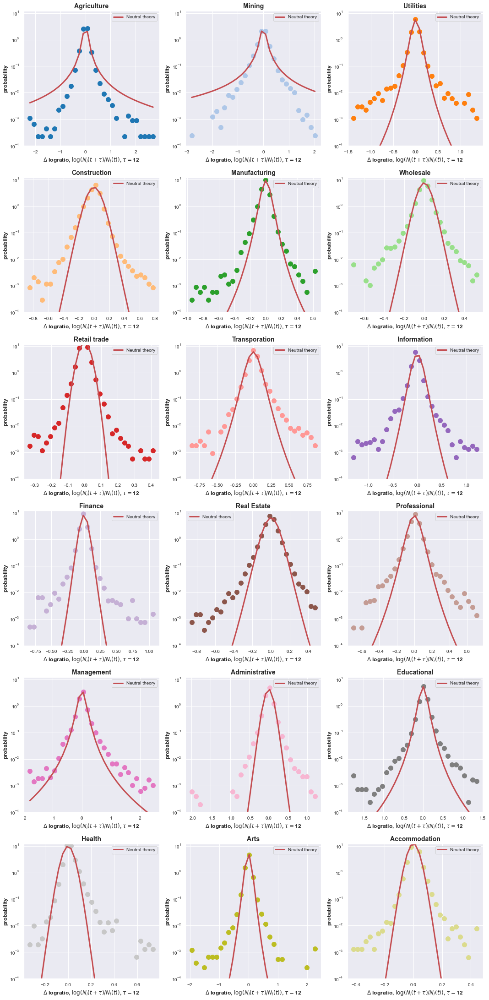

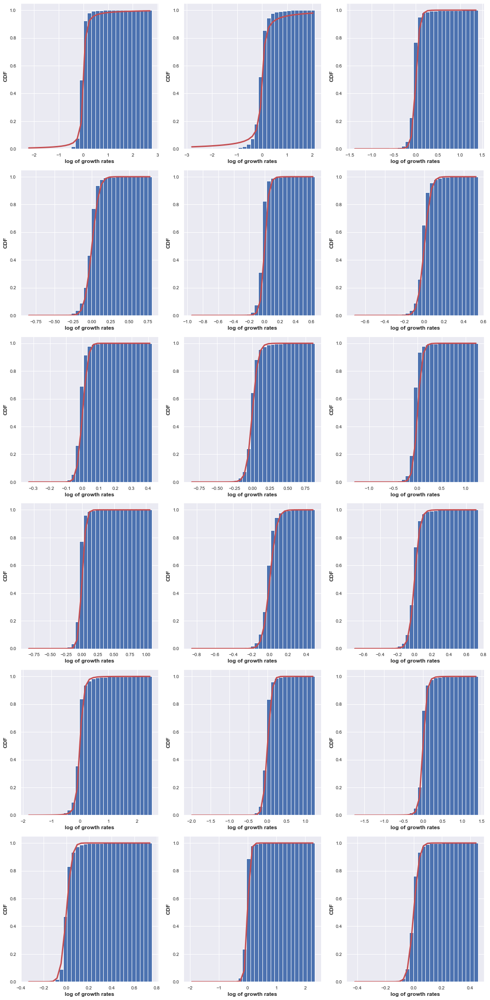

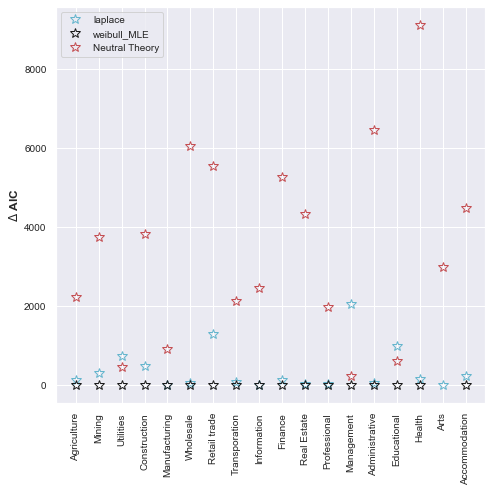

In [5]:
time_stamp='12-Q2-M2'
with open(fit_params_path+'AFD_fit_vals-T'+time_stamp+'.pkl', 'rb') as handle:
    AFD_fit_vals = pickle.load(handle)
    
shape_param_dict={}
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(AFD_fit_vals['naics'])==naics_code)[0][0]  
    shape_param_dict.update({naics:AFD_fit_vals['shape'][idx]})

Delta_t=12



# naics_keys_to_plot=['naics_22']
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                Gamma_shape=shape_param_dict,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True, plot_cdf=True)

with open(fit_params_path+'logG_usingAFD_fit-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit, handle)

### fit AFD of average F
the inferred shape of average F was just a little larger than the inferred shape usually. Didnt really change results very much

Agriculture
gamma shape=  0.5323647951159014 scale=  0.04632410622331562
Mining
gamma shape=  0.45466624392888727 scale=  0.028939728155318343
Utilities
gamma shape=  3.127206740927727 scale=  0.0016187711584300117
Construction
gamma shape=  10.23630309610767 scale=  0.005910295347560443
Manufacturing
gamma shape=  3.1499784106589317 scale=  0.04186996911853999
Wholesale
gamma shape=  8.005984503744806 scale=  0.0050300180071713016
Retail trade
gamma shape=  41.01015337698915 scale=  0.003694942866062018
Transporation
gamma shape=  3.8485046262106746 scale=  0.00973119275218659
Information
gamma shape=  5.500823796717091 scale=  0.003372469578867912
Finance
gamma shape=  6.442154397788714 scale=  0.0061762888433091
Real Estate
gamma shape=  7.217256558772316 scale=  0.002161840402057364
Professional
gamma shape=  3.9779120259009693 scale=  0.012237390100975075
Management
gamma shape=  1.7445542201021085 scale=  0.006389641778054754
Administrative
gamma shape=  10.186995002652232 scale=

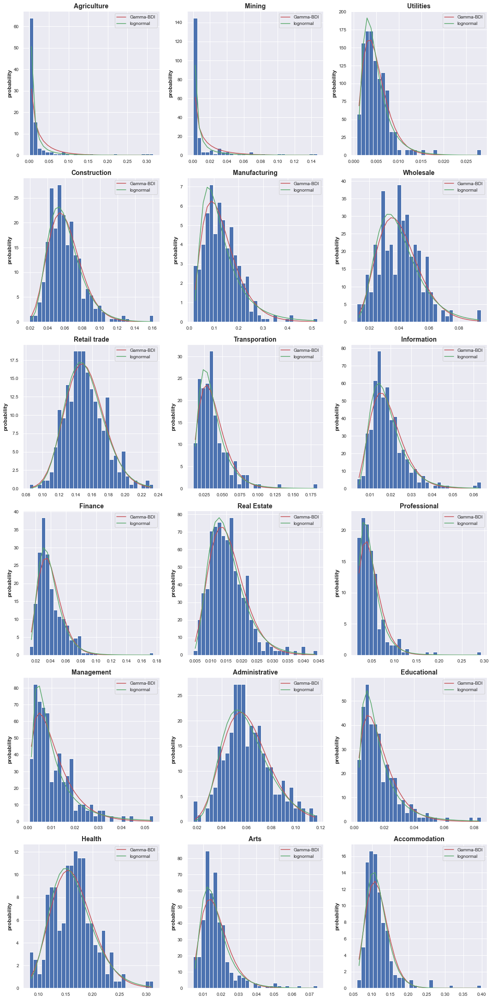

In [20]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
# time_stamp='12-Q2-M2'
time_stamp='_avg'
AFD_fit_vals=shared_func.plot_abundance_fit_by_naics(df_metroFavg_time, naics_keys_to_plot, time_stamp,
                             remove_imputed_values=True,return_fit_vals=True)

with open(fit_params_path+'AFD_fitavg_vals-T'+time_stamp+'.pkl', 'wb') as handle:
    pickle.dump(AFD_fit_vals, handle)

### Larger time interval makes fit look better, but miss drift

##### for 5 year time interval

0.5109833270312925
0.5109833270312925
t/tau=  4.94e-03 ;  b/d=  5.11e-01 loc & scale are fixed= 0.0 1.0
naics_11 Agriculture how many weibull infinities 6
nan nan nan
nan
0.4032470326458775
0.4032470326458775
t/tau=  1.02e-02 ;  b/d=  4.03e-01 loc & scale are fixed= 0.0 1.0
2.849355312069743
2.849355312069743
t/tau=  4.35e-02 ;  b/d=  2.85e+00 loc & scale are fixed= 0.0 1.0
9.790887001450372
9.790887001450372
t/tau=  2.76e-01 ;  b/d=  9.79e+00 loc & scale are fixed= 0.0 1.0
3.028806929707838
3.028806929707838
t/tau=  2.44e-02 ;  b/d=  3.03e+00 loc & scale are fixed= 0.0 1.0
7.833450224757801
7.833450224757801
t/tau=  5.53e-02 ;  b/d=  7.83e+00 loc & scale are fixed= 0.0 1.0
37.026185159170254
37.026185159170254
t/tau=  6.80e-02 ;  b/d=  3.70e+01 loc & scale are fixed= 0.0 1.0
3.9941561837825215
3.9941561837825215
t/tau=  4.39e-02 ;  b/d=  3.99e+00 loc & scale are fixed= 0.0 1.0
4.761014519036514
4.761014519036514
t/tau=  1.40e-01 ;  b/d=  4.76e+00 loc & scale are fixed= 0.0 1.0
6.33840

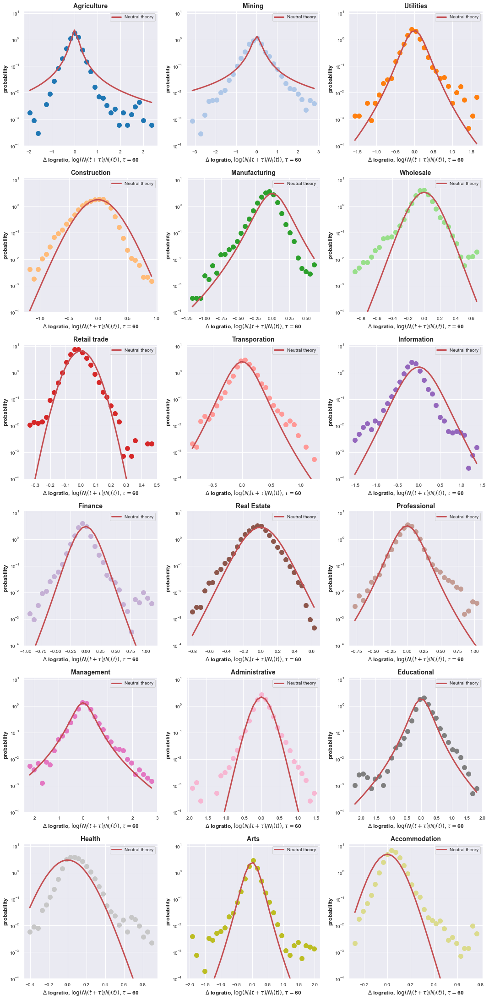

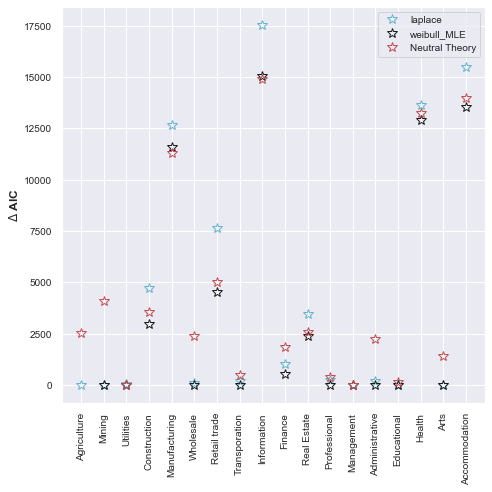

In [28]:
time_stamp='12-Q2-M2'
with open(fit_params_path+'AFD_fit_vals-T'+time_stamp+'.pkl', 'rb') as handle:
    AFD_fit_vals = pickle.load(handle)
    
shape_param_dict={}

for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(AFD_fit_vals['naics'])==naics_code)[0][0]  
    shape_param_dict.update({naics:AFD_fit_vals['shape'][idx]})

Delta_t=60

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

# naics_keys_to_plot=['naics_22']
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                Gamma_shape=shape_param_dict,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

with open(fit_params_path+'logG_usingAFD_fit-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit, handle)

##### for 2 year time interval 

0.5109833270312925
0.5109833270312925
t/tau=  1.90e-03 ;  b/d=  5.11e-01 loc & scale are fixed= 0.0 1.0
0.4032470326458775
0.4032470326458775
t/tau=  3.62e-03 ;  b/d=  4.03e-01 loc & scale are fixed= 0.0 1.0
2.849355312069743
2.849355312069743
t/tau=  1.58e-02 ;  b/d=  2.85e+00 loc & scale are fixed= 0.0 1.0
9.790887001450372
9.790887001450372
t/tau=  7.46e-02 ;  b/d=  9.79e+00 loc & scale are fixed= 0.0 1.0
3.028806929707838
3.028806929707838
t/tau=  6.60e-03 ;  b/d=  3.03e+00 loc & scale are fixed= 0.0 1.0
7.833450224757801
7.833450224757801
t/tau=  2.24e-02 ;  b/d=  7.83e+00 loc & scale are fixed= 0.0 1.0
37.026185159170254
37.026185159170254
t/tau=  2.92e-02 ;  b/d=  3.70e+01 loc & scale are fixed= 0.0 1.0
3.9941561837825215
3.9941561837825215
t/tau=  1.72e-02 ;  b/d=  3.99e+00 loc & scale are fixed= 0.0 1.0
4.761014519036514
4.761014519036514
t/tau=  3.70e-02 ;  b/d=  4.76e+00 loc & scale are fixed= 0.0 1.0
6.338409226813436
6.338409226813436
t/tau=  1.69e-02 ;  b/d=  6.34e+00 loc

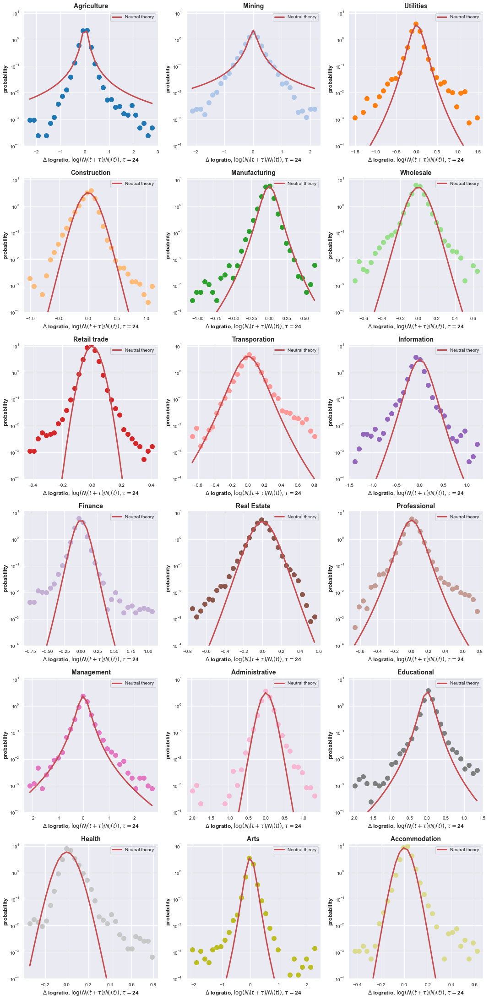

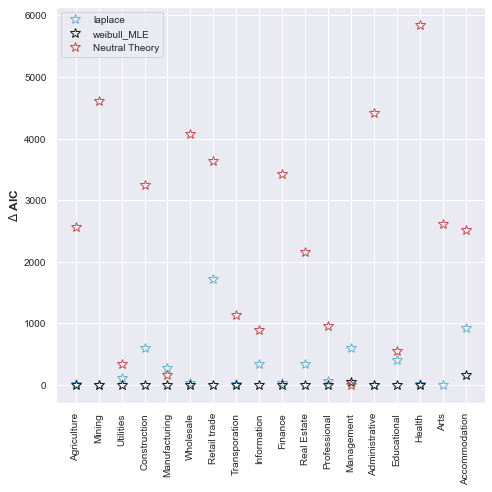

In [35]:
time_stamp='12-Q2-M2'
with open(fit_params_path+'AFD_fit_vals-T'+time_stamp+'.pkl', 'rb') as handle:
    AFD_fit_vals = pickle.load(handle)
    
shape_param_dict={}

for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(AFD_fit_vals['naics'])==naics_code)[0][0]  
    shape_param_dict.update({naics:AFD_fit_vals['shape'][idx]})

Delta_t=24

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

# naics_keys_to_plot=['naics_22']
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                Gamma_shape=shape_param_dict,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

with open(fit_params_path+'logG_usingAFD_fit-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit, handle)

### using fit of AFD of X rather than F to fit log_g

AFD of X mostly just changes the inferred scale parameter and doesn't affect the shape very much

0.5361600027763683
0.5361600027763683
t/tau=  9.96e-04 ;  b/d=  5.36e-01 loc & scale are fixed= 0.0 1.0
0.38593917653602133
0.38593917653602133
t/tau=  1.38e-03 ;  b/d=  3.86e-01 loc & scale are fixed= 0.0 1.0
2.955945740161207
2.955945740161207
t/tau=  6.80e-03 ;  b/d=  2.96e+00 loc & scale are fixed= 0.0 1.0
8.171391552954006
8.171391552954006
t/tau=  2.32e-02 ;  b/d=  8.17e+00 loc & scale are fixed= 0.0 1.0
2.391831067994785
2.391831067994785
t/tau=  1.78e-03 ;  b/d=  2.39e+00 loc & scale are fixed= 0.0 1.0
4.636187958028217
4.636187958028217
t/tau=  5.29e-03 ;  b/d=  4.64e+00 loc & scale are fixed= 0.0 1.0
36.04003260666981
36.04003260666981
t/tau=  1.37e-02 ;  b/d=  3.60e+01 loc & scale are fixed= 0.0 1.0
3.3066051041574824
3.3066051041574824
t/tau=  6.12e-03 ;  b/d=  3.31e+00 loc & scale are fixed= 0.0 1.0
3.309933453990822
3.309933453990822
t/tau=  8.75e-03 ;  b/d=  3.31e+00 loc & scale are fixed= 0.0 1.0
3.923210904772894
3.923210904772894
t/tau=  3.72e-03 ;  b/d=  3.92e+00 loc

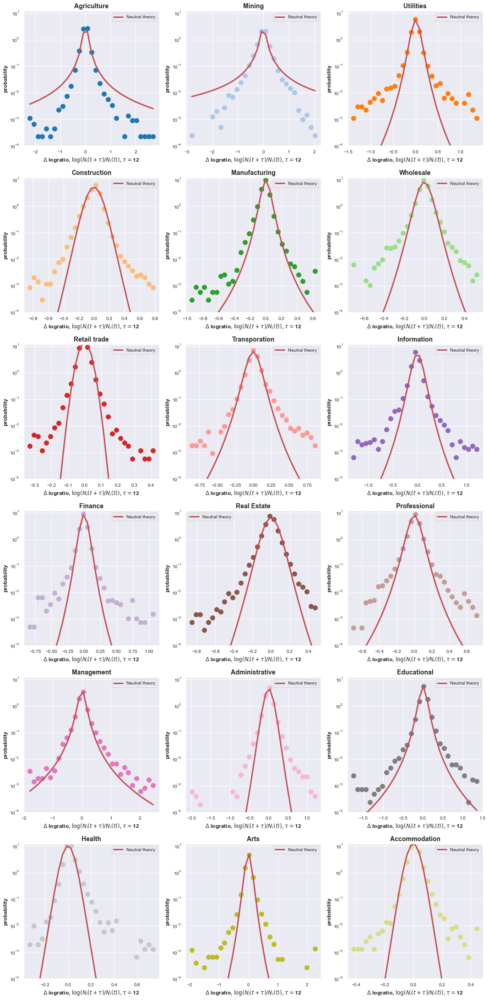

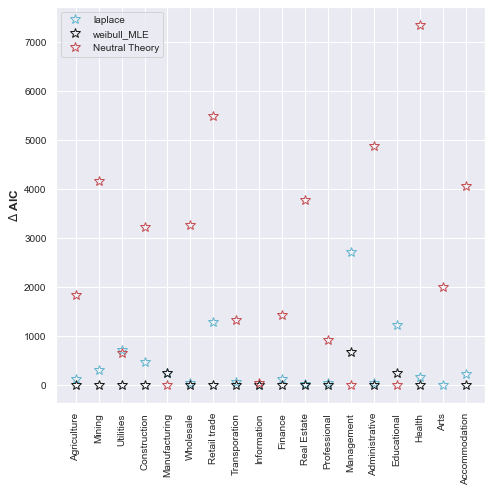

In [32]:
time_stamp='12-Q2-M2'
with open(fit_params_path+'AFD_X_fit_vals-T'+time_stamp+'.pkl', 'rb') as handle:
    AFD_fit_vals = pickle.load(handle)
    
shape_param_dict={}

for naics in naics_keys_to_plot:
    naics_code=naics.replace('naics_','')
    idx= np.where(np.array(AFD_fit_vals['naics'])==naics_code)[0][0]  
    shape_param_dict.update({naics:AFD_fit_vals['shape'][idx]})

Delta_t=12

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

# naics_keys_to_plot=['naics_22']
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                Gamma_shape=shape_param_dict,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)


### distribution of fit parameters
when constrained to use shape from AFD, 
time scale is closer to 100 years if Delta t is 5 years
and larger if Delta t is 1 year...

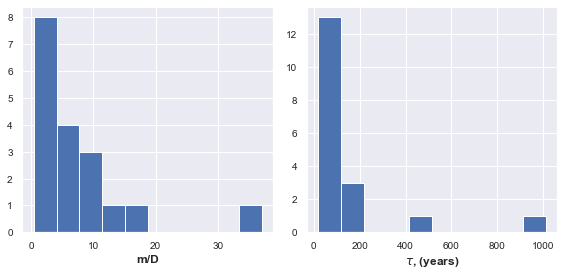

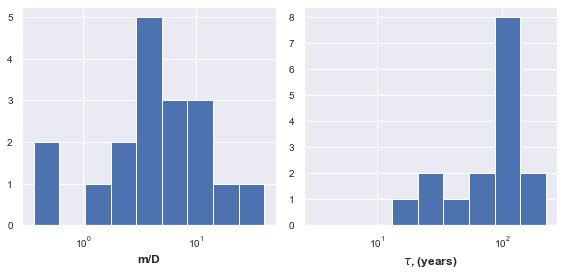

In [32]:
Delta_t=60
with open(fit_params_path+'logG_usingAFD_fit-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_F_fitvals = pickle.load(handle)

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
ax1.hist(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])
ax1.set_xlabel('m/D')
ax2.hist(Delta_t/12  *   1./np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ax2.set_xlabel(r'$\tau$, (years)')
fig.tight_layout()


fig2 = plt.figure(figsize=(8, 4))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
lb=np.min(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])*.9
ub=np.max(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])*1.1

ax1.hist(np.array(logG_F_fitvals ['NeutralTheory'])[:,1],
        bins=np.logspace(np.log10(lb),np.log10(ub), 10))
ax1.set_xlabel('m/D')
ax1.set_xscale('log')

lb=.9/np.max(np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ub=1.1/np.min(np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ax2.hist(Delta_t/12  * 1./np.array(logG_F_fitvals ['NeutralTheory'])[:,0],
        bins=np.logspace(np.log10(lb),np.log10(ub), 10) )
ax2.set_xscale('log')
ax1.set_xlabel('m/D')
ax2.set_xlabel(r'$\tau$, (years)')
fig2.tight_layout()

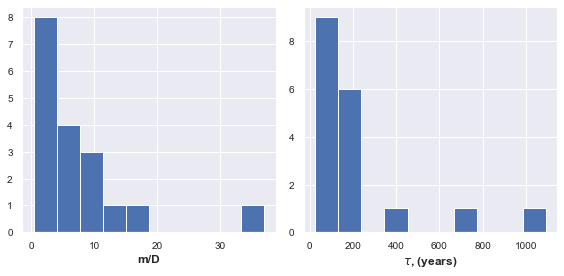

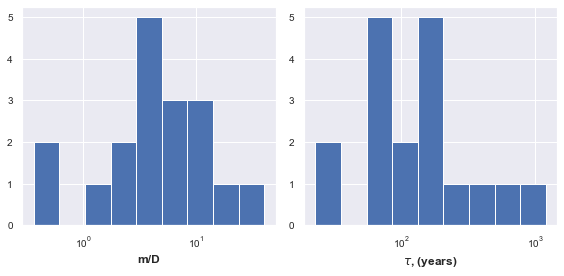

In [33]:
Delta_t=12
with open(fit_params_path+'logG_usingAFD_fit-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    logG_F_fitvals = pickle.load(handle)

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
ax1.hist(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])
ax1.set_xlabel('m/D')
ax2.hist(Delta_t/12  *   1./np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ax2.set_xlabel(r'$\tau$, (years)')
fig.tight_layout()


fig2 = plt.figure(figsize=(8, 4))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
lb=np.min(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])*.9
ub=np.max(np.array(logG_F_fitvals ['NeutralTheory'])[:,1])*1.1

ax1.hist(np.array(logG_F_fitvals ['NeutralTheory'])[:,1],
        bins=np.logspace(np.log10(lb),np.log10(ub), 10))
ax1.set_xlabel('m/D')
ax1.set_xscale('log')

lb=.9/np.max(np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ub=1.1/np.min(np.array(logG_F_fitvals ['NeutralTheory'])[:,0])
ax2.hist(Delta_t/12  * 1./np.array(logG_F_fitvals ['NeutralTheory'])[:,0],
        bins=np.logspace(np.log10(lb),np.log10(ub), 10) )
ax2.set_xscale('log')
ax1.set_xlabel('m/D')
ax2.set_xlabel(r'$\tau$, (years)')
fig2.tight_layout()

## Simultaneous fit of AFD and log_g  for each sector.

the two distribution fits have very different number of data points.. so we need to  correct for that in some way when fitting simultaneously..

for tau=12 we have 47000 points in time series but only 260 in cross-sectional.
47000 because each month in each year will contribute a point. so ~ 12x 18x 260


we can do something like minimize ( logL_temporal +w * logL_crossSect) where w is a weighting factor??

Other option is to use logL_crossSect of every year, but this looks like resampling correlated points  and so will bias in a bad way I think...


https://rlhick.people.wm.edu/posts/estimating-custom-mle.html

https://ben.land/post/2021/01/09/maximum-likelihood-python/

https://python.quantecon.org/mle.html

In [33]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
# naics_keys_to_plot=['naics_42']
# naics_keys_to_plot=['naics_11']
time_stamp='12-Q2-M2'
remove_imputed_values=True
# shared_func.plot_abundance_fit_by_naics(df_metroF_time, naics_keys_to_plot, year,
#                              remove_imputed_values=True)

df_new=deepcopy(df_metroF_time)

In [34]:
class LikelihoodFunction_gamma:   
    def __init__(self,data):
        self.data=data

    def __call__(self,*params):
        '''Evaluates the likelihood function and returns loglikelihood
        '''
        return np.sum(scipy.stats.gamma.logpdf(self.data, params[0],loc=0, scale= params[1]))  
    
    
logG_BDI_inst = shared_func.azaele_neutral_logG_distribution()
    
class LikelihoodFunction_combined:   
    def __init__(self,AFD_data, logG_data, weight_AFD):
        self.AFD_data=AFD_data
        self.logG_data=logG_data
        self.weight_logG=1.
        self.weight_AFD=weight_AFD
    def __call__(self,*params):
        '''Evaluates the likelihood function and returns loglikelihood
        params is of the format [shape, scale_gamma, tau_logG ]
        '''
        
        return self.weight_AFD*np.sum(scipy.stats.gamma.logpdf(self.AFD_data, params[0],loc=0, scale= params[1])
                     )+ self.weight_logG* np.sum(logG_BDI_inst.logpdf( self.logG_data, params[2], params[0])) # loc=0,scale=1 
   

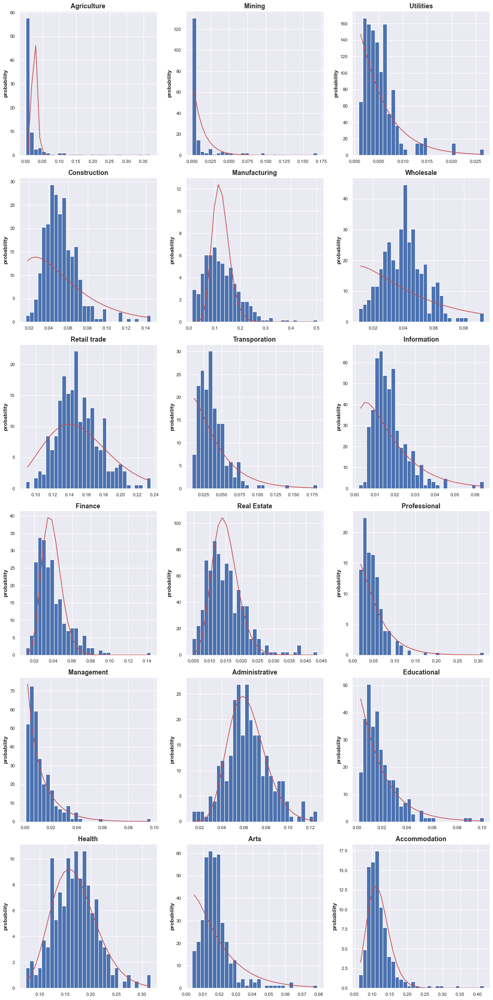

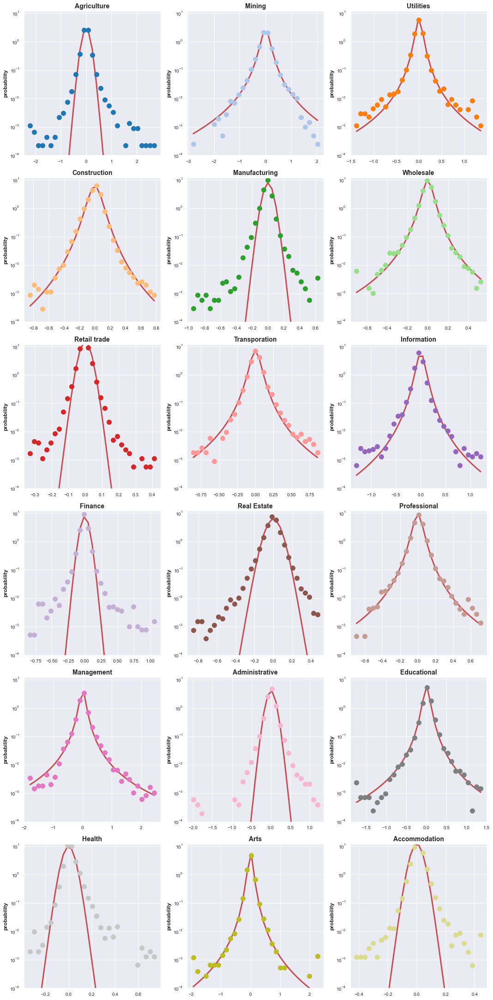

In [35]:
import scipy.optimize as opt
time_stamps=time_stamps_likeCBP_list
tau=12
logG_BDI_inst = shared_func.azaele_neutral_logG_distribution()
color_list=list(sns.color_palette(palette='tab20'))
n_rows=int(len(naics_keys_to_plot)/3 + 1)
fig1 = plt.figure(figsize=(15, 5*n_rows)) 
fig2 = plt.figure(figsize=(15, 5*n_rows)) 
for nidx,naics in enumerate(naics_keys_to_plot):   
    ax_1 = fig1.add_subplot(n_rows,3,  nidx+1)
    ax_2 = fig2.add_subplot(n_rows,3,  nidx+1) 
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    if remove_imputed_values:  
        emp, non_imputed_idx=shared_func.get_nonimputed_data(df_new,[naics],time_stamp)
        emp=emp[non_imputed_idx]
    else:
        emp = df_new[naics+'-Y'+time_stamp].values 
    cross_sec_emp=emp[emp>0] 
    
    logratio_change_naics=[]
    for i in range(len(time_stamps)-tau):
        time_stamp1=time_stamps[i]
        time_stamp2=time_stamps[i+tau]
        naics_yr = [naics+'-Y'+time_stamp1]
        naics_yr2 = [naics+'-Y'+time_stamp2]
        if remove_imputed_values:           
            emp1, non_imputed_idx1=shared_func.get_nonimputed_data(df_new,[naics],time_stamp1)
            emp2, non_imputed_idx2=shared_func.get_nonimputed_data(df_new,[naics],time_stamp2)
            non_imputed_idx=np.intersect1d(non_imputed_idx1,non_imputed_idx2,assume_unique=True)
            empF_naics1=emp1[non_imputed_idx]
            empF_naics2=emp2[non_imputed_idx]
        else:
            empF_naics1 = df_new[naics_yr].values
            empF_naics2 = df_new[naics_yr2].values
        ratio_change_naics_yr=np.ravel(empF_naics2[empF_naics1>0]*1./empF_naics1[empF_naics1>0])    
        logratio_change_naics.extend(np.log(ratio_change_naics_yr[ratio_change_naics_yr>0.]))

    logratio_change_naics=np.array(logratio_change_naics)

    
#     a_gamma,_, scale_gamma=scipy.stats.gamma.fit(cross_sec_emp,2.,floc=0.,scale=np.var(emp))
#     print (a_gamma,scale_gamma)   
#     lfn = LikelihoodFunction_gamma(cross_sec_emp)   
#     result = opt.minimize(lambda x: -lfn(*x),x0=(5,5),method='Nelder-Mead')
 
    lfn_combined = LikelihoodFunction_combined(cross_sec_emp, logratio_change_naics, 1.) 
    result = opt.minimize(lambda x: -lfn_combined(*x),x0=(5,5,5),method='Nelder-Mead')
#     print (result)
    
    params_fit=result.x
    
    n_bins=31
    histogram, bins = np.histogram(cross_sec_emp, bins=n_bins, density=True)
    bin_centers = 0.5*(bins[1:] + bins[:-1])        
    ax_1.hist(emp,bins=n_bins,density=True)
    ax_1.plot(bin_centers,scipy.stats.gamma.pdf(bin_centers, params_fit[0],loc=0, scale= params_fit[1]), 
                 'r-',label='Gamma-BDI')
    histogram, bins = np.histogram(logratio_change_naics, bins=n_bins, density=True)
    bin_centers = 0.5*(bins[1:] + bins[:-1])

#         ax1.plot(bin_centers,scipy.stats.norm.pdf(bin_centers,loc=mu_normal, scale=sigma_normal),
#                  'g-',label='Gaussian')

#         ax1.plot(bin_centers,scipy.stats.laplace.pdf(bin_centers,loc=0,scale=scale_laplace),
#                  'c-',label='Laplace')

#         ax1.plot(bin_centers,weibull_inst.pdf(bin_centers,weibull_k_MM,loc=0,scale=weibull_lambda_MM),
#                      'k--',label='Weibull, Moments')      

#         ax1.plot(bin_centers,weibull_inst.pdf(bin_centers,weibull_k_MLE, loc=0,scale= weibull_lambda_MLE), 'k-',lw=3,label='Weibull MLE')

    ax_2.plot(bin_centers,logG_BDI_inst.pdf(bin_centers, params_fit[2], params_fit[0], 
                                           loc=0,scale= 1), 'r-',lw=3,label='Neutral theory')  

    ax_2.plot(bin_centers,histogram,'o', color=color_list[nidx], ms=10)
    ax_2.set_ylim(1e-4,12.)
    ax_2.set_yscale('log')
    ax_2.set_title(naics_name) 
    ax_2.set_ylabel(r'probability')
    
    ax_1.set_title(naics_name)       
    ax_1.set_ylabel(r'probability')
    
fig1.patch.set_facecolor('white')
fig1.tight_layout()
fig2.patch.set_facecolor('white')
fig2.tight_layout()

In [37]:
result.x

array([0.5110108 , 0.05334534])

In [16]:
naics_name

'Wholesale'

In [15]:
len(emp)

260

# fit logG of different year intervals or city size intervals separately.

## logG at different year intervals has similar parameters
so discrepancy in parameters not because of some outlier year like 2008 or something.

07-Q1-M1 48
t/tau=  6.15e-03 ;  b/d=  1.44e+00 loc & scale are fixed= 0.0 1.0
t/tau=  6.67e-03 ;  b/d=  1.03e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.46e-03 ;  b/d=  9.37e-01 loc & scale are fixed= 0.0 1.0
t/tau=  3.03e-03 ;  b/d=  2.04e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.16e-03 ;  b/d=  1.63e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.03e-03 ;  b/d=  1.23e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.27e-04 ;  b/d=  2.03e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.72e-03 ;  b/d=  1.51e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.46e-03 ;  b/d=  1.33e+00 loc & scale are fixed= 0.0 1.0
t/tau=  6.72e-04 ;  b/d=  1.17e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.72e-03 ;  b/d=  1.47e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.24e-03 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  4.19e-03 ;  b/d=  8.33e-01 loc & scale are fixed= 0.0 1.0
t/tau=  3.17e-03 ;  b/d=  1.25e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.74e-03 ;  b/d=  9.73e-01 loc & scale are fixed= 0.0 1.

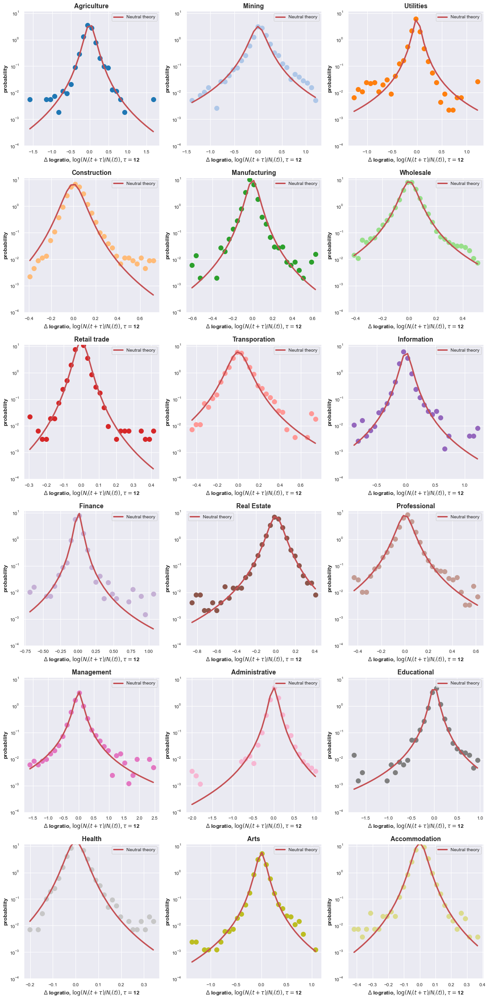

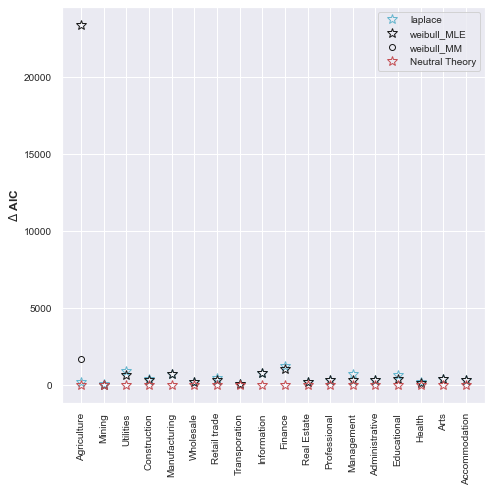

{'naics': ['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51', '52', '53', '54', '55', '56', '61', '62', '71', '72'], 'naics_name': ['Agriculture', 'Mining', 'Utilities', 'Construction', 'Manufacturing', 'Wholesale', 'Retail trade', 'Transporation', 'Information', 'Finance', 'Real Estate', 'Professional', 'Management', 'Administrative', 'Educational', 'Health', 'Arts', 'Accommodation'], 'laplace': [array([0.       , 0.1030592]), array([0.       , 0.1458399]), array([0.        , 0.08214022]), array([0.        , 0.05442775]), array([0.        , 0.04078289]), array([0.        , 0.04876874]), array([0.        , 0.02284622]), array([0.       , 0.0653063]), array([0.        , 0.07126547]), array([0.        , 0.04284804]), array([0.        , 0.05314106]), array([0.        , 0.05108229]), array([0.        , 0.15380025]), array([0.        , 0.08478118]), array([0.        , 0.08260929]), array([0.        , 0.02553748]), array([0.        , 0.07370473]), array([0.        , 0.02848366])]

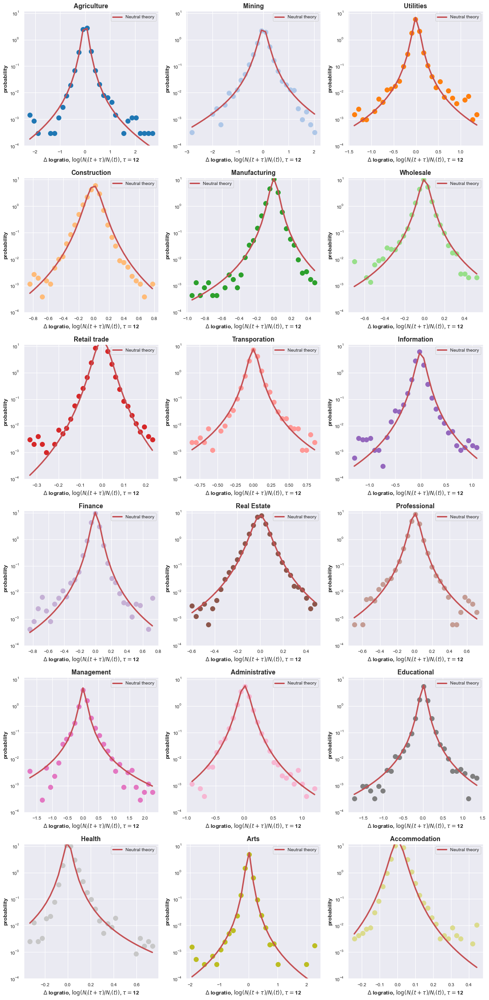

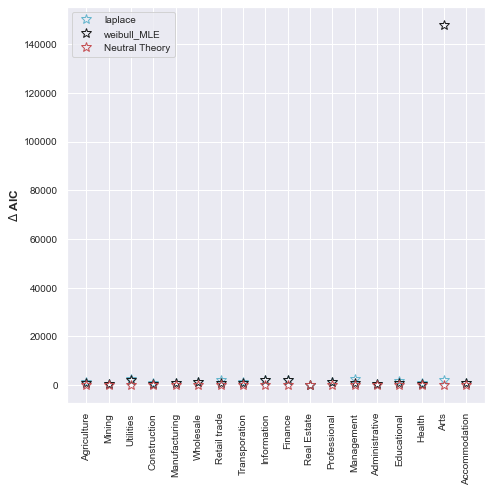

{'naics': ['11', '21', '22', '23', '31-33', '42', '44-45', '48-49', '51', '52', '53', '54', '55', '56', '61', '62', '71', '72'], 'naics_name': ['Agriculture', 'Mining', 'Utilities', 'Construction', 'Manufacturing', 'Wholesale', 'Retail trade', 'Transporation', 'Information', 'Finance', 'Real Estate', 'Professional', 'Management', 'Administrative', 'Educational', 'Health', 'Arts', 'Accommodation'], 'laplace': [array([0.        , 0.09363361]), array([0.        , 0.16384706]), array([0.        , 0.06578757]), array([0.        , 0.06288889]), array([0.        , 0.03702049]), array([0.        , 0.03966039]), array([0.        , 0.02047327]), array([0.        , 0.05422609]), array([0.        , 0.06862897]), array([0.        , 0.03880916]), array([0.        , 0.04779588]), array([0.        , 0.04253829]), array([0.        , 0.10888893]), array([0.        , 0.06899813]), array([0.        , 0.07306211]), array([0.        , 0.03091851]), array([0.        , 0.06575198]), array([0.        , 0.02432

In [6]:
# time_stamp='12-Q2-M2'
# with open(fit_params_path+'AFD_fit_vals-T'+time_stamp+'.pkl', 'rb') as handle:
#     AFD_fit_vals = pickle.load(handle)
    
# shape_param_dict={}

# for naics in naics_keys_to_plot:
#     naics_code=naics.replace('naics_','')
#     idx= np.where(np.array(AFD_fit_vals['naics'])==naics_code)[0][0]  
#     shape_param_dict.update({naics:AFD_fit_vals['shape'][idx]})

for i,t in enumerate(time_stamps_likeCBP_list):
    if '07' in t:
        print (t, i)
        break


Delta_t=12

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')


time_stamps_to_plot=time_stamps_likeCBP_list[:i]
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_to_plot,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

print (results_fit)    


time_stamps_to_plot2=time_stamps_likeCBP_list[i:]
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit2=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_to_plot2,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

print (results_fit2)  



    
# with open(fit_params_path+'logG_usingAFD_fit-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
#     pickle.dump(results_fit, handle)

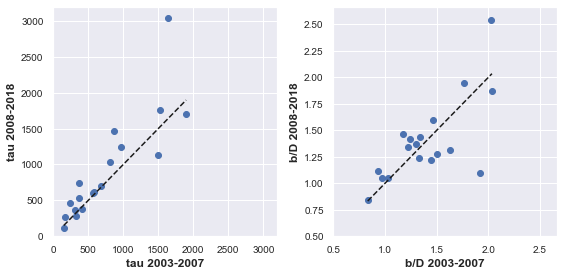

In [23]:

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

tau_1=1./np.array(results_fit['NeutralTheory'])[:,0]
tau_2=1./np.array(results_fit2['NeutralTheory'])[:,0]
ax1.plot(tau_1,tau_2,'o')
ax1.plot( (np.min(tau_1), np.max(tau_1)),(np.min(tau_1), np.max(tau_1)),'k--')
ax1.set_xlim(0,max(np.max(tau_1),np.max(tau_2)) *1.05 )
ax1.set_ylim(0,max(np.max(tau_1),np.max(tau_2))*1.05  )
# ax1.set_aspect('equal')
ax1.set_xlabel('tau 2003-2007')
ax1.set_ylabel('tau 2008-2018')


bd_1=np.array(results_fit['NeutralTheory'])[:,1]
bd_2=np.array(results_fit2['NeutralTheory'])[:,1]
ax2.plot(bd_1,bd_2,'o')
ax2.plot( (np.min(bd_1), np.max(bd_1)),(np.min(bd_1), np.max(bd_1)),'k--')

ax2.set_ylim(0.5,max(np.max(bd_1),np.max(bd_2))*1.05  )
ax2.set_xlim(0.5,max(np.max(bd_1),np.max(bd_2)) *1.05 )
ax2.set_xlabel('b/D 2003-2007')
ax2.set_ylabel('b/D 2008-2018')
fig.tight_layout()

In [11]:
np.array(results_fit['NeutralTheory'])[:,0]

array([0.0061494 , 0.00666734, 0.00145848, 0.00302631, 0.00115615,
       0.0010319 , 0.00052712, 0.00272372, 0.00245611, 0.00067162,
       0.00171603, 0.00123907, 0.00418844, 0.0031686 , 0.00174161,
       0.00061277, 0.00268738, 0.00065691])

## fit big cities and small cities separately? or look at inferred parameters vs city size?

t/tau=  3.27e-03 ;  b/d=  1.33e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.22e-03 ;  b/d=  9.79e-01 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.27e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.90e-03 ;  b/d=  2.12e+00 loc & scale are fixed= 0.0 1.0
t/tau=  6.97e-04 ;  b/d=  1.63e+00 loc & scale are fixed= 0.0 1.0
t/tau=  7.90e-04 ;  b/d=  1.94e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.67e-04 ;  b/d=  3.25e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.16e-03 ;  b/d=  1.44e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.79e-03 ;  b/d=  1.88e+00 loc & scale are fixed= 0.0 1.0
t/tau=  7.48e-04 ;  b/d=  1.67e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.01e-03 ;  b/d=  1.71e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.83e-04 ;  b/d=  1.87e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.77e-03 ;  b/d=  9.35e-01 loc & scale are fixed= 0.0 1.0
naics_55 Management how many weibull infinities 2
nan nan nan
nan
t/tau=  2.20e-03 ;  b/d=  1.91e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.

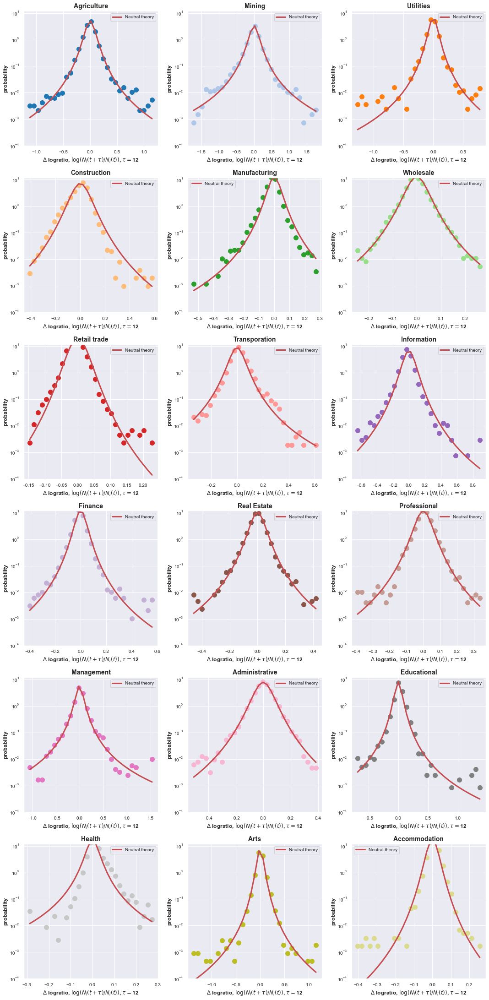

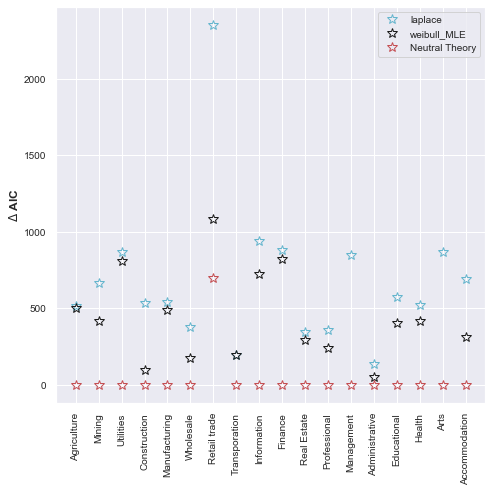

In [6]:
df_big_cities_time=shared_func.get_cities_based_on_size(df_metroF_time, time_stamps_likeCBP_list[0],
                                                        big_only=True, BLS=True)


Delta_t=12

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')



with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit_bigC=shared_func.plot_DeltaLogRatio_fit_by_naics(df_big_cities_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

with open(fit_params_path+'logG_bigCities-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit_bigC, handle)

t/tau=  5.39e-03 ;  b/d=  1.29e+00 loc & scale are fixed= 0.0 1.0
naics_11 Agriculture how many weibull infinities 3
nan nan nan
nan
t/tau=  1.30e-02 ;  b/d=  1.18e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.29e-03 ;  b/d=  9.66e-01 loc & scale are fixed= 0.0 1.0
t/tau=  4.94e-03 ;  b/d=  2.00e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.20e-03 ;  b/d=  1.46e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.53e-03 ;  b/d=  1.41e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.47e-04 ;  b/d=  2.52e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.14e-03 ;  b/d=  1.33e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.04e-03 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.14e-03 ;  b/d=  1.36e+00 loc & scale are fixed= 0.0 1.0
t/tau=  4.02e-03 ;  b/d=  2.06e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.64e-03 ;  b/d=  1.39e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.60e-03 ;  b/d=  8.34e-01 loc & scale are fixed= 0.0 1.0
t/tau=  5.82e-03 ;  b/d=  1.59e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2

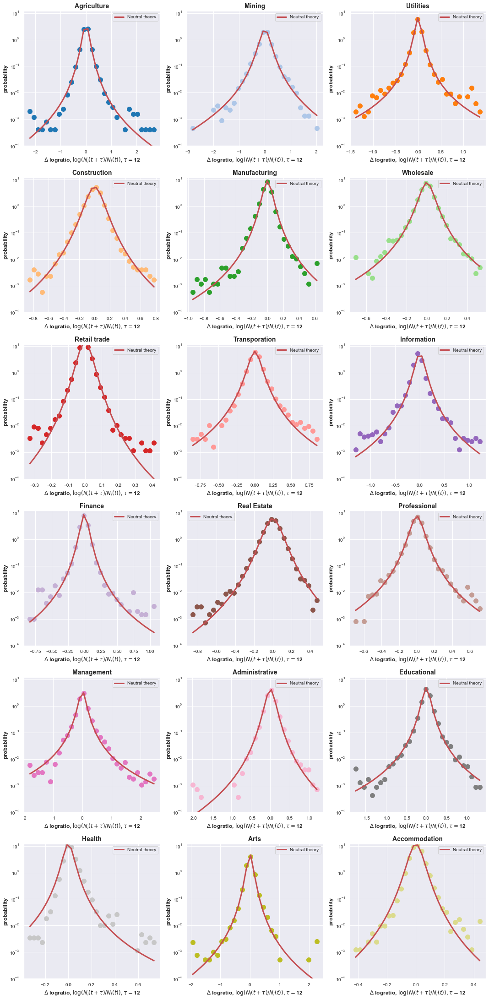

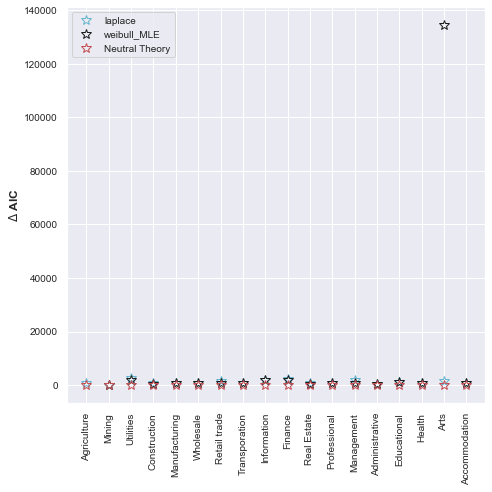

In [8]:
df_small_cities_time=shared_func.get_cities_based_on_size(df_metroF_time, time_stamps_likeCBP_list[0],
                                                        big_only=False, BLS=True)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit_smallC=shared_func.plot_DeltaLogRatio_fit_by_naics(df_small_cities_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

with open(fit_params_path+'logG_smallCities-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit_smallC, handle)

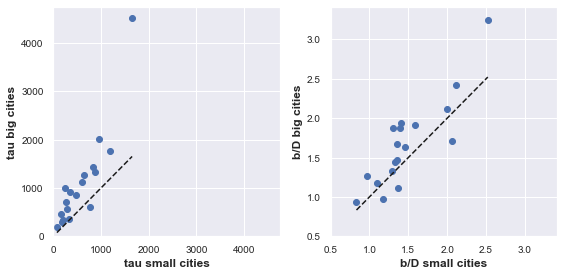

In [9]:

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

tau_1=1./np.array(results_fit_smallC['NeutralTheory'])[:,0]
tau_2=1./np.array(results_fit_bigC['NeutralTheory'])[:,0]
ax1.plot(tau_1,tau_2,'o')
ax1.plot( (np.min(tau_1), np.max(tau_1)),(np.min(tau_1), np.max(tau_1)),'k--')
ax1.set_xlim(0,max(np.max(tau_1),np.max(tau_2)) *1.05 )
ax1.set_ylim(0,max(np.max(tau_1),np.max(tau_2))*1.05  )
# ax1.set_aspect('equal')
ax1.set_xlabel('tau small cities')
ax1.set_ylabel('tau big cities')


bd_1=np.array(results_fit_smallC['NeutralTheory'])[:,1]
bd_2=np.array(results_fit_bigC['NeutralTheory'])[:,1]
ax2.plot(bd_1,bd_2,'o')
ax2.plot( (np.min(bd_1), np.max(bd_1)),(np.min(bd_1), np.max(bd_1)),'k--')

ax2.set_ylim(0.5,max(np.max(bd_1),np.max(bd_2))*1.05  )
ax2.set_xlim(0.5,max(np.max(bd_1),np.max(bd_2)) *1.05 )
ax2.set_xlabel('b/D small cities')
ax2.set_ylabel('b/D big cities')
fig.tight_layout()

t/tau=  4.14e-03 ;  b/d=  1.27e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.26e-03 ;  b/d=  1.05e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.40e-03 ;  b/d=  1.06e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.47e-03 ;  b/d=  1.90e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.29e-04 ;  b/d=  1.43e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.38e-04 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  5.63e-04 ;  b/d=  2.39e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.52e-03 ;  b/d=  1.30e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.57e-03 ;  b/d=  1.41e+00 loc & scale are fixed= 0.0 1.0
t/tau=  8.31e-04 ;  b/d=  1.38e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.58e+00 loc & scale are fixed= 0.0 1.0
t/tau=  9.93e-04 ;  b/d=  1.33e+00 loc & scale are fixed= 0.0 1.0
t/tau=  2.47e-03 ;  b/d=  8.29e-01 loc & scale are fixed= 0.0 1.0
t/tau=  2.73e-03 ;  b/d=  1.36e+00 loc & scale are fixed= 0.0 1.0
t/tau=  1.67e-03 ;  b/d=  1.03e+00 loc & scale are fixed= 0.0 1.0
t/tau=  3.

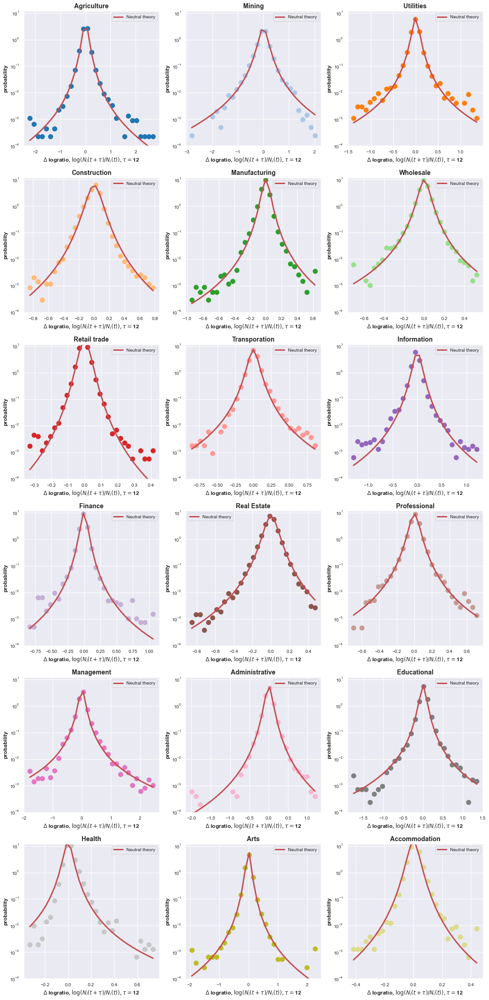

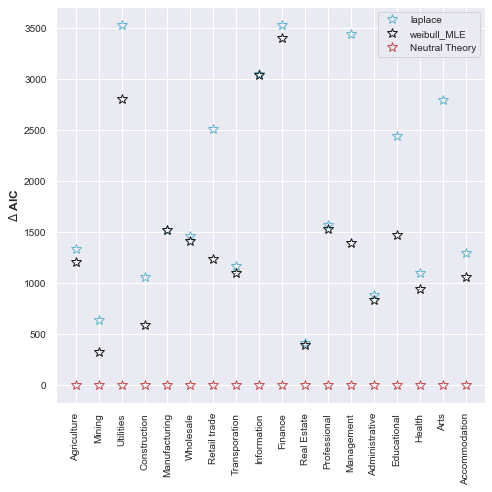

In [7]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                                plot_only_BDI=True)

with open(fit_params_path+'logG_allCities-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_fit, handle)

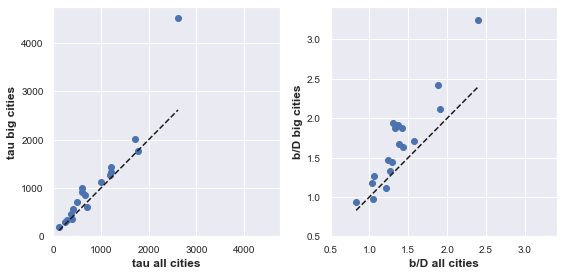

In [10]:

fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

tau_1=1./np.array(results_fit['NeutralTheory'])[:,0]
tau_2=1./np.array(results_fit_bigC['NeutralTheory'])[:,0]
ax1.plot(tau_1,tau_2,'o')
ax1.plot( (np.min(tau_1), np.max(tau_1)),(np.min(tau_1), np.max(tau_1)),'k--')
ax1.set_xlim(0,max(np.max(tau_1),np.max(tau_2)) *1.05 )
ax1.set_ylim(0,max(np.max(tau_1),np.max(tau_2))*1.05  )
# ax1.set_aspect('equal')
ax1.set_xlabel('tau all cities')
ax1.set_ylabel('tau big cities')


bd_1=np.array(results_fit['NeutralTheory'])[:,1]
bd_2=np.array(results_fit_bigC['NeutralTheory'])[:,1]
ax2.plot(bd_1,bd_2,'o')
ax2.plot( (np.min(bd_1), np.max(bd_1)),(np.min(bd_1), np.max(bd_1)),'k--')

ax2.set_ylim(0.5,max(np.max(bd_1),np.max(bd_2))*1.05  )
ax2.set_xlim(0.5,max(np.max(bd_1),np.max(bd_2)) *1.05 )
ax2.set_xlabel('b/D all cities')
ax2.set_ylabel('b/D big cities')
fig.tight_layout()

# fit one trajectory at a time
- see if different cities have similar shape parameters for the growth trajectory
- needs to be run on cluster. it is too slow to run locally.
- can be used to look at inferred parameters vs city size.

[10740]


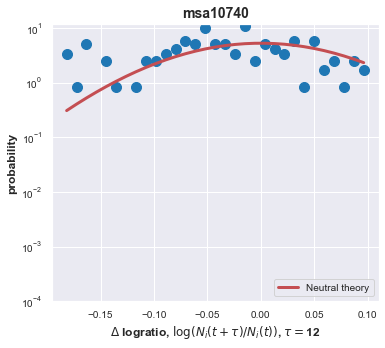

plotted 10740


In [6]:
msa_list=df_metroF_time['msa'].values[5:6]
print (msa_list)

naics_keys_to_plot=['naics_51']
Delta_t=12
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    

    shared_func.plot_DeltaLogRatio_fit_each_trajectory(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,
                                                msa_list,remove_imputed_values=True,
                                                tau=Delta_t,plot_only_BDI=True,
                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')

In [16]:
msa_list=df_metroF_time['msa'].values#[5:6]
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

# naics_keys_to_plot=['naics_51']
Delta_t=12
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fit_params_dict=shared_func.plot_DeltaLogRatio_fit_each_trajectory(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,
                                                msa_list,remove_imputed_values=True,
                                                suppress_plots=True,
                                                tau=Delta_t,
                                                return_fit_vals=True)

skip this 10580 naics_11
skip this 10900 naics_11
skip this 11180 naics_11
skip this 11500 naics_11
skip this 11700 naics_11
skip this 12020 naics_11
skip this 12060 naics_11
skip this 12260 naics_11
skip this 12580 naics_11
skip this 12940 naics_11
skip this 13820 naics_11
skip this 13980 naics_11
skip this 14260 naics_11
skip this 14540 naics_11
skip this 15260 naics_11
skip this 15380 naics_11
skip this 16020 naics_11
skip this 16060 naics_11
skip this 16180 naics_11
skip this 16300 naics_11
skip this 16580 naics_11
skip this 16740 naics_11
skip this 16820 naics_11
skip this 16860 naics_11
skip this 16980 naics_11
skip this 17140 naics_11
skip this 17300 naics_11
skip this 17420 naics_11
skip this 17460 naics_11
skip this 17900 naics_11
skip this 17980 naics_11
skip this 18140 naics_11
skip this 19140 naics_11
skip this 19180 naics_11
skip this 19340 naics_11
skip this 19380 naics_11
skip this 19460 naics_11
skip this 19660 naics_11
skip this 19740 naics_11
skip this 19780 naics_11


skip this 48300 naics_21
skip this 48540 naics_21
skip this 48900 naics_21
skip this 49020 naics_21
skip this 49180 naics_21
skip this 10500 naics_22
skip this 11100 naics_22
skip this 11540 naics_22
skip this 11700 naics_22
skip this 12020 naics_22
skip this 12060 naics_22
skip this 12260 naics_22
skip this 12580 naics_22
skip this 12940 naics_22
skip this 12980 naics_22
skip this 13020 naics_22
skip this 13740 naics_22
skip this 13780 naics_22
skip this 13820 naics_22
skip this 13900 naics_22
skip this 13980 naics_22
skip this 14010 naics_22
skip this 14020 naics_22
skip this 14100 naics_22
skip this 14260 naics_22
skip this 14460 naics_22
skip this 14540 naics_22
skip this 15260 naics_22
skip this 15540 naics_22
skip this 15680 naics_22
skip this 16020 naics_22
skip this 16300 naics_22
skip this 16580 naics_22
skip this 16620 naics_22
skip this 16700 naics_22
skip this 16740 naics_22
skip this 16820 naics_22
skip this 16860 naics_22
skip this 16980 naics_22
skip this 17140 naics_22


KeyboardInterrupt: 

In [ ]:
with open(fit_params_path+'logG_ind_trajs_F_fit-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(fit_params_dict, handle)

In [14]:
fit_params_dict

{'naics': ['51'],
 'naics_name': ['Information'],
 'msa': [10740],
 'NeutralTheory': [array([ 0.09406008, 31.69601713,  0.        ,  1.        ])]}

In [ ]:
df_new

In [ ]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
Delta_t=12
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    results_logg_F_fit=shared_func.plot_DeltaLogRatio_fit_by_naics(df_metroF_time, naics_keys_to_plot, 
                                                time_stamps_likeCBP_list,remove_imputed_values=True,
                                                return_fit_vals=True,tau=Delta_t,
                                                xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$')
with open(fit_params_path+'log_growth_F_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'wb') as handle:
    pickle.dump(results_logg_F_fit, handle)

# fit AFD scaled using West exponents

## West scaling of sectoral power-laws

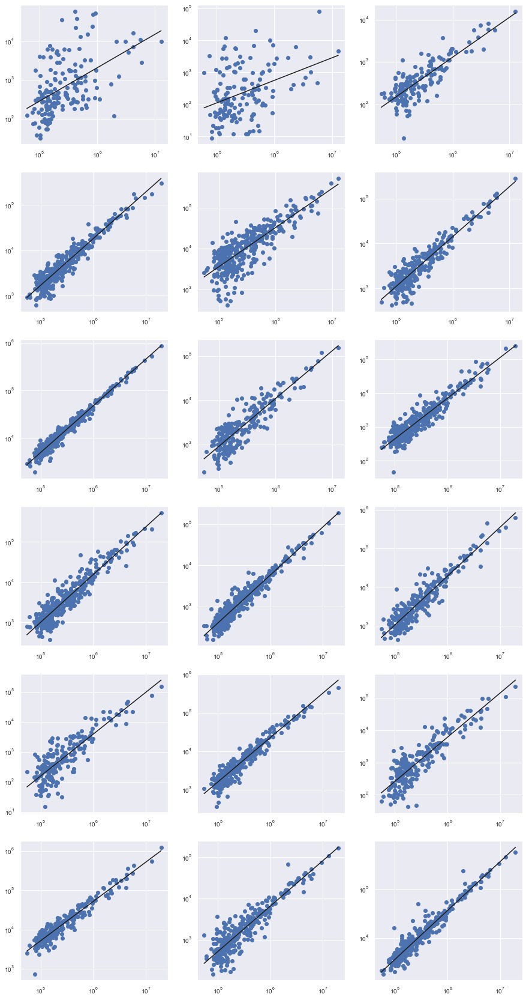

In [28]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')

sectoral_scaling_dict={'naics':[], 'naics_name':[],
                      'exponent':[],'intercept':[]}

year='2010'
time_stamp='10-Q3-M1'

n_rows=int(len(naics_keys_to_plot)/3 + 1)
fig = plt.figure(figsize=(15, 5*n_rows))    
for nidx,naics in enumerate(naics_keys_to_plot):     
    ax1 = fig.add_subplot(n_rows,3,  nidx+1)
    
    popn_key='popn_'+year
    naics_key=naics+'-Y'+time_stamp
    naics_key_imp=naics+'_imputed-Y'+time_stamp
    xvals=np.squeeze(popn_metro_df[popn_key].values.astype(float))
    yvals=np.squeeze(df_metro_time[naics_key].values)
    nonimp_idx=np.where(df_metro_time[naics_key_imp].values==False)[0]
    xvals=xvals[nonimp_idx]
    yvals=yvals[nonimp_idx]
#     ax1.loglog(popn_metro_df[popn_key].values, df_metro_time[naics_key].values,'o')
    slope, intrcpt=np.polyfit(np.log10(xvals),np.log10(yvals),1)
    ax1.loglog(xvals, yvals,'o')
    xmin=np.min(xvals)
    xmax=np.max(xvals)
    ax1.loglog( (xmin, xmax ),
               (np.power(10, intrcpt) *np.power(xmin,slope) , np.power(10, intrcpt) *np.power(xmax,slope)  ) ,
               'k-')
    naics_name=shared_func.sector_from_naics(df_naics_ref, naics, shorten=True)
    sectoral_scaling_dict['naics'].append(naics)   
    sectoral_scaling_dict['naics_name'].append(naics_name)
    sectoral_scaling_dict['exponent'].append(slope)   
    sectoral_scaling_dict['intercept'].append(intrcpt)

plt.show()


with open(fit_params_path+'Sectoral_Scaling_West-Y'+year+'.pkl', 'wb') as handle:
    pickle.dump(sectoral_scaling_dict, handle)

## fit AFD rescaled using exponents

In [ ]:
with open(fit_params_path+'Sectoral_Scaling_West-Y'+year+'.pkl', 'rb') as handle:
    temp=pickle.load (handle)
                         
sectoral_scaling_df=pd.DataFrame.from_dict(temp)

In [63]:
df_metroFEXP_time=df_metro_time.copy() ## df with emp/total population stored

naics_keys_yrs=[]
n_cities_total_imputed_list=[]

year='2010'
time_stamp='10-Q3-M1'
popn_key='popn_'+year
# for time in time_stamps_likeCBP_list[len(time_stamps_likeCBP_list)//2:]:
#     year='20'+time[:2]
#     if int(year)>=2010 and int(year)<2019 :

for nidx,naics in enumerate(naics_keys_to_plot):  

    naics_keys_yr=naics+'-Y'+time_stamp
#     imputed_naics_keys_yr=naics+'_imputed-Y'+time_stamp
    naics_keys_yrs.extend(naics_keys_yr)
    exp=sectoral_scaling_df['exponent'][sectoral_scaling_df['naics']==naics].values
    popn=popn_metro_df[popn_key].values.astype(float)
#     df_metroFEXP_time[naics_keys_yr]=df_metro_time[naics_keys_yr].values*1./np.power(
#         popn,exp)
    df_metroFEXP_time[naics_keys_yr]=df_metro_time[naics_keys_yr].values*1./np.power(
        popn,0.5)



Agriculture
gamma shape=  0.48465980928781055 scale=  9.84425079736084
Mining
gamma shape=  0.41328704767136487 scale=  5.0917286620411515
Utilities
gamma shape=  1.8982729410000743 scale=  0.5059485811896992
Construction
gamma shape=  2.3697618557227083 scale=  5.040193382333001
Manufacturing
gamma shape=  1.7397880999093882 scale=  14.663426531128648
Wholesale
gamma shape=  1.7195570649496428 scale=  5.198479506641544
Retail trade
gamma shape=  3.1418355863527583 scale=  10.152837068379807
Transporation
gamma shape=  1.6281149145646152 scale=  4.336635442614362
Information
gamma shape=  1.1881805656071418 scale=  4.1273721095391025
Finance
gamma shape=  1.2573251730641961 scale=  8.40227168880511
Real Estate
gamma shape=  1.459152649846399 scale=  2.5916627901314184
Professional
gamma shape=  1.035574228481626 scale=  12.465284769520752
Management
gamma shape=  0.7192566757356808 scale=  3.9897661088148904
Administrative
gamma shape=  1.6656571493066652 scale=  8.265416870206407
Educ

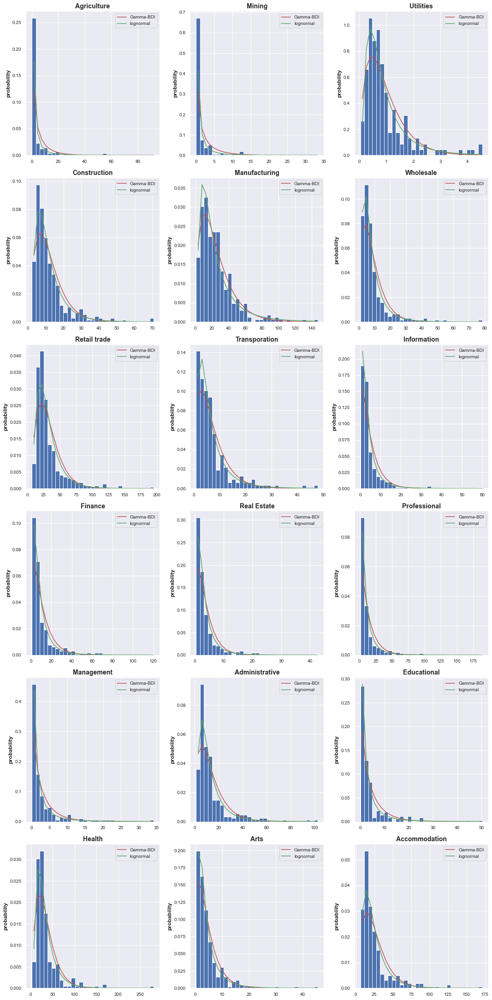

In [64]:

AFD_fit_vals=shared_func.plot_abundance_fit_by_naics(df_metroFEXP_time, naics_keys_to_plot,
                                                     time_stamp,
                             remove_imputed_values=True,return_fit_vals=True)

# with open(fit_params_path+'dfdfT'+time_stamp+'.pkl', 'wb') as handle:
#     pickle.dump(AFD_fit_vals, handle)

## Shape of gamma when scaled by $\sqrt{N_{tot}}$ matches shape of log G!

#####  Shape when fitting $\frac{N}{ \sqrt{N_{tot}}}$

In [66]:
AFD_fit_vals['shape']


[0.48465980928781055,
 0.41328704767136487,
 1.8982729410000743,
 2.3697618557227083,
 1.7397880999093882,
 1.7195570649496428,
 3.1418355863527583,
 1.6281149145646152,
 1.1881805656071418,
 1.2573251730641961,
 1.459152649846399,
 1.035574228481626,
 0.7192566757356808,
 1.6656571493066652,
 0.775070888079536,
 2.346290537955478,
 1.44427153122186,
 2.340369990197496]

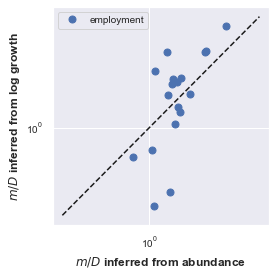

In [69]:
Delta_t=12
with open(fit_params_path+'log_growth_F_fitvals-Delta_t'+str(Delta_t)+'.pkl', 'rb') as handle:
    city_fit_vals_logG = pickle.load(handle)
city_logG_shape= np.array(city_fit_vals_logG['NeutralTheory'])[:,1]
city_AFD_shape=AFD_fit_vals['shape']
fig = plt.figure(figsize=(4, 4))
ax1 = fig.add_subplot()
# ax1.plot(microbe_logG_shape,microbe_AFD_shape,'m*', markersize=7,alpha=0.5,label='microbiome')
# ax1.plot(BCI_logG_shape,BCI_AFD_shape,'go', markersize=7,label='forest')
ax1.plot(city_logG_shape,city_AFD_shape,'bo', markersize=7,label='employment')
ax1.set_xscale('log')
ax1.set_yscale('log')
minval=min(ax1.get_xlim()[0],ax1.get_ylim()[0])
maxval=max(ax1.get_xlim()[1],ax1.get_ylim()[1])
ax1.plot((minval,maxval), (minval,maxval),'k--')
ax1.legend(loc='best')
ax1.set_xlabel(r'$m/D$ inferred from abundance')
ax1.set_ylabel(r'$m/D$ inferred from log growth')
fig.tight_layout()
# plt.savefig(dest_path+'compare_inferred_shapesdfd.png')
plt.show()

##### Shape when fitting $\frac{N}{ N_{tot}^{\alpha}}$

In [62]:
AFD_fit_vals['shape']

[0.5141786711486324,
 0.4172288341871103,
 2.936747963411941,
 8.771962033945753,
 2.535222448529682,
 5.256261839743666,
 33.43498958381293,
 3.3384056831890434,
 4.266929483316805,
 4.327273016802612,
 7.052475147951998,
 3.6351490708725454,
 1.4103913497861131,
 8.163395326431026,
 1.827504238040822,
 10.263909977154135,
 3.4329290608098475,
 9.471115085100287]

#####  Shape when fitting $\frac{N}{ N_{tot}^{1/\alpha}}$

In [59]:
AFD_fit_vals['shape']

[0.5198296126850381,
 0.3678352580125587,
 2.7770812211362608,
 8.666053285379396,
 2.4540086450027094,
 4.520642326400525,
 30.701455087429704,
 3.1747656781388276,
 2.583212276535214,
 2.7528472900789938,
 4.044091237457179,
 1.9361791010446472,
 0.9567087014574077,
 4.898858818476625,
 1.1059882741712252,
 10.268484356153389,
 3.1958952735565846,
 9.465555228058927]

##### shape without rescaling exponent, when when fitting $\frac{N}{ N_{tot}}$-- equivalento df_metro X

In [36]:
AFD_fit_vals['shape']

[0.5188868205713562,
 0.4041805524194154,
 2.884234076133602,
 8.775766217501646,
 2.5025195104675575,
 5.130283137587684,
 32.566702183332595,
 3.3167641428829744,
 3.6399763297311196,
 3.742885687251411,
 5.975788753942444,
 2.939394086144724,
 1.278790908546327,
 7.002667252045035,
 1.5694892606375332,
 10.266643103273815,
 3.434130950438413,
 9.468558072142736]

# fitting powerlaws for fold-change
we get an exponent of nearly 3 for both sides of the distribution. but maybe the fit won't be very great...
The fit of nearly 3 matches well with Fu, Stanley PNAS

need to compare this to fit of stretched exponential or something just for the tail.

or even laplace or gaussian (since we could argue that tail is laplace or gaussian from a distribution with a different variance?)-- but then we would need to figure out what makes those categories different. 

-for example size would be one reason.  Laplace distributions of different variances together might give us this ?



## tau=1

Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


4.939569534371099


/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


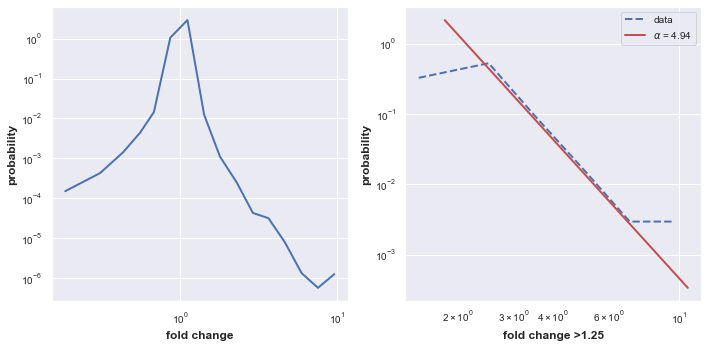

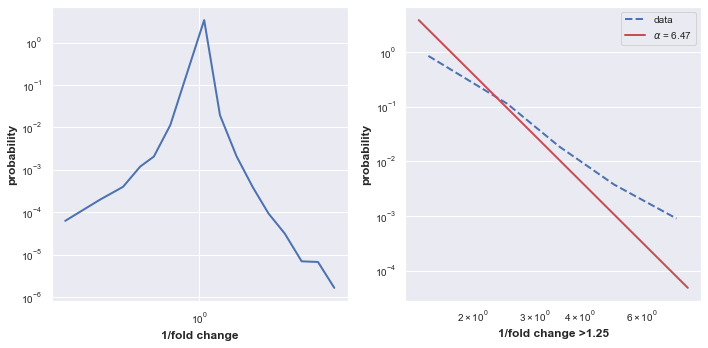

In [16]:

naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
log_g=shared_func.plot_DeltaLogRatio_distribution_MLE(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                            return_DeltaLogRatio=True)
fold_change=np.exp(log_g)


fit1=powerlaw.Fit(fold_change[fold_change>1.25],discrete=False)
print (fit1.alpha)
fig2 = plt.figure(figsize=(10, 5))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
powerlaw.plot_pdf(fold_change, ax=ax1, color='b',
                   linewidth=2)
fit1.plot_pdf(ax=ax2, color='b', linestyle='--',linewidth=2, label='data')
fit1.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit1.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('fold change')
ax2.set_xlabel('fold change >1.25')
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')

plt.tight_layout()
    
inv_change=1./fold_change
fit_left=powerlaw.Fit(inv_change[inv_change>1.25],discrete=False)
fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
powerlaw.plot_pdf(inv_change, ax=ax1, color='b', linewidth=2)
fit_left.plot_pdf(ax=ax2, color='b',linestyle='--', linewidth=2, label='data')
fit_left.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit_left.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('1/fold change')
ax2.set_xlabel('1/fold change >1.25')
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')
plt.tight_layout()  

plt.show()

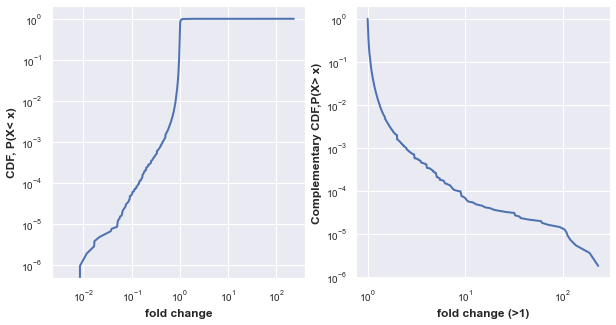

In [24]:
fig2 = plt.figure(figsize=(10, 5))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
powerlaw.plot_cdf(fold_change, ax=ax1, color='b', linewidth=2)
powerlaw.plot_ccdf(fold_change[fold_change>1], ax=ax2, color='b', linewidth=2)
ax1.set_ylabel('CDF, P(X< x)')
ax2.set_ylabel('Complementary CDF,P(X> x)')
ax1.set_xlabel('fold change')
ax2.set_xlabel('fold change (>1)')
plt.show()

## for tau=12 

Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


4.1307238478569435


/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


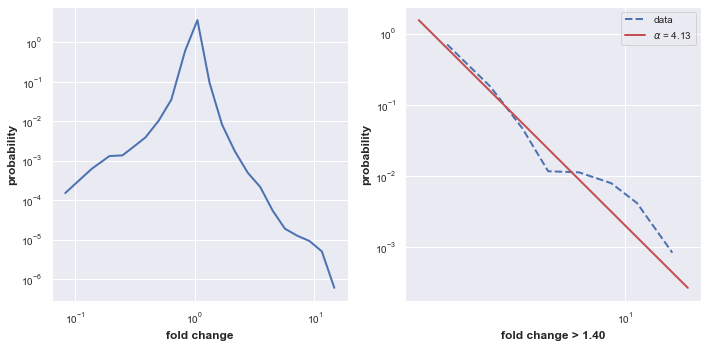

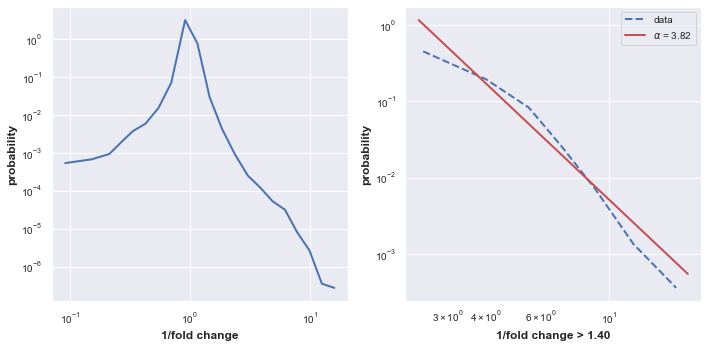

In [15]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
log_g=shared_func.plot_DeltaLogRatio_distribution_MLE(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            tau=12,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                            return_DeltaLogRatio=True)
fold_change=np.exp(log_g)

cutoff=1.4

fit1=powerlaw.Fit(fold_change[fold_change>cutoff],discrete=False)
print (fit1.alpha)
fig2 = plt.figure(figsize=(10, 5))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
powerlaw.plot_pdf(fold_change, ax=ax1, color='b',
                   linewidth=2)
fit1.plot_pdf(ax=ax2, color='b', linestyle='--',linewidth=2, label='data')
fit1.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit1.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('fold change')
ax2.set_xlabel('fold change > {:.2f}'.format(cutoff))
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')

plt.tight_layout()
    
inv_change=1./fold_change
fit_left=powerlaw.Fit(inv_change[inv_change>cutoff],discrete=False)
fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
powerlaw.plot_pdf(inv_change, ax=ax1, color='b', linewidth=2)
fit_left.plot_pdf(ax=ax2, color='b',linestyle='--', linewidth=2, label='data')
fit_left.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit_left.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('1/fold change')
ax2.set_xlabel('1/fold change > {:.2f}'.format(cutoff))
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')
plt.tight_layout()  

plt.show()

In [23]:
shared_func.sector_from_naics(df_naics_ref, 'naics_99', shorten=True)

'unclassified'

## for tau=36

Calculating best minimal value for power law fit


3.364806261744998


/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


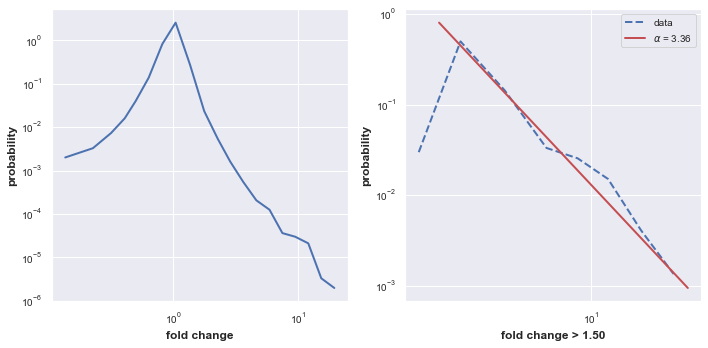

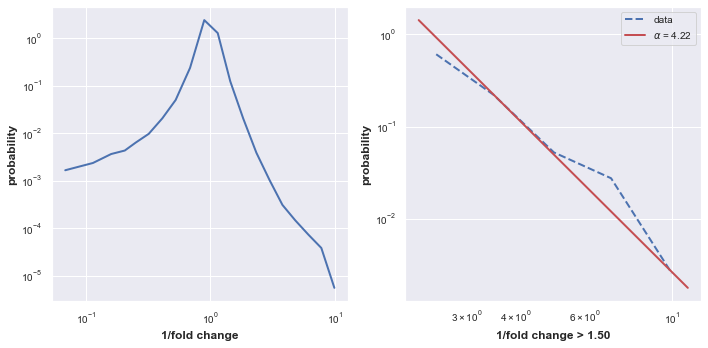

In [25]:
naics_keys_to_plot =deepcopy(naics_colnames)
naics_keys_to_plot.remove('naics_81')
naics_keys_to_plot.remove('naics_92')
naics_keys_to_plot.remove('naics_99')
log_g=shared_func.plot_DeltaLogRatio_distribution_MLE(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            tau=36,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                            return_DeltaLogRatio=True)
fold_change=np.exp(log_g)

cutoff=1.5

fit1=powerlaw.Fit(fold_change[fold_change>cutoff],discrete=False)
print (fit1.alpha)
fig2 = plt.figure(figsize=(10, 5))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
powerlaw.plot_pdf(fold_change, ax=ax1, color='b',
                   linewidth=2)
fit1.plot_pdf(ax=ax2, color='b', linestyle='--',linewidth=2, label='data')
fit1.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit1.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('fold change')
ax2.set_xlabel('fold change > {:.2f}'.format(cutoff))
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')

plt.tight_layout()
    
inv_change=1./fold_change
fit_left=powerlaw.Fit(inv_change[inv_change>cutoff],discrete=False)
fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
powerlaw.plot_pdf(inv_change, ax=ax1, color='b', linewidth=2)
fit_left.plot_pdf(ax=ax2, color='b',linestyle='--', linewidth=2, label='data')
fit_left.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit_left.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('1/fold change')
ax2.set_xlabel('1/fold change > {:.2f}'.format(cutoff))
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')
plt.tight_layout()  

plt.show()

## for tau =72

Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


2.085015835482028


/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
Calculating best minimal value for power law fit
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))
/Users/ashish/anaconda3/envs/cities/lib/python3.7/site-packages/powerlaw.py:700: RuntimeWarning: invalid value encountered in true_divide
  (Theoretical_CDF * (1 - Theoretical_CDF))


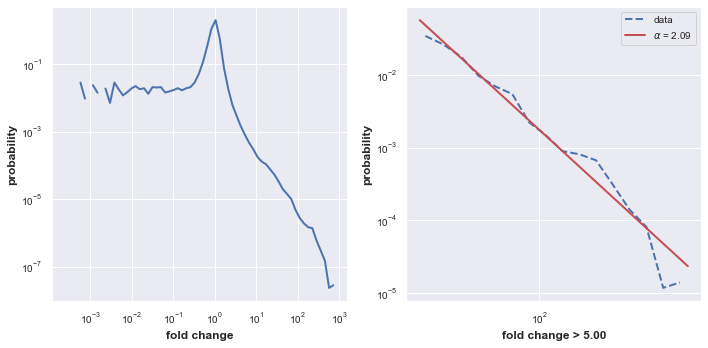

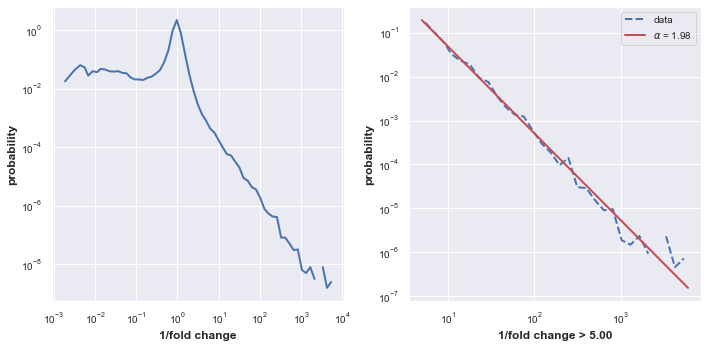

In [12]:
naics_keys_to_plot =naics_colnames
log_g=shared_func.plot_DeltaLogRatio_distribution_MLE(df_metro_time, naics_keys_to_plot, 
                                            time_stamps_likeCBP_list,
                                            tau=72,
                                            remove_imputed_values=True,
                                            xlabel=r'$\Delta$ logratio, $\log(N_i(t+\tau)/N_i(t))$',
                                            return_DeltaLogRatio=True)
fold_change=np.exp(log_g)

cutoff=5.

fit1=powerlaw.Fit(fold_change[fold_change>cutoff],discrete=False)
print (fit1.alpha)
fig2 = plt.figure(figsize=(10, 5))
ax1 = fig2.add_subplot(1,2,1)
ax2 = fig2.add_subplot(1,2,2)
powerlaw.plot_pdf(fold_change, ax=ax1, color='b',
                   linewidth=2)
fit1.plot_pdf(ax=ax2, color='b', linestyle='--',linewidth=2, label='data')
fit1.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit1.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('fold change')
ax2.set_xlabel('fold change > {:.2f}'.format(cutoff))
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')

plt.tight_layout()
    
inv_change=1./fold_change
fit_left=powerlaw.Fit(inv_change[inv_change>cutoff],discrete=False)
fig = plt.figure(figsize=(10, 5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)
powerlaw.plot_pdf(inv_change, ax=ax1, color='b', linewidth=2)
fit_left.plot_pdf(ax=ax2, color='b',linestyle='--', linewidth=2, label='data')
fit_left.power_law.plot_pdf(ax=ax2, color='r', linewidth=2, 
                        label=r'$\alpha$ = '+str('{:.2f}'.format(fit_left.alpha)))
ax2.legend(loc='best')
ax1.set_xlabel('1/fold change')
ax2.set_xlabel('1/fold change > {:.2f}'.format(cutoff))
for ax in [ax1,ax2]:
    ax.set_ylabel('probability')
plt.tight_layout()  

plt.show()

# rough

##### testing levy fits with a gaussian
beta, the asymmetry doesn't make a difference when alpha =2. 


testing fit of normal with levy
(4.001521826362743, 0.10082845382798761)
time for scipy norm method 0.0006449222564697266 secs
(par=1, alpha=2.00, beta=0.26, mu=4.00, sigma=0.07, -8753.947569790631)
time for levy method 8.558213949203491 secs
(par=1, alpha=2.00, beta=0.00, mu=4.00, sigma=0.07, -8753.947569790635)
time for symmetric levy method  2.004141092300415 secs


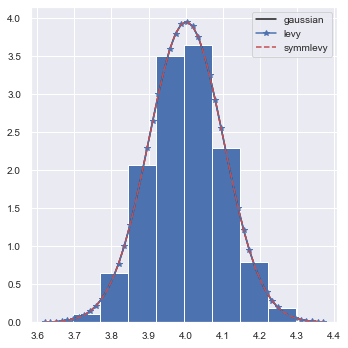

(par=1, alpha=2.00, beta=0.26, mu=4.00, sigma=0.07, -8753.947569790631)
(par=1, alpha=2.00, beta=0.00, mu=4.00, sigma=0.07, -8753.947569790635)
[2.         0.25651399 4.00152202 0.07130769]
[2.         0.         4.00152202 0.07130769]


In [49]:
import levy
import scipy.stats
print ('testing fit of normal with levy')
sample = scipy.stats.norm.rvs(loc=4,scale=.1 ,size=10000)
start_time = time.time()
res_norm = scipy.stats.norm.fit(sample,loc=2,scale=.2)
print(res_norm)
end_time = time.time()
print('time for scipy norm method', end_time-start_time,'secs')

start_time = time.time()
res_levy1=levy.fit_levy(sample, par='1')
print (res_levy1 ) 
res_levy0 = levy.Parameters.convert(levy.Parameters.get(res_levy1[0]), '1', '0')
end_time = time.time()
print('time for levy method', end_time-start_time,'secs')


start_time = time.time()
res_symmlevy1=levy.fit_levy(sample, beta=0., par='1')
print (res_symmlevy1 ) ### fixes beta which is the symmetry.
'''need to covert parameterization before passing to pdf'''
res_symmlevy0 = levy.Parameters.convert(levy.Parameters.get(res_symmlevy1[0]), '1', '0')
end_time = time.time()
print('time for symmetric levy method ', end_time-start_time,'secs')
xvalues=np.linspace(np.min(sample), np.max(sample), 50)
fig = plt.figure(figsize=(5, 5))
ax1 = fig.add_subplot()
ax1.hist(sample,density=True)
ax1.plot(xvalues,scipy.stats.norm.pdf(xvalues,loc=res_norm[0], scale=res_norm[1]),'k-',label='gaussian')
ax1.plot(xvalues,levy.levy(xvalues,alpha=res_levy0[0], beta=res_levy0[1], mu= res_levy0[2],
                           sigma=res_levy0[3]),'b-*',label='levy')
ax1.plot(xvalues,levy.levy(xvalues,alpha=res_symmlevy0[0], beta=res_symmlevy0[1], mu= res_symmlevy0[2],
                           sigma=res_symmlevy0[3]),'r--',label='symmlevy')
ax1.legend(loc='best')
plt.tight_layout()
plt.show()

print (res_levy1)
print(res_symmlevy1)
print (res_levy0)
print (res_symmlevy0)

In [44]:
levy.levy(1,alpha=res_levy0[0], beta=res_levy0[1], mu= res_levy0[2], sigma=res_levy0[3])

5.759253899233688e-17

In [33]:
type(res_levy1[0])

levy.Parameters

In [36]:
levy.Parameters.get(res_levy1[0])

array([ 2.        , -0.33810646,  3.99916129,  0.07134121])

In [41]:
levy.Parameters.convert(levy.Parameters.get(res_levy1[0]), '0', '1')

array([ 2.        , -0.33810646,  3.99916129,  0.07134121])

In [38]:
res_levy0 = levy.Parameters.convert(levy.Parameters.get(res_levy1[0]), '1', '0')

array([ 2.        , -0.33810646,  3.99916129,  0.07134121])

In [43]:
res_levy0 

array([ 2.        , -0.33810646,  3.99916129,  0.07134121])

##### to illustrate strange CDF behavior of weibull

In [163]:
class symmetric_weibull_gen3(rv_continuous): ## lambda is a scale parameter, we can fix loc to 0?
    def _argcheck(self,k):
        return k>0 #np.isfinite(k)  
    def _pdf(self, x, k):
        return k * np.power(np.abs(x),k-1.) * np.exp(-np.power(np.abs(x),k))/2.
weibull_inst3 = symmetric_weibull_gen3()   

In [180]:
print ('strange behavior in CDF due to integration issues. CDF doesnt increase!',
       'at .4= ',"{:.4e}".format( weibull_inst3.cdf(.4,1.4,scale=0.1)),'at 9=',
       "{:.2e}".format(weibull_inst3.cdf(9,1.4,scale=0.1)))

strange behavior in CDF due to integration issues. CDF doesnt increase! at .4=  9.9953e-01 at 9= 3.35e-13


In [105]:
import numpy as np
# from scipy.stats import nbinom
# import statsmodels as sm
# from statsmodels.base.model import GenericLikelihoodModel
from scipy.stats import norm
from scipy.stats import rv_continuous
class gaussian_gen(rv_continuous):
    def _argcheck(self, mu, sigma):
        return np.isfinite(mu) and np.isfinite(sigma)
    
    def _pdf(self, x, mu, sigma):
        return np.exp(-np.square(x-mu) / (2.*sigma*sigma)) / (np.sqrt(2.0 * np.pi)*sigma)
    
    def _logpdf(self, x, mu, sigma):
        return -np.square(x-mu)/ (2.*sigma*sigma) -np.log(np.sqrt(2.0 * np.pi)*sigma)
    
# gaussian = gaussian_gen(name='gaussian')

gaussian_inst = gaussian_gen()
# gaussian_inst.pdf(0.00,-0.0,1)
# print(gaussian_inst.cdf(0.00,-0.0,1))


class normal_gen(rv_continuous):
#     def _argcheck(self):
#         return np.isfinite(mu) and np.isfinite(sigma)
    def _pdf(self, x):
        return np.exp(-np.square(x) / 2.) / np.sqrt(2.0 * np.pi)
    
    def _logpdf(self, x):
        return -np.square(x)/2. +np.log(np.sqrt(2.0 * np.pi))

normal_inst = normal_gen()
# gaussian_inst.pdf(0.00,-0.0,1)
# print(normal_inst.cdf(0.00))


print ('testing fit of the two custom defined functions')
sample = scipy.stats.norm.rvs(loc=4,scale=.1 ,size=1000)
start_time = time.time()
res = scipy.stats.norm.fit(sample,loc=2,scale=.2)
print(res)
end_time = time.time()
print('time for scipy method', end_time-start_time,'secs')
start_time = time.time()
print (gaussian_inst.fit(sample,2,.2, floc=0, fscale=1) ) ### fixes loc and scale parameters.
end_time = time.time()
print('time for fittin custom gaussian without loc &scale (using floc and fscale)', end_time-start_time,'secs')
start_time = time.time()
print (normal_inst.fit(sample,loc=2,scale=.2) )
end_time = time.time()
print('time for fitting custom normal dist with loc and scale', end_time-start_time,'secs')

testing fit of the two custom defined functions
(3.9967083785083393, 0.10198345820375437)
time for scipy method 0.0004031658172607422 secs
(3.9966800396242195, 0.10197602116077742, 0, 1)
time for fittin custom gaussian without loc &scale (using floc and fscale) 6.2244789600372314 secs
(3.9966800396242195, 0.10197602116077742)
time for fitting custom normal dist with loc and scale 0.008977890014648438 secs
